# <font color='gray'> Capstone Project </font> 

# <font color='gray'> Gözde Gözütok      28-12-2021 </font> 

## <font color='gray'> Dataset Description : Brazilian E-Commerce Public Dataset by Olist </font> 

* The dataset has information of 100k orders from 2016 to 2018 made at multiple marketplaces in Brazil.

* This is real commercial data, it has been anonymised.

* This dataset was generously provided by Olist, the largest department store in Brazilian marketplaces. Olist connects small businesses from all over Brazil to channels without hassle and with a single contract. Those merchants are able to sell their products through the Olist Store and ship them directly to the customers using Olist logistics partners.

* All text identifying stores and partners where replaced by the names of Game of Thrones great houses.

### <span style='color:gray '> Customers Dataset </span> <br>
#### This dataset has information about the customer and its location. 

* At our system each order is assigned to a unique customer_id. This means that the same customer will get different ids for different orders. The purpose of having a customer_unique_id on the dataset is to allow you to identify customers that made repurchases at the store. Otherwise you would find that each order had a different customer associated with.

* customer_id : key to the orders dataset. Each order has a unique customer_id.
* customer_unique_id : unique identifier of a customer.
* customer_city : customer city name
* customer_state : customer state
* customer_zip_code : first five digits of customer zip code

### <span style='color:gray '> Geolocation Dataset </span> <br> 
#### This dataset has information Brazilian zip codes and its lat/lng coordinates <br>

* geolocation_zip_code : first 5 digits of zip code
* geolocation_state: state
* geolocation_city: city
* geolocation_lat : latitude
* geolocation_lng: longitude

### <span style='color:gray '> Order Items Dataset </span> <br> 
#### This dataset includes data about the items purchased within each order. <br>

* An order might have multiple items.
* order_id : order unique identifier
* order_item_id : sequential number identifying number of items included in the same order.
* shipping_limit_date : Shows the seller shipping limit date for handling the order over to the logistic partner.
* seller_id: seller unique identifier
* product_id : product unique identifier
* price : item price
* freight_value : item freight value item (if an order has more than one item the freight value is splitted between items)
* Example:
* The order_id = 00143d0f86d6fbd9f9b38ab440ac16f5 has 3 items (same product). Each item has the freight calculated accordingly to its measures and weight. To get the total freight value for each order you just have to sum.

* The total order_item value is: 21.33 * 3 = 63.99

* The total freight value is: 15.10 * 3 = 45.30

* The total order value (product + freight) is: 45.30 + 63.99 = 109.29

### <span style='color:gray '> Payments Dataset </span> <br> 
#### This dataset includes data about the orders payment options. <br>

* order_id : unique identifier of an order.
* payment_sequential : a customer may pay an order with more than one payment method. If he does so, a sequence will be created to
* payment_type : method of payment chosen by the customer.
* payment_installments: number of installments chosen by the customer.
* payment_value: transaction value.

### <span style='color:gray '> Order Reviews Dataset  </span> <br>
#### This dataset includes data about the reviews made by the customers. <br>

* After a customer purchases the product from Olist Store a seller gets notified to fulfill that order. Once the customer receives the product, or the estimated delivery date is due, the customer gets a satisfaction survey by email where he can give a note for the purchase experience and write down some comments.

* review_id : unique review identifier
* order_id : unique order identifier
* review_score : Note ranging from 1 to 5 given by the customer on a satisfaction survey.
* review_creation_date : Shows the date in which the satisfaction survey was sent to the customer.
* review_answer_timestamp : Shows satisfaction survey answer timestamp.

### <span style='color:gray '> Order Dataset  </span> <br>
#### This is the core dataset. From each order you might find all other information. <br>

* order_id : unique identifier of the order.
* customer_id : key to the customer dataset. Each order has a unique customer_id.
* order_status : Reference to the order status (delivered, shipped, etc).
* order_purchase_timestamp : Shows the purchase timestamp.
* order_approved_at : Shows the payment approval timestamp.
* order_delivered_carrier_date : Shows the order posting timestamp. When it was handled to the logistic partner.
* order_delivered_customer_date : Shows the actual order delivery date to the customer.
* order_estimated_delivery_date : Shows the estimated delivery date that was informed to customer at the purchase moment.

### <span style='color:gray '> Products Dataset  </span> <br>
#### This dataset includes data about the products sold by Olist. <br>

* product_id : unique product identifier
* product_category_name : root category of product, in Portuguese.
* product_name_length : number of characters extracted from the product name.
* product_description : number of characters extracted from the product description.
* product_photos_qty : number of product published photos
* product_weights_g : product weight measured in grams.
* product_length: product length measured in centimeters.
* product_height_cm : product height measured in centimeters.
* product_with_cm : product width measured in centimeters.

### <span style='color:gray '>Sellers Dataset  </span> <br>
#### This dataset includes data about the sellers that fulfilled orders made at Olist. Use it to find the seller location and to identify which seller fulfilled each product. <br>

* seller_id : seller unique identifier
* seller_zip_code_prefix : first 5 digits of seller zip code
* seller_city : seller city name
* seller_state : seller state

### <span style='color:gray '>Category Name Translation  </span> <br>
#### Translates the product category name to english. <br>
* product_category_name : category name in Portuguese
* product_category_name_english :category name in English


** NOTE :  All currencies are in Brazilian Reais (BRL). As I write 1 BRL = 0.26 USD.

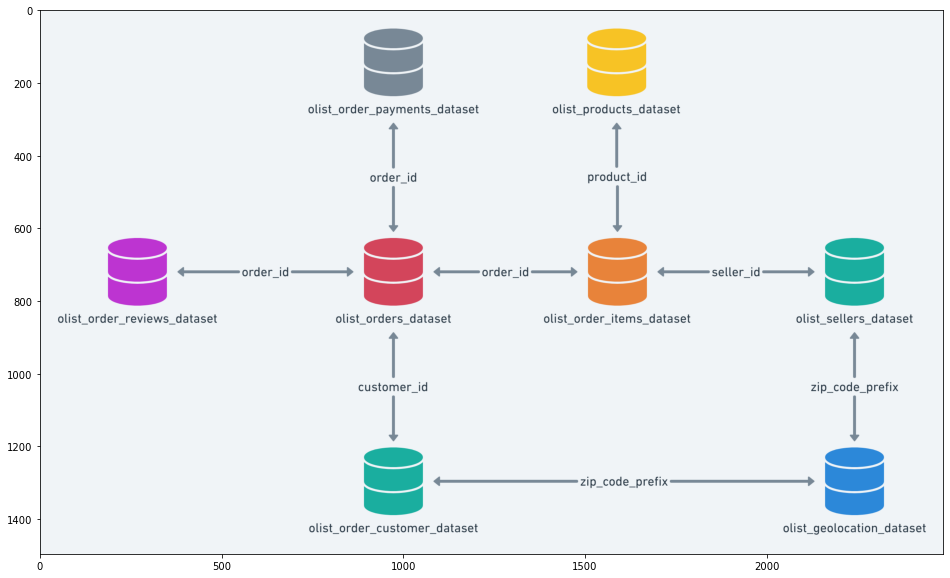

In [1]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
img = mpimg.imread('Data Schema.png')
plt.imshow(img)
plt.show()
# This schema is important to be able to see the connections between the data and connect the data together.

### <span style='color:gray '>AIM  </span>

* The objective of this notebook is to propose an analytical view of e-commerce relationship in Brazil.
* For this I will first go trough an exploratory data analysis using graphical tools to create self explanatory plots for better understanding what is behind braziian online purchasing.
* By making analyzes on time series, I looked at which periods there was an increase in orders.
* I tried to make sense out of the data and find patterns that were not visible at first glance.
* I tried to get business insight.

In [2]:
# Importing Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import calendar
import datetime
from datetime import timedelta
from pandas.api.types import CategoricalDtype
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 100)
import scipy
from scipy import stats 

import warnings
warnings.filterwarnings('ignore')

In [3]:
!pip install autoviz  # to look auto visualizations

ERROR: Invalid requirement: '#'


* There is more than one data here, and each of these data contains different information about e-commerce sales
* There are 9 datasets in total, I combined 8 of them and examined the columns I deem necessary. I used the 9th data alone.
* At the very beginning of the notebook, you can read the explanations one by one and see what the columns mean.

## <span style='color:gray '>Getting the Datasets </span>

In [4]:
# Firstly getting all data -- 9 datasets
customers = pd.read_csv('olist_customers_dataset.csv')
geolocation = pd.read_csv('olist_geolocation_dataset.csv')
order_items = pd.read_csv('olist_order_items_dataset.csv')
order_payments = pd.read_csv('olist_order_payments_dataset.csv')
order_reviews = pd.read_csv('olist_order_reviews_dataset.csv') 
orders = pd.read_csv('olist_orders_dataset.csv')
products = pd.read_csv('olist_products_dataset.csv')
sellers = pd.read_csv('olist_sellers_dataset.csv') 
product_category = pd.read_csv('product_category_name_translation.csv')

## <span style='color:gray '>Overview of the Data</span>

* Before we build a dataset that contains all the useful information, let's look at the shape of each dataset so that we can be more confident about how to use the join expressions and see the variables in the data as a whole.

In [5]:
# datasets from one row above, I choosed titles of the data same
datasets = [customers, geolocation, orders, order_items, order_payments, order_reviews, products, sellers, product_category]
titles = ["customers", "geolocation","orders","order_items", "order_payments", "order_reviews", "products","sellers", "product_category"]
plt.figure(figsize=(15,12))

info_data = pd.DataFrame({},)
info_data['datasets']= titles
info_data['columns'] = [', '.join([col for col, null in df.isnull().sum().items() ]) for df in datasets]
info_data['cols_no']= [df.shape[1] for df in datasets]
info_data['null_no']= [df.isnull().sum().sum() for df in datasets]
info_data['null_cols_no']= [len([col for col, null in df.isnull().sum().items() if null > 0]) for df in datasets]
info_data['null_columns'] = [', '.join([col for col, null in df.isnull().sum().items() if null > 0]) for df in datasets]


info_data.style.background_gradient(cmap='cividis')
# Below image show all datasets, column numbers, columns, null numbers, null columns number  and null columns
#To gather practical information about all datasets 

,datasets,columns,cols_no,null_no,null_cols_no,null_columns
0,customers,"customer_id, customer_unique_id, customer_zip_code_prefix, customer_city, customer_state",5,0,0,
1,geolocation,"geolocation_zip_code_prefix, geolocation_lat, geolocation_lng, geolocation_city, geolocation_state",5,0,0,
2,orders,"order_id, customer_id, order_status, order_purchase_timestamp, order_approved_at, order_delivered_carrier_date, order_delivered_customer_date, order_estimated_delivery_date",8,4908,3,"order_approved_at, order_delivered_carrier_date, order_delivered_customer_date"
3,order_items,"order_id, order_item_id, product_id, seller_id, shipping_limit_date, price, freight_value",7,0,0,
4,order_payments,"order_id, payment_sequential, payment_type, payment_installments, payment_value",5,0,0,
5,order_reviews,"review_id, order_id, review_score, review_comment_title, review_comment_message, review_creation_date, review_answer_timestamp",7,145903,2,"review_comment_title, review_comment_message"
6,products,"product_id, product_category_name, product_name_lenght, product_description_lenght, product_photos_qty, product_weight_g, product_length_cm, product_height_cm, product_width_cm",9,2448,8,"product_category_name, product_name_lenght, product_description_lenght, product_photos_qty, product_weight_g, product_length_cm, product_height_cm, product_width_cm"
7,sellers,"seller_id, seller_zip_code_prefix, seller_city, seller_state",4,0,0,
8,product_category,"product_category_name, product_category_name_english",2,0,0,


<Figure size 1080x864 with 0 Axes>

In [6]:
# renamed the columns to join two data but I will use geolocation separetly
sellers = sellers.rename(columns={'seller_zip_code_prefix': 'zip_code_prefix'})
geolocation = geolocation.rename(columns={'geolocation_zip_code_prefix': 'zip_code_prefix'})

In [7]:
# There were 9 datasets in brazil e-commerce data, I combined 8 of them and kept as data, examined geolocation separately.
data = pd.merge(orders,order_payments, on="order_id")
data = data.merge(customers, on="customer_id")
data = data.merge(order_items, on="order_id")
data = data.merge(sellers, on='seller_id')
# data = data.merge(geolocation, on='zip_code_prefix') # I didn't use this data on merge, I will use it separately
data = data.merge(products, on="product_id")
data = data.merge(product_category, on="product_category_name")
data = data.merge(order_reviews , on='order_id') 

In [8]:
data.shape # at first shape of the data

(115609, 40)

In [9]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
payment_sequential,115609.0,1.093747,0.729849,1.00,1.00,1.00,1.00,29.00
payment_installments,115609.0,2.946233,2.781087,0.00,1.00,2.00,4.00,24.00
payment_value,115609.0,172.387379,265.873969,0.00,60.87,108.05,189.48,13664.08
customer_zip_code_prefix,115609.0,35061.537597,29841.671732,1003.00,11310.00,24241.00,58745.00,99980.00
order_item_id,115609.0,1.194535,0.685926,1.00,1.00,1.00,1.00,21.00
price,115609.0,120.619850,182.653476,0.85,39.90,74.90,134.90,6735.00
freight_value,115609.0,20.056880,15.836184,0.00,13.08,16.32,21.21,409.68
zip_code_prefix,115609.0,24515.713958,27636.640968,1001.00,6429.00,13660.00,28605.00,99730.00
product_name_lenght,115609.0,48.766541,10.034187,5.00,42.00,52.00,57.00,76.00
product_description_lenght,115609.0,785.808198,652.418619,4.00,346.00,600.00,983.00,3992.00


* Freight value: range of the freight value is high, and mean value is gretaer than median value.Right skewed.
* Price: range of the price value is so high, and distribution of the price also righr skewed.


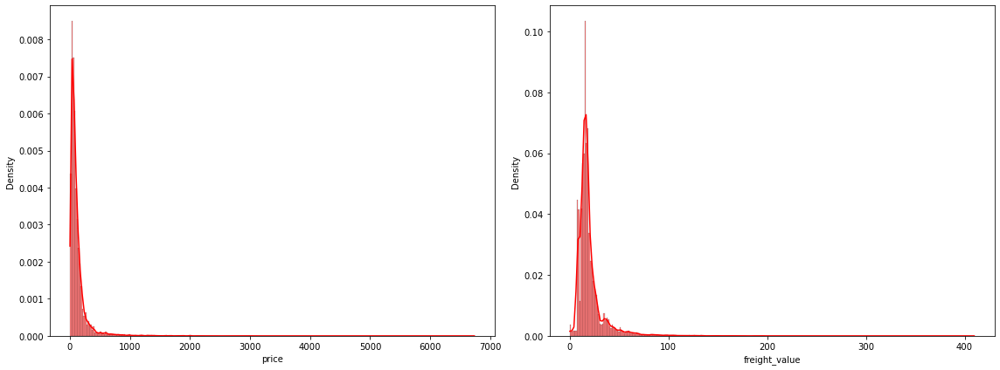

In [10]:
# select the columns to be plotted
cols = ['price', 'freight_value']

# create the figure and axes

fig, axes = plt.subplots(1, 2,figsize=(16,6))
axes = axes.ravel()  # flattening the array makes indexing easier

for col, ax in zip(cols, axes):
    sns.histplot(data=data[col], kde=True, stat='density', ax=ax, bins=300, color='red')

fig.tight_layout()
plt.show()

In [11]:
# these are the all datasets, I didn't use all columns above, just select some of them and analyzed it.
# above you can see null values

In [12]:
data.info() # to see dtypes and null values 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115609 entries, 0 to 115608
Data columns (total 40 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   order_id                       115609 non-null  object 
 1   customer_id                    115609 non-null  object 
 2   order_status                   115609 non-null  object 
 3   order_purchase_timestamp       115609 non-null  object 
 4   order_approved_at              115595 non-null  object 
 5   order_delivered_carrier_date   114414 non-null  object 
 6   order_delivered_customer_date  113209 non-null  object 
 7   order_estimated_delivery_date  115609 non-null  object 
 8   payment_sequential             115609 non-null  int64  
 9   payment_type                   115609 non-null  object 
 10  payment_installments           115609 non-null  int64  
 11  payment_value                  115609 non-null  float64
 12  customer_unique_id            

### <span style='color:gray '>Missing Value Analysis  </span> 

In [13]:
data = data.drop_duplicates()

* I will not use product_width_cm, product_height_cm, product_length_cm, product_weight_g columns with whole data.
* These columns have 1 null values in it, It's actually clean data, but I dropped it because there weren't any columns I was interested in.
* The product categories in the data were in both Portuguese and English, I dropped the Portuguese ones as well.
* In addition, there was a yield where I combined the product names in the data in order to get them in English.
* There were a few more columns, such as the product name length, in that data, so I dropped them because I didn't care about them.

In [14]:
# In the data review comment title and review comment message contains a lot of null value, I will not use these columns.
# But I kept them in order to use nlp maybe later.
reviews = data[['review_comment_title','review_comment_message','review_score','review_id']]

In [15]:
# Firstly, I dropped the columns that I don't want to use it
data.drop(['product_category_name'], axis = 1, inplace = True) # dropped it because its english available in tha data, it was portuguese
# I joined product to get product_id and to join product_category with data, I will not use below attributes, I dropped it.
data.drop(['product_name_lenght', 'product_photos_qty', 'product_length_cm'], axis=1, inplace=True)
data.drop(['product_weight_g','product_width_cm','product_description_lenght','product_height_cm'], axis = 1, inplace = True)


In [16]:
# In the datasets description section, it was stated that the review title and review_comment_message values are in Portuguese.
# I dropped these two columns because their null value rate are too high %88 and %57 and they are in portuguese.
data.drop(['review_comment_title','review_comment_message'], axis = 1, inplace = True)

In [17]:
# in the below codes I used these but since I didn' find any insight from these I dropped them,
# And I will comment these codes below to see them
data.drop(['review_answer_timestamp','review_creation_date'], axis = 1, inplace = True)

In [18]:
#data.dropna(inplace=True)

In [19]:
#let's change the column name product_category_name_english' to product_category.
data.rename(columns={'product_category_name_english': 'product_category'},inplace=True)

In [20]:
data.shape # to see its first shape before dropping any columns

(115609, 28)

In [21]:
# let's begin with null values # Now we see that three columns have null values.
data.isnull().sum().sort_values(ascending=False)

order_delivered_customer_date    2400
order_delivered_carrier_date     1195
order_approved_at                  14
order_id                            0
order_item_id                       0
review_id                           0
product_category                    0
seller_state                        0
seller_city                         0
zip_code_prefix                     0
freight_value                       0
price                               0
shipping_limit_date                 0
seller_id                           0
product_id                          0
customer_city                       0
customer_state                      0
customer_id                         0
customer_zip_code_prefix            0
customer_unique_id                  0
payment_value                       0
payment_installments                0
payment_type                        0
payment_sequential                  0
order_estimated_delivery_date       0
order_purchase_timestamp            0
order_status

In [22]:
def missing_value_rate(data):
    print (round((data.isnull().sum() * 100/ len(data)),3)) # I rounded to 3.

missing_value_rate(data)

order_id                         0.000
customer_id                      0.000
order_status                     0.000
order_purchase_timestamp         0.000
order_approved_at                0.012
order_delivered_carrier_date     1.034
order_delivered_customer_date    2.076
order_estimated_delivery_date    0.000
payment_sequential               0.000
payment_type                     0.000
payment_installments             0.000
payment_value                    0.000
customer_unique_id               0.000
customer_zip_code_prefix         0.000
customer_city                    0.000
customer_state                   0.000
order_item_id                    0.000
product_id                       0.000
seller_id                        0.000
shipping_limit_date              0.000
price                            0.000
freight_value                    0.000
zip_code_prefix                  0.000
seller_city                      0.000
seller_state                     0.000
product_category         

In [23]:
data.sample(5) # to look randomly to data

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,zip_code_prefix,seller_city,seller_state,product_category,review_id,review_score
16439,7644d739e2f3576f4badf052556d99a2,045ffb1f379e2a5ed4845dea2f2519cf,delivered,2017-12-02 21:32:28,2017-12-05 04:13:57,2017-12-05 16:51:22,2017-12-12 18:12:39,2018-01-05 00:00:00,1,boleto,1,97.78,26de6a0aafed8ec5dbd16371667f6883,28200,sao joao da barra,RJ,1,e71ce72b19b83080d97cf4f06c90d096,376a891762bbdecbc02b4b6adec3fdda,2017-12-11 04:13:57,72.00,25.78,74323,goiania,GO,sports_leisure,d405fc476590ffd955dccfd2d7f3f8ae,5
13777,354894de6c4b417d6144c2f4a054416f,512bac2ddc9c18547a0c173e522d1705,delivered,2018-03-21 22:44:19,2018-03-23 02:15:43,2018-03-24 00:06:24,2018-03-27 02:16:30,2018-04-17 00:00:00,1,boleto,1,214.11,498735d4351f24cffac0107bc64e9b40,99050,passo fundo,RS,1,418d480693f2f01e9cf4568db0346d28,12b9676b00f60f3b700e83af21824c0e,2018-04-05 02:15:43,199.00,15.11,95780,montenegro,RS,cool_stuff,e616b348778e650de7a779047c1be655,5
72309,285c2e15bebd4ac83635ccc563dc71f4,b246eeed30b362c09d867b9e598bee51,delivered,2017-12-08 12:00:04,2017-12-09 11:55:17,2017-12-11 18:42:21,2017-12-21 16:33:10,2018-01-03 00:00:00,13,voucher,1,4.07,2524dcec233c3766f2c2b22f69fd65f4,17604,tupa,SP,1,bdc3291ab242ec1effc8eb0987850268,dbd66278cbfe1aa1000f90a217ca4695,2017-12-14 11:55:17,29.00,11.85,5588,sao paulo,SP,electronics,7e568736c98c553aea896a5dca746d5a,5
56041,ed95597d2fd96ad370b62bbfc4b6127b,e19a899f07d511c22b9f865432a6316b,delivered,2017-03-21 15:16:17,2017-03-21 15:16:17,2017-03-23 10:04:29,2017-03-31 11:13:30,2017-04-13 00:00:00,1,credit_card,2,48.04,5df1ac0435f455a487ee63a856552e1b,9090,santo andre,SP,1,3c5ff6cfedc787b5fcef300fc43100c0,6338ea67c41078a46ad99cc009654956,2017-03-27 15:16:17,31.99,16.05,95170,farroupilha,RS,auto,2abae297007201a950ba2e2bc6a6aa2d,5
38551,3990f96693d321ac142fff312bf3706a,6c44a903274653cddb1df3bcb05ac71f,delivered,2018-07-08 16:13:13,2018-07-08 16:25:33,2018-07-09 12:02:00,2018-07-11 11:28:38,2018-08-15 00:00:00,1,credit_card,1,100.95,be160ff1d833563ea876b3662de0a653,80620,curitiba,PR,6,0f6e214a2c5baab8c1ccb053a0829f13,4e06067cc08b3f41d837768d392c3ee3,2018-07-11 16:25:33,19.99,3.33,32604,betim,MG,perfumery,56df058093ebc328159047843a53f03e,5


* Although the null rates of the remaining data are very low rate , I will fill order_approved_at and order_delivered_carrier_date 

In [24]:
# Let' s first look at the order_approved_at columns, here as you can see the order has been confirmed, the parts are nat, but all the orders have been delivered.
#I will fill in the null values here by looking at the average value of the time between order and confirmation.
data[data['order_approved_at'].isnull()]

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,zip_code_prefix,seller_city,seller_state,product_category,review_id,review_score
11895,5cf925b116421afa85ee25e99b4c34fb,29c35fc91fc13fb5073c8f30505d860d,delivered,2017-02-18 16:48:35,NaN,2017-02-22 11:23:10,2017-03-09 07:28:47,2017-03-31 00:00:00,1,boleto,1,106.81,7e1a5ca61b572d76b64b6688b9f96473,62700,caninde,CE,1,c6dd917a0be2a704582055949915ab32,7a67c85e85bb2ce8582c35f2203ad736,2017-02-22 15:48:35,79.99,26.82,3426,sao paulo,SP,cool_stuff,4930703ae4fccd4d2d3b44cf63a9e632,5
11897,12a95a3c06dbaec84bcfb0e2da5d228a,1e101e0daffaddce8159d25a8e53f2b2,delivered,2017-02-17 13:05:55,NaN,2017-02-22 11:23:11,2017-03-02 11:09:19,2017-03-20 00:00:00,1,boleto,1,95.76,c8822fce1d0bfa7ddf0da24fff947172,27945,macae,RJ,1,c6dd917a0be2a704582055949915ab32,7a67c85e85bb2ce8582c35f2203ad736,2017-02-21 12:05:55,79.99,15.77,3426,sao paulo,SP,cool_stuff,4e44dd381f3c4f7afddacf8b9aa0c47a,5
11974,2babbb4b15e6d2dfe95e2de765c97bce,74bebaf46603f9340e3b50c6b086f992,delivered,2017-02-18 17:15:03,NaN,2017-02-22 11:23:11,2017-03-03 18:43:43,2017-03-31 00:00:00,1,boleto,1,106.81,f79be7c08dd24b72d34634f1b89333a4,65110,sao jose de ribamar,MA,1,c6dd917a0be2a704582055949915ab32,7a67c85e85bb2ce8582c35f2203ad736,2017-02-22 16:15:03,79.99,26.82,3426,sao paulo,SP,cool_stuff,da0dc17903d0f8aa4b041dcd7f2dacff,4
15781,c1d4211b3dae76144deccd6c74144a88,684cb238dc5b5d6366244e0e0776b450,delivered,2017-01-19 12:48:08,NaN,2017-01-25 14:56:50,2017-01-30 18:16:01,2017-03-01 00:00:00,1,boleto,1,54.51,6ff8b0d7b35d5c945633b8d60165691b,11030,santos,SP,1,5ab02ca028398131a5ae91401eb49788,80e6699fe29150b372a0c8a1ebf7dcc8,2017-01-23 12:48:08,39.99,14.52,83323,pinhais,PR,sports_leisure,a8353da830468c234d99152e0b714fed,4
22467,d77031d6a3c8a52f019764e68f211c69,0bf35cac6cc7327065da879e2d90fae8,delivered,2017-02-18 11:04:19,NaN,2017-02-23 07:23:36,2017-03-02 16:15:23,2017-03-22 00:00:00,1,boleto,1,39.95,c4c0011e639bdbcf26059ddc38bd3c18,13225,varzea paulista,SP,1,02a79d79e818ad0be36cfc843a6af7ad,cb3dd9ce66268c7a3ca7241ac70ab58c,2017-02-25 10:04:19,28.99,10.96,3028,sao paulo,SP,sports_leisure,ce1c8f5c23a5b96c8d27878e666ad3f2,5
31906,51eb2eebd5d76a24625b31c33dd41449,07a2a7e0f63fd8cb757ed77d4245623c,delivered,2017-02-18 15:52:27,NaN,2017-02-23 03:09:14,2017-03-07 13:57:47,2017-03-29 00:00:00,1,boleto,1,77.06,79af1bbf230a2630487975aa5d7d6220,37660,paraisopolis,MG,1,7868a64aa111bbb4f41f8e1146c0becb,cca3071e3e9bb7d12640c9fbe2301306,2017-02-28 14:52:27,59.90,17.16,14940,ibitinga,SP,furniture_decor,6352329f467fe888f25b35e48b11b97e,5
32111,7002a78c79c519ac54022d4f8a65e6e8,d5de688c321096d15508faae67a27051,delivered,2017-01-19 22:26:59,NaN,2017-01-27 11:08:05,2017-02-06 14:22:19,2017-03-16 00:00:00,1,boleto,1,60.42,d49f3dae6bad25d05160fc17aca5942d,36400,conselheiro lafaiete,MG,1,c3b271f47e73d0c9ccf1b43b7606c705,cca3071e3e9bb7d12640c9fbe2301306,2017-01-29 22:26:59,45.90,14.52,14940,ibitinga,SP,furniture_decor,24f83e3e2c75b58888eec93ab93f2cca,2
32191,d69e5d356402adc8cf17e08b5033acfb,68d081753ad4fe22fc4d410a9eb1ca01,delivered,2017-02-19 01:28:47,NaN,2017-02-23 03:11:48,2017-03-02 03:41:58,2017-03-27 00:00:00,1,boleto,1,163.43,2e0a2166aa23da2472c6a60c4af6f7a6,3573,sao paulo,SP,1,cae2e38942c8489d9d7a87a3f525c06b,cca3071e3e9bb7d12640c9fbe2301306,2017-02-26 01:28:47,149.80,13.63,14940,ibitinga,SP,furniture_decor,6540ad5bc5a8bfc9ede2d495bfb940dd,5
78176,88083e8f64d95b932164187484d90212,f67cd1a215aae2a1074638bbd35a223a,delivered,2017-02-18 22:49:19,NaN,2017-02-22 11:31:06,2017-03-02 12:06:06,2017-03-21 00:00:00,1,boleto,1,127.04,bc1896dc77f49e6dec880445a9b443a3,21020,rio de janeiro,RJ,1,8c5876b1c7768217964f353bc7e64393,0db783cfcd3b73998abc6e1

### <span style='color:gray '>Converting date values from object type to date  </span> 

* Before filling na values, I changed object type to date type
* I will use datetime for time series analysis

In [25]:
data[['order_purchase_timestamp','order_approved_at','order_delivered_carrier_date','order_delivered_customer_date','order_estimated_delivery_date']]= data[['order_purchase_timestamp','order_approved_at','order_delivered_carrier_date','order_delivered_customer_date','order_estimated_delivery_date']].apply(pd.to_datetime)

In [26]:
data[['shipping_limit_date']]=data[['shipping_limit_date']].apply(pd.to_datetime)
# data[['review_creation_date','review_answer_timestamp']]=data[[review_creation_date','review_answer_timestamp']].apply(pd.to_datetime)

### <span style='color:gray '> New Date columns using order purchase timestamp  </span> 

In [27]:
# I created Year, Month and Day data based on the order date of the customers.
data['purchased_Year'] = data['order_purchase_timestamp'].dt.year
data['purchased_Month'] = pd.Series(pd.Categorical(data['order_purchase_timestamp'].dt.month_name(), categories=list(calendar.month_name)))
data['purchased_Day'] = pd.Series(pd.Categorical(data['order_purchase_timestamp'].dt.day_name(), categories=list(calendar.day_name)))

In [28]:
data['Day'] = data['order_purchase_timestamp'].dt.day # to use day I created day column

In [29]:
# I created seasons to look order sales in different seasons
data['Season']=(data['order_purchase_timestamp'].dt.month%12+3)//3
Seasons={1: 'Summer', 2: 'Autumn', 3:'Winter', 4: 'Spring'}
data['SeasonName']= data['Season'].map(Seasons)

### <span style='color:gray '>Null Values  </span> 

In [30]:
# In the vast majority of data, orders are confirmed within 1 day.
(data['order_approved_at']- data['order_purchase_timestamp']).describe()

count                       115595
mean     0 days 10:30:11.553440892
std      0 days 22:15:50.693403196
min                0 days 00:00:00
25%                0 days 00:12:57
50%                0 days 00:20:51
75%                0 days 14:58:51
max               60 days 10:51:59
dtype: object

In [31]:
# since mean of the time that approved after purchase was hours, I will fill with null values with the time after 1 day
# from the purchase time

In [32]:
# I created new_approved time to fill nat values in order approved at column, 1 hours after the order purchase timestamp
new_approved_at= data[data['order_approved_at'].isnull()]['order_purchase_timestamp'] + timedelta(hours=1)
new_approved_at

11895    2017-02-18 17:48:35
11897    2017-02-17 14:05:55
11974    2017-02-18 18:15:03
15781    2017-01-19 13:48:08
22467    2017-02-18 12:04:19
31906    2017-02-18 16:52:27
32111    2017-01-19 23:26:59
32191    2017-02-19 02:28:47
78176    2017-02-18 23:49:19
78177    2017-02-18 23:49:19
90358    2017-02-17 18:21:55
104209   2017-02-17 16:53:27
110962   2017-02-18 15:40:00
113892   2017-02-18 13:45:31
Name: order_purchase_timestamp, dtype: datetime64[ns]

In [33]:
data['order_approved_at'] = data['order_approved_at'].fillna(value=new_approved_at)

In [34]:
data[data['order_approved_at'].isnull()]

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,zip_code_prefix,seller_city,seller_state,product_category,review_id,review_score,purchased_Year,purchased_Month,purchased_Day,Day,Season,SeasonName


In [35]:
# Now I will deal with the null values of delivered_carrier date and delivered_customer_date
len(data[data['order_delivered_customer_date'].isnull()])
# data[data['order_delivered_customer_date'].isnull()]

2400

In [36]:
# to looking order status I realized that when the status shipped, invoiced or processing their delivered_customer_date null
data.order_status.unique()

array(['delivered', 'shipped', 'canceled', 'invoiced', 'processing',
       'approved', 'unavailable'], dtype=object)

##### Shipped Orders

* Status : Shipped
* Since status is shippped carrier date is available for each shipped ones, but customer delivered times are null because they aren't reached the customers.

In [37]:
len(data[data['order_status']=='shipped']) 
# Since it appears in cargo, the date of reaching the customer is null in all shipped values

1138

In [38]:
len(data[(data['order_status']=='shipped') & (data['order_delivered_carrier_date'].isnull())])

0

In [39]:
len(data[(data['order_status']=='shipped') & (data['order_delivered_customer_date'].isnull())])

1138

##### Invoiced Orders

In [40]:
len(data[data['order_status']=='invoiced'])

358

In [41]:
len(data[(data['order_status']=='invoiced') & (data['order_delivered_carrier_date'].isnull())])

358

In [42]:
len(data[(data['order_status']=='invoiced') & (data['order_delivered_customer_date'].isnull())])

358

##### Processing Orders

In [43]:
len(data[data['order_status']=='processing']) 

357

In [44]:
len(data[(data['order_status']=='processing') & (data['order_delivered_carrier_date'].isnull())])

357

In [45]:
len(data[(data['order_status']=='processing') & (data['order_delivered_carrier_date'].isnull()) & (data['order_delivered_customer_date'].isnull())])

357

In [46]:
data[(data['order_status']=='processing') & (data['order_delivered_carrier_date'].isnull()) & (data['order_delivered_customer_date'].isnull())]

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,zip_code_prefix,seller_city,seller_state,product_category,review_id,review_score,purchased_Year,purchased_Month,purchased_Day,Day,Season,SeasonName
2265,bc50c4b649fb077defd8c5b6f1337468,31edfd4653cfea85babbf961ec4ca923,processing,2017-10-10 11:49:24,2017-10-11 03:49:26,NaT,NaT,2017-10-27,1,boleto,1,79.00,f994fa16f4061b976b0c2ff8af3e54e2,18530,tiete,SP,1,9bd15113e791933a5d0c59c00d9add5c,98dac6635aee4995d501a3972e047414,2017-10-18 04:49:26,7.90,11.85,2030,sao paulo,SP,housewares,333fee294ec15a167c13554fb1dee8eb,3,2017,October,Tuesday,10,4,Spring
2266,bc50c4b649fb077defd8c5b6f1337468,31edfd4653cfea85babbf961ec4ca923,processing,2017-10-10 11:49:24,2017-10-11 03:49:26,NaT,NaT,2017-10-27,1,boleto,1,79.00,f994fa16f4061b976b0c2ff8af3e54e2,18530,tiete,SP,2,9bd15113e791933a5d0c59c00d9add5c,98dac6635aee4995d501a3972e047414,2017-10-18 04:49:26,7.90,11.85,2030,sao paulo,SP,housewares,333fee294ec15a167c13554fb1dee8eb,3,2017,October,Tuesday,10,4,Spring
2267,bc50c4b649fb077defd8c5b6f1337468,31edfd4653cfea85babbf961ec4ca923,processing,2017-10-10 11:49:24,2017-10-11 03:49:26,NaT,NaT,2017-10-27,1,boleto,1,79.00,f994fa16f4061b976b0c2ff8af3e54e2,18530,tiete,SP,3,9bd15113e791933a5d0c59c00d9add5c,98dac6635aee4995d501a3972e047414,2017-10-18 04:49:26,7.90,11.85,2030,sao paulo,SP,housewares,333fee294ec15a167c13554fb1dee8eb,3,2017,October,Tuesday,10,4,Spring
2268,bc50c4b649fb077defd8c5b6f1337468,31edfd4653cfea85babbf961ec4ca923,processing,2017-10-10 11:49:24,2017-10-11 03:49:26,NaT,NaT,2017-10-27,1,boleto,1,79.00,f994fa16f4061b976b0c2ff8af3e54e2,18530,tiete,SP,4,9bd15113e791933a5d0c59c00d9add5c,98dac6635aee4995d501a3972e047414,2017-10-18 04:49:26,7.90,11.85,2030,sao paulo,SP,housewares,333fee294ec15a167c13554fb1dee8eb,3,2017,October,Tuesday,10,4,Spring
3201,be580c71d638ce682e9792c27c7aacb2,d163cf4e7699b15dd8bdd1e3c5860a89,processing,2017-03-14 20:12:18,2017-03-14 20:12:18,NaT,NaT,2017-04-10,1,credit_card,1,46.39,77f283b88084654cd6ff9867786c36cb,5709,sao paulo,SP,1,c5897f6f2d995196dbb40542439da9b9,ffff564a4f9085cd26170f4732393726,2017-03-28 20:12:18,34.65,11.74,13070,campinas,SP,housewares,d006d3cb38461e4586ca0dfc68d7d802,1,2017,March,Tuesday,14,2,Autumn
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114142,97cd2653d53d5404413e2241289d5418,f8b83b95c4f8cb66651c2b114ac7d296,processing,2017-11-06 15:29:29,2017-11-06 21:36:02,NaT,NaT,2017-11-27,1,credit_card,3,30.09,8610d4722d4bcdaf55f53cbeb8cf3c14,38070,uberaba,MG,1,2d771944d4a7dc7d95d974cfe4be96ff,9f56a7a649097b166d8ed286ad86a15c,2017-11-10 15:48:10,14.99,15.10,21041,rio de janeiro,RJ,christmas_supplies,2bca6dbd41afdcb8f372917ea3778268,1,2017,November,Monday,6,4,Spring
114624,3be3bae6f665380f803dc59c9053cf26,03eaeeab9883ef63043d7f0e0325a370,processing,2017-08-06 14:18:45,2017-08-08 04:10:13,NaT,NaT,2017-08-31,1,boleto,1,66.69,93d9e516a351a7747fc9830ae9525062,89700,concordia,SC,1,2b18330ce86ae5c606250b75b499f370,7fe21dd00d2f4943ae09525efa2fd674,2017-08-14 04:10:13,49.90,16.79,20551,rio de janeiro,RJ,fashion_childrens_clothes,84dd398af6cf56be0bd7eba2f4df3050,1,2017,August,Sunday,6,3,Winter
114716,d3c8851a6651eeff2f73b0e011ac45d0,957f8e082185574de25992dc659ebbc0,processing,2016-10-05 22:44:13,2016-10-06 15:51:05,NaT,NaT,2016-12-09,1,credit_card,1,299.84,07d5b1f9bdd053347f0213187b343ac9,3531,sao paulo,SP,1,ca17b18b38db6e0d2c33d362322f2a06,4be2e7f96b4fd749d52dff41f80e39dd,2016-10-21 16:24:45,267.00,32.84,69900,rio branco,AC,books_technical,160850927a5f16f903dc83a05e0a5826,1,2016,October,Wednesday,5,4,Spring
115414,643072b191b07f013f4d88ec43acb81

In [47]:
len(data[(data['order_status']=='approved') & (data['order_delivered_carrier_date'].isnull())])

3

##### Canceled Orders

In [48]:
# First of all canceled items' delivered_carrier data and delivered_customer_date is null.
# There are multiple scenarios here,A customer can cancel the product after purchasing it,
# cancel it after it has been shipped, or cancel it after it reaches the customer's hand.

canceled = data[data['order_status']=='canceled'] #I gathered the canceled items together
canceled # there were 536 items in the canceled status

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,zip_code_prefix,seller_city,seller_state,product_category,review_id,review_score,purchased_Year,purchased_Month,purchased_Day,Day,Season,SeasonName
507,5f0dfd096a455e93ffb4ee0635b32264,b03efbab821a8ef7b3e6b2a75ec7d74d,canceled,2018-07-29 15:15:39,2018-07-29 15:25:09,NaT,NaT,2018-08-02,1,credit_card,1,34.35,5946c7eb7093ad678e3510213f1b6f09,2250,sao paulo,SP,1,d315b738a6e96f4d9710af966cb7cd5b,f8db351d8c4c4c22c6835c19a46f01b0,2018-07-31 15:25:09,26.90,7.45,13324,salto,SP,housewares,95c7c13cf2056bf0cca12834803a80a6,4,2018,July,Sunday,29,3,Winter
921,013e9c654a339d80b53513da3c1ea437,9391729f79cd9e5fd7ca884ca030f579,canceled,2017-06-18 13:48:48,2017-06-18 13:55:18,NaT,NaT,2017-07-07,1,credit_card,1,123.01,05a3b50193563913613acada5c86b1d2,18710,arandu,SP,1,bcac2cdcd851929a5caa3e1508d5abc9,0adac9fbd9a2b63cccaac4f8756c1ca8,2017-06-22 13:55:18,109.90,13.11,13290,louveira,SP,housewares,ca13795db8e305829cb406ef608d87f9,1,2017,June,Sunday,18,3,Winter
1013,0148d3df00cebda592d4e5f966e300cc,672510553bcfbf72de694db2cd88f046,canceled,2017-08-19 19:08:26,2017-08-19 19:24:32,NaT,NaT,2017-09-11,1,credit_card,1,86.90,e75fd09539dff5c7c80a12781404ffea,4078,sao paulo,SP,1,ed08ea04c92f5f434c2362f7310fb328,0adac9fbd9a2b63cccaac4f8756c1ca8,2017-08-24 19:24:32,5.53,11.85,13290,louveira,SP,housewares,8d697839be8221452e9d4f96347d0612,1,2017,August,Saturday,19,3,Winter
1014,0148d3df00cebda592d4e5f966e300cc,672510553bcfbf72de694db2cd88f046,canceled,2017-08-19 19:08:26,2017-08-19 19:24:32,NaT,NaT,2017-09-11,1,credit_card,1,86.90,e75fd09539dff5c7c80a12781404ffea,4078,sao paulo,SP,2,ed08ea04c92f5f434c2362f7310fb328,0adac9fbd9a2b63cccaac4f8756c1ca8,2017-08-24 19:24:32,5.53,11.85,13290,louveira,SP,housewares,8d697839be8221452e9d4f96347d0612,1,2017,August,Saturday,19,3,Winter
1015,0148d3df00cebda592d4e5f966e300cc,672510553bcfbf72de694db2cd88f046,canceled,2017-08-19 19:08:26,2017-08-19 19:24:32,NaT,NaT,2017-09-11,1,credit_card,1,86.90,e75fd09539dff5c7c80a12781404ffea,4078,sao paulo,SP,3,ed08ea04c92f5f434c2362f7310fb328,0adac9fbd9a2b63cccaac4f8756c1ca8,2017-08-24 19:24:32,5.53,11.85,13290,louveira,SP,housewares,8d697839be8221452e9d4f96347d0612,1,2017,August,Saturday,19,3,Winter
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114453,0a7f4604ee9cab65020038275efe1d76,f1f47119f889031980d7fad6a0b0c62f,canceled,2018-07-08 18:44:18,2018-07-10 04:35:13,NaT,NaT,2018-07-27,1,boleto,1,72.18,e9fcfa1ff75dd047ce6a054c2fa22caa,1252,sao paulo,SP,3,67ff96903c597ba4b1d7f668734bc3a4,66d5ae34537110d3affc56174dad2b2f,2018-07-16 04:35:13,11.27,12.79,15062,sao jose do rio preto,SP,costruction_tools_garden,1b0d360c98484735dc94be4ae54eb24a,1,2018,July,Sunday,8,3,Winter
114911,263f5778d1130e9c186958780172a107,7324ecb0ff143f561193d22bea7d63fb,canceled,2017-10-12 08:39:30,2017-10-12 09:06:26,NaT,NaT,2017-11-06,1,credit_card,1,12.94,c6be127fa6e30c6f705a205236a1f310,13302,itu,SP,1,0350ac874c8937571b129554110ec3b6,75fbb52eda0cbc24f479d3b2fbfa8d3e,2017-10-18 10:06:26,19.90,25.63,74560,goiania,GO,dvds_blu_ray,d427f29a57056dac9243dd8da5c74c72,1,2017,October,Thursday,12,4,Spring
114912,263f5778d1130e9c186958780172a107,7324ecb0ff143f561193d22bea7d63fb,canceled,2017-10-12 08:39:30,2017-10-12 09:06:26,NaT,NaT,2017-11-06,2,voucher,1,32.59,c6be127fa6e30c6f705a205236a1f310,13302,itu,SP,1,0350ac874c8937571b129554110ec3b6,75fbb52eda0cbc24f479d3b2fbfa8d3e,2017-10-18 10:06:26,19.90,25.63,74560,goiania,GO,dvds_blu_ray,d427f29a57056dac9243dd8da5c74c72,1,2017,October,Thursday,12,4,Spring
114955,a9957adf297a6be5e8625b3e93329c6d,7e779aeb9722a44ac85680

In [49]:
len(data[data['order_status']=='canceled']) # There are 536 products whose status appears to be canceled.

536

Text(0.5, 1.0, " canceled order's review scores")

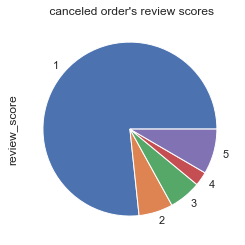

In [149]:
data[data['order_status']=='canceled'].groupby('review_score')['review_score'].count().plot(kind='pie')
plt.title(" canceled order's review scores" )
# 

In [50]:
len(data[(data['order_delivered_customer_date'].isnull()) & (data['order_status']=='canceled')])
# 7 f them delivred customers

529

In [51]:
data[(~data['order_delivered_carrier_date'].isnull()) & ( data['order_delivered_customer_date'].isnull()) & (data['order_status']=='canceled')]

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,zip_code_prefix,seller_city,seller_state,product_category,review_id,review_score,purchased_Year,purchased_Month,purchased_Day,Day,Season,SeasonName
1133,885935156ba43094f3ae95f3c14e0381,3885c59916b2b261205c303fe0a10abf,canceled,2018-02-02 16:06:44,2018-02-06 04:32:39,2018-02-07 20:48:31,NaT,2018-03-08,1,boleto,1,42.78,f72d1ee92d55688d07ca88506300715e,22790,rio de janeiro,RJ,1,32e18e89237933ebdaaebd78a27e7fa1,ca3bd7cd9f149df75950150d010fe4a2,2018-02-20 02:55:37,26.18,16.60,4361,sao paulo,SP,housewares,d200092e5aaa95af48e64316cef897c0,1,2018,February,Friday,2,1,Summer
5155,a2714ecbf6eeb3bb9cd7dba6dc1c5e82,5fe0562353e8f0b6c0c6b55cd0f58fe0,canceled,2018-02-14 18:01:38,2018-02-14 18:20:40,2018-02-15 17:27:27,NaT,2018-03-06,1,credit_card,1,133.77,0eb85c748bb33072cb864a7c8b54aa97,4168,sao paulo,SP,1,ebb12274522d82caa7dca657873b2ad7,fffd5413c0700ac820c7069d66d98c89,2018-02-20 17:20:40,99.80,33.97,13908,amparo,SP,housewares,65dfeb60c40e3cbb0a1838285d86f885,1,2018,February,Wednesday,14,1,Summer
8625,8caf289ab5d7e3ec7b4522aa22dabbec,dca1d784fd6b8dd1f223bb76482fa053,canceled,2018-02-14 10:37:17,2018-02-14 10:50:27,2018-02-17 00:04:14,NaT,2018-03-07,1,credit_card,1,64.09,5dd7c998ea73207f1e1f8b04866c3f83,5044,sao paulo,SP,1,e50d5ff1ca7c56933a6f35de967fd2e1,46dc3b2cc0980fb8ec44634e21d2718e,2018-02-20 09:50:27,49.99,14.10,22240,rio de janeiro,RJ,baby,b33bc203500f1cfab317cdc8bdbd97dc,4,2018,February,Wednesday,14,1,Summer
13422,cc6c9b89f70b32d7fe075718e0fc58e7,418e9412b396846b861a8c5cb59ba65b,canceled,2018-01-27 10:52:04,2018-01-29 10:52:24,2018-01-30 19:52:55,NaT,2018-03-02,1,credit_card,3,236.00,6ab21d4e4c53e3189aa5f0756f477dd1,26545,nilopolis,RJ,1,9da950e8c8c482441f1b93955b21c827,ceaec5548eefc6e23e6607c5435102e7,2018-02-09 10:52:24,215.00,21.00,3821,sao paulo,SP,cool_stuff,0340049ad5abcf4d0f5ee2445ca09ce0,1,2018,January,Saturday,27,1,Summer
15084,8652f7789fe1585b439154b7ae0f4285,0f29ccaad86ee7442d59a69cf4166c6b,canceled,2018-02-20 14:49:42,2018-02-20 15:09:18,2018-02-21 21:23:04,NaT,2018-03-12,1,credit_card,1,46.85,c08d50ebad8af78e09c3bbd5d413d445,15190,nhandeara,SP,1,054515fd15bc1a2029f10de97ffa9120,e9779976487b77c6d4ac45f75ec7afe9,2018-02-26 15:09:18,35.00,11.85,11701,praia grande,SP,sports_leisure,f22e960aa1892ea63e5924cc0b999186,1,2018,February,Tuesday,20,1,Summer
19701,e7dfe42bb50a6acce37e168e44260a51,97421afb531a2c357e152626fdecd126,canceled,2018-02-14 01:59:02,2018-02-14 02:10:22,2018-02-14 20:29:03,NaT,2018-03-09,1,credit_card,1,41.09,90616b7222bda6620dd1bfb66d1c8915,29127,vila velha,ES,1,eed58af018f022f0dbd193a8e81b9321,8d956fec2e4337affcb520f56fd8cbfd,2018-02-20 01:10:22,26.99,14.10,9780,sao bernardo do campo,SP,sports_leisure,c23033ed559c866b353cc0bf95c503d7,1,2018,February,Wednesday,14,1,Summer
19878,3a129877493c8189c59c60eb71d97c29,0913cdce793684e52bbfac69d87e91fd,canceled,2018-01-25 13:34:24,2018-01-25 13:50:20,2018-01-26 21:42:18,NaT,2018-02-23,1,credit_card,1,14.12,11c3d6c93dea6ce86769a4835c171bd9,87013,maringa,PR,1,7e857e35018e4a05b7d124d1628dc1f0,3fd1e727ba94cfe122d165e176ce7967,2018-01-31 13:50:20,35.90,15.10,14802,araraquara,SP,sports_leisure,15c8f3b3ff412d0f8d6b72053335fd0b,1,2018,January,Thursday,25,1,Summer
19879,3a129877493c8189c59c60eb71d97c29,0913cdce793684e52bbfac69d87e91fd,canceled,2018-01-25 13:34:24,2018-01-25 13:50:20,2018-01-26 21:42:18,NaT,2018-02-23,2,voucher,1,36.88,11c3d6c93dea6ce86769a4835c171bd9,87013,maringa,PR,1,7e857e35018e4a05b7d124d1628dc1f0,3fd1e727ba94cfe122d165e176ce7967,2018-01-31 13:50:20,35.90,15.10,14802,araraquara,SP,sports_leisure,15c8f3b3ff412d0f8d6b72053335fd0b,1,2018,January,Thursday,25,1,Summer
21272,e248283e6b8

In [52]:
# Although some products have been canceled, it seems to have reached the customer
data[(data['order_status'] == 'canceled') & (~data['order_delivered_customer_date'].isnull())]

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,zip_code_prefix,seller_city,seller_state,product_category,review_id,review_score,purchased_Year,purchased_Month,purchased_Day,Day,Season,SeasonName
15373,65d1e226dfaeb8cdc42f665422522d14,70fc57eeae292675927697fe03ad3ff5,canceled,2016-10-03 21:01:41,2016-10-04 10:18:57,2016-10-25 12:14:28,2016-11-08 10:58:34,2016-11-25,1,credit_card,1,35.61,b8b8726af116a5cfb35b0315ecef9172,22770,rio de janeiro,RJ,1,9c7bdf67b06b419aefb93cfdfc96c55d,ed49da7cadefc454d6a67de249eab240,2016-10-21 16:24:43,21.50,14.11,5571,sao paulo,SP,sports_leisure,f9fe37d91c506b29a0b4d9107f667bde,1,2016,October,Monday,3,4,Spring
24976,8beb59392e21af5eb9547ae1a9938d06,bf609b5741f71697f65ce3852c5d2623,canceled,2016-10-08 20:17:50,2016-10-09 14:34:30,2016-10-14 22:45:26,2016-10-19 18:47:43,2016-11-30,1,credit_card,5,111.22,f9af3bfab584769f34c314b222d34263,20091,rio de janeiro,RJ,1,c66def7098f4d87751f40c3a4855ced1,46dc3b2cc0980fb8ec44634e21d2718e,2016-10-13 14:34:31,99.99,11.23,22240,rio de janeiro,RJ,toys,b28309e8253951a954123e039d3242f7,1,2016,October,Saturday,8,4,Spring
38664,770d331c84e5b214bd9dc70a10b829d0,6c57e6119369185e575b36712766b0ef,canceled,2016-10-07 14:52:30,2016-10-07 15:07:10,2016-10-11 15:07:11,2016-10-14 15:07:11,2016-11-29,1,credit_card,2,263.93,59a7bb642795ddc85534fbd5f7360334,20091,rio de janeiro,RJ,1,eba7488e1c67729f045ab43fac426f2e,620c87c171fb2a6dd6e8bb4dec959fc6,2016-10-11 15:07:11,249.90,14.03,25645,petropolis,RJ,perfumery,9399c464901dcf9d6a40e6dde8ebdf59,1,2016,October,Friday,7,4,Spring
38680,dabf2b0e35b423f94618bf965fcb7514,5cdec0bb8cbdf53ffc8fdc212cd247c6,canceled,2016-10-09 00:56:52,2016-10-09 13:36:58,2016-10-13 13:36:59,2016-10-16 14:36:59,2016-11-30,1,credit_card,2,140.22,2f96790fba243100730c8d1185dd2f25,5846,sao paulo,SP,1,473795a355d29305c3ea6b156833adf5,620c87c171fb2a6dd6e8bb4dec959fc6,2016-10-13 13:36:59,59.90,0.48,25645,petropolis,RJ,perfumery,28112c56c882286e0b235173e84c5370,5,2016,October,Sunday,9,4,Spring
38681,dabf2b0e35b423f94618bf965fcb7514,5cdec0bb8cbdf53ffc8fdc212cd247c6,canceled,2016-10-09 00:56:52,2016-10-09 13:36:58,2016-10-13 13:36:59,2016-10-16 14:36:59,2016-11-30,1,credit_card,2,140.22,2f96790fba243100730c8d1185dd2f25,5846,sao paulo,SP,2,7cd29da0653abeb444703cc5a957f479,620c87c171fb2a6dd6e8bb4dec959fc6,2016-10-13 13:36:59,49.90,29.94,25645,petropolis,RJ,health_beauty,28112c56c882286e0b235173e84c5370,5,2016,October,Sunday,9,4,Spring
44755,1950d777989f6a877539f53795b4c3c3,1bccb206de9f0f25adc6871a1bcf77b2,canceled,2018-02-19 19:48:52,2018-02-19 20:56:05,2018-02-20 19:57:13,2018-03-21 22:03:51,2018-03-09,1,credit_card,2,44.09,6a04c8339c44b23e189446216a494569,32071,contagem,MG,1,e435ceb7ced9b8446defd858630454ed,2a61c271b1ac763450d846849783e922,2018-02-23 20:56:05,29.99,14.10,9175,santo andre,SP,health_beauty,2c6741d2b72eb45a9ef713560f5eccf7,3,2018,February,Monday,19,1,Summer
85266,2c45c33d2f9cb8ff8b1c86cc28c11c30,de4caa97afa80c8eeac2ff4c8da5b72e,canceled,2016-10-09 15:39:56,2016-10-10 10:40:49,2016-10-14 10:40:50,2016-11-09 14:53:50,2016-12-08,1,credit_card,3,153.51,d93a22bb52bb2f41a7267b8a02370781,88058,florianopolis,SC,1,e24f73b7631ee3fbb2ab700a9acaa258,0cbcee27c791afa0cdcb08587a2013a8,2016-10-14 10:40:50,135.00,18.51,37410,tres coracoes,MG,fashion_bags_accessories,7d02f4eb2feb119b854edcbabe18a44f,1,2016,October,Sunday,9,4,Spring


In [53]:
len(data[(data['order_delivered_carrier_date'].isnull()) & (data['order_status']=='canceled')])
# 68 of them It may have been canceled before shipping.

468

In [54]:
len(data[(~data['order_delivered_carrier_date'].isnull()) & ( data['order_delivered_customer_date'].isnull())&(data['order_status']=='canceled')])

61

In [54]:
# iptal edilen ürünlerin ürün categorilerine bak

In [55]:
# There are 1194 rows of data with blank delivery dates to the customer and cargo.
len(data[(data['order_delivered_carrier_date'].isnull()) & ( data['order_delivered_customer_date'].isnull())])

1194

In [56]:
# Let's look at the orders which are unavaliable
len(data[data['order_status']=='unavailable'])

7

In [57]:
# I will fill these 2 with estimated delivery time
len(data[(data['order_status']=='delivered') & (data['order_delivered_carrier_date'].isnull())])

2

In [58]:
(data['order_delivered_carrier_date']- data['order_purchase_timestamp']).describe()

count                       114414
mean     3 days 06:42:05.097086020
std      3 days 14:51:01.655228105
min            -172 days +18:54:07
25%         1 days 03:17:30.500000
50%         2 days 05:30:40.500000
75%         4 days 02:46:44.500000
max              107 days 01:33:02
dtype: object

In [59]:
# I created new_carrier_at time to fill nat values in order approved at column, 1 hours after the order purchase timestamp
new_carrier_at= data[(data['order_status']=='delivered') & (data['order_delivered_carrier_date'].isnull())]['order_purchase_timestamp'] + timedelta(days=2)
data['order_delivered_carrier_date'] = data['order_delivered_carrier_date'].fillna(value=new_carrier_at)

In [60]:
len(data[(data['order_status']=='delivered') & (data['order_delivered_carrier_date'].isnull())])

0

In [61]:
data[(data['order_delivered_carrier_date'].isnull()) & (data['order_status']=='delivered')]

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,zip_code_prefix,seller_city,seller_state,product_category,review_id,review_score,purchased_Year,purchased_Month,purchased_Day,Day,Season,SeasonName


In [62]:
data['order_delivered_carrier_date'].isnull().sum()

1193

### <span style='color:gray '>I looked at the scores for the canceled products and the dates with null values, I did not do any filling, I commented on my attempts.  </span> 

In [63]:
#data.loc[(data['order_status'] == 'unavailable') & (data['order_delivered_carrier_date'].isnull()), 'order_delivered_carrier_date']=-1
#data.loc[(data['order_status'] == 'unavailable') & (data['order_delivered_customer_date'].isnull()), 'order_delivered_customer_date']=-1

In [64]:
#data.loc[(data['order_delivered_carrier_date'].isnull()) & (data['order_delivered_customer_date'].isnull()) & ((data['review_score']==4) | (data['review_score']==5)), 'order_delivered_carrier_date']=0
#data.loc[(data['order_delivered_carrier_date'].isnull()) & (data['order_delivered_customer_date'].isnull()) & (data['review_score']==), 'order_delivered_customer_date']=0

In [65]:
#mask = data[(data['order_delivered_carrier_date'].isnull()) & ( data['order_delivered_customer_date'].isnull()) & (data['review_score']==1)]
#mask[['order_estimated_delivery_date', 'review_creation_date']]

In [66]:
# (mask['review_creation_date']-mask['order_estimated_delivery_date']).describe()

In [67]:
#data[data['order_delivered_carrier_date'].isnull()]

In [68]:
# I tried to understand why order_delivered_carrier_data and order_delivered_customer_Date is null
# I thought that the products were not delivered because the reviews of those with a review score of 1
# whose shipping dates and delivery dates are empty, were sent 2 days after the estimated delivery date


#data.loc[(data['order_delivered_carrier_date'].isnull()) & (data['order_delivered_customer_date'].isnull()) & (data['review_score']==1), 'order_delivered_carrier_date']=0
#data.loc[(data['order_delivered_carrier_date'].isnull()) & (data['order_delivered_customer_date'].isnull()) & (data['review_score']==1), 'order_delivered_customer_date']=0

In [69]:
#time = data[data['order_delivered_customer_date'].isnull()]['order_purchase_timestamp'] + timedelta(days=12)
#data[(data['order_delivered_customer_date'].isnull()) & (data['order_status']=='delivered')] = data['order_delivered_customer_date'].fillna(value=time)

In [70]:
# Considering the general scores in the data, although 1 score is low, a maximum of 1 score is seen here in null values.
data[data['order_delivered_customer_date'].isnull()].groupby('review_score')['review_score'].count()

review_score
1    1681
2     180
3     184
4     135
5     220
Name: review_score, dtype: int64

In [71]:
# Considering the general scores in the data, although 1 score is low, a maximum of 1 score is seen here in null values.
data[(data['order_delivered_carrier_date'].isnull()) & ( data['order_delivered_customer_date'].isnull())].groupby('review_score')['review_score'].count()

review_score
1    923
2     93
3     59
4     40
5     78
Name: review_score, dtype: int64

Text(0.5, 1.0, 'Scores of products not delivered to customers such as shipped,invoiced,approved,canceled...')

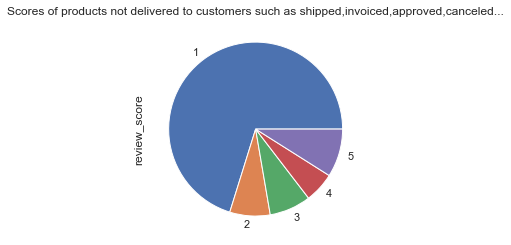

In [151]:
data[~(data['order_status']=='delivered')].groupby('review_score')['review_score'].count().plot(kind='pie')
plt.title('Scores of products not delivered to customers such as shipped,invoiced,approved,canceled...')

In [72]:
len(data[(data['order_delivered_carrier_date'].isnull()) & ( data['order_delivered_customer_date'].isnull()) & ((data['review_score']==4) | (data['review_score']==5))])

118

In [73]:
# I will look order status in details but before that Ilooked them to get insight.
data[(data['order_delivered_carrier_date'].isnull()) & ( data['order_delivered_customer_date'].isnull())].groupby('order_status')['order_status'].count()

order_status
approved         3
canceled       468
invoiced       358
processing     357
unavailable      7
Name: order_status, dtype: int64

In [74]:
#new_time = data[(data['order_delivered_customer_date'].isnull()) & (data['order_status']=='delivered')]['order_purchase_timestamp'] + timedelta(days=12)
#data['order_delivered_customer_date'] = data['order_delivered_customer_date'].fillna(value=new_time)

In [75]:
#time = data[(data['order_delivered_carrier_date'].isnull()) & (data['order_status']=='delivered')]['order_purchase_timestamp'] + timedelta(days=9)
#data['order_delivered_carrier_date'] = data['order_delivered_carrier_date'].fillna(value=time)

In [76]:
#skore4_5 = data[(data['order_delivered_carrier_date'].isnull()) & ( data['order_delivered_customer_date'].isnull()) & ((data['review_score']==4) | (data['review_score']==5))]

In [77]:
#(skore4_5['order_estimated_delivery_date']- skore4_5['review_creation_date']).mean()

* I only filled order_approved_at and delivered order's null values.
* Since I decided that the orders contain null values due to their current status, 
* I decided to deal only with the delivered ones instead of filling in the null values.
* But I added my analyzes according to different statuses. 
* I named only the data that was delivered as final data. 
* I continued the analysis of order statuses through what I named Data.

In [78]:
# I focused only delivered items which are 97% of the data
# From now on I will use final_data mostly, except looking order status distribution.
final_data = data[data['order_status']=='delivered']

In [79]:
final_data.isnull().sum()

order_id                         0
customer_id                      0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    8
order_estimated_delivery_date    0
payment_sequential               0
payment_type                     0
payment_installments             0
payment_value                    0
customer_unique_id               0
customer_zip_code_prefix         0
customer_city                    0
customer_state                   0
order_item_id                    0
product_id                       0
seller_id                        0
shipping_limit_date              0
price                            0
freight_value                    0
zip_code_prefix                  0
seller_city                      0
seller_state                     0
product_category                 0
review_id                        0
review_score                     0
purchased_Year      

In [80]:
final_data.shape

(113210, 34)

In [81]:
# Above I changed object types to datetime
# Here is my final data, I will analysis this data from now on.
final_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 113210 entries, 0 to 115608
Data columns (total 34 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       113210 non-null  object        
 1   customer_id                    113210 non-null  object        
 2   order_status                   113210 non-null  object        
 3   order_purchase_timestamp       113210 non-null  datetime64[ns]
 4   order_approved_at              113210 non-null  datetime64[ns]
 5   order_delivered_carrier_date   113210 non-null  datetime64[ns]
 6   order_delivered_customer_date  113202 non-null  datetime64[ns]
 7   order_estimated_delivery_date  113210 non-null  datetime64[ns]
 8   payment_sequential             113210 non-null  int64         
 9   payment_type                   113210 non-null  object        
 10  payment_installments           113210 non-null  int64         
 11  

# <span style='color:gray '> Exploratory Data Analysis </span>

In [82]:
final_data.sample(5) # let's look at the sample of the data from different indexes.

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,zip_code_prefix,seller_city,seller_state,product_category,review_id,review_score,purchased_Year,purchased_Month,purchased_Day,Day,Season,SeasonName
84115,d5b20c4d4aa379d9215dba07d60c7e24,1d7dc770268b6a21bd58a278a1707794,delivered,2018-05-14 21:52:41,2018-05-14 22:10:23,2018-05-15 10:42:00,2018-06-06 00:25:25,2018-06-05,2,voucher,1,76.92,cfb82bcf7df6cc44ee0dd204e6b03fd7,50050,recife,PE,1,44d097d59e8430f88a67517cd0c4f865,6560211a19b47992c3666cc44a7e94c0,2018-05-16 22:10:23,69.0,19.17,5849,sao paulo,SP,fashion_bags_accessories,fd5f16f71d64c23d117d913ada05ee9d,4,2018,May,Monday,14,2,Autumn
16927,493bfa3afd1c7c384e300b4f4b511048,47d35d8232327cb512ac7b6b84305871,delivered,2017-09-06 12:51:43,2017-09-06 13:05:11,2017-09-12 16:29:31,2017-09-23 16:26:23,2017-10-02,1,credit_card,2,143.12,e0fd7725d9467c84add5e7c9c047ceb9,71692,brasilia,DF,1,b4fc7e84dcaf2fcf3edb234e30362929,c3867b4666c7d76867627c2f7fb22e21,2017-09-14 13:05:11,125.0,18.12,14580,guara,SP,sports_leisure,6cbf1803bd2be93a1e57a213614b82ac,3,2017,September,Wednesday,6,4,Spring
3292,fa9b3f5a0eef7954729a194715780e1b,c5deddc906bcc15553a70ffec42806c0,delivered,2017-05-17 10:19:05,2017-05-17 10:30:28,2017-05-18 11:25:00,2017-05-29 12:48:00,2017-06-16,1,credit_card,1,0.48,44b6bbfea26596437062a38c8e6bcec1,15030,sao jose do rio preto,SP,1,6fcabf3ae89dbc8a1c2b13d3d311bc35,8e6cc767478edae941d9bd9eb778d77a,2017-05-23 10:30:28,7.9,16.11,38442,araguari,MG,housewares,d27716cf869cc63cac61f4bc7e029646,5,2017,May,Wednesday,17,2,Autumn
60637,64c1efac740d3ad7dc7f0c3bf425fd7a,614aa3538438ebdbf8ce41bac4fc3443,delivered,2018-08-22 12:46:30,2018-08-22 13:04:29,2018-08-23 12:15:00,2018-08-29 19:32:07,2018-09-12,1,credit_card,3,116.62,9ad975523c3a2bad3b00ae2a5f2c34f4,78025,cuiaba,MT,1,b6b76b074ed0d77d0f3443b12d8adb5e,6560211a19b47992c3666cc44a7e94c0,2018-08-24 13:04:29,99.0,17.62,5849,sao paulo,SP,watches_gifts,c71dd9e7ef2beb484d6c8b5247e4b8eb,5,2018,August,Wednesday,22,3,Winter
52764,95e0a5152da13c4a3e8a6cbe3a0bada3,6490dd4caf44e930d8192751c2625634,delivered,2017-04-04 08:33:00,2017-04-04 08:45:14,2017-04-06 11:43:31,2017-04-12 17:37:50,2017-04-25,1,credit_card,8,425.20,66a0e4ae01e565ad721e85f287a2315e,19813,assis,SP,2,4fcb3d9a5f4871e8362dfedbdb02b064,8581055ce74af1daba164fdbd55a40de,2017-04-10 08:45:14,143.8,16.42,7112,guarulhos,SP,auto,8e9d547a532448a372796777d57fe4b8,5,2017,April,Tuesday,4,2,Autumn


In [85]:
final_data.shape # before creating some new columns using order_purchase_timestamp

(113210, 34)

## <span style='color:gray '> To look order purchase timestamps </span> 

In [86]:
pd.set_option('display.max_columns', 1000)
pd.set_option('display.max_rows', 1000)

In [87]:
final_data['purchased_Year'].unique() # three years available in data 

array([2017, 2018, 2016], dtype=int64)

In [88]:
Purchased_Year = final_data.groupby('purchased_Year').size().sort_values(ascending=False)
Purchased_Year

purchased_Year
2018    61680
2017    51201
2016      329
dtype: int64

<AxesSubplot:xlabel='purchased_Year'>

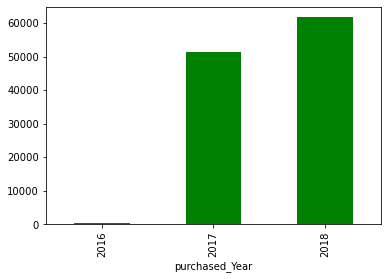

In [89]:
final_data.groupby('purchased_Year').size().plot(kind='bar', color='green')

Text(0.5, 1.0, 'Orders by years')

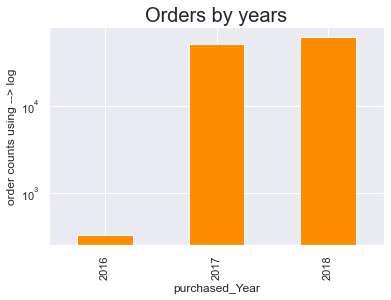

In [90]:
sns.set()
plt.yscale('log')
final_data.groupby('purchased_Year').size().plot(kind='bar', color='darkorange')
plt.ylabel('order counts using --> log')
plt.title('Orders by years', size=(20))

In [385]:
# Price contribution over the years
total_purchase = final_data.pivot_table('price', index='purchased_Year', columns='purchased_Month', aggfunc='sum')
total_purchase.head()

purchased_Month,,January,February,March,April,May,June,July,August,September,October,November,December
purchased_Year,,,,,,,,,,,,,
2016,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,41043.73,0.0,10.90
2017,0.0,118525.81,236110.95,370039.64,349595.61,516270.99,437773.82,510081.68,572738.71,635831.1,655969.70,1008123.2,728074.99
2018,0.0,934616.32,850316.10,971126.98,994816.77,1001315.80,896402.58,882260.08,859092.89,0.0,0.00,0.0,0.00


In [388]:
# Order counts over the years
total_purchase = final_data.pivot_table('order_id', index='purchased_Year', columns='purchased_Month', aggfunc='count')
total_purchase.head()


purchased_Month,,January,February,March,April,May,June,July,August,September,October,November,December
purchased_Year,,,,,,,,,,,,,
2016,0,0,0,0,0,0,0,0,0,0,328,0,1
2017,0,958,1902,3010,2622,4174,3639,4666,4973,4921,5382,8693,6261
2018,0,8146,7669,8184,7987,8017,7265,7117,7295,0,0,0,0


In [389]:
final_data.pivot_table('price', index='Year_Month', columns='product_category', aggfunc='sum', fill_value=0)

product_category,agro_industry_and_commerce,air_conditioning,art,arts_and_craftmanship,audio,auto,baby,bed_bath_table,books_general_interest,books_imported,books_technical,cds_dvds_musicals,christmas_supplies,cine_photo,computers,computers_accessories,consoles_games,construction_tools_construction,construction_tools_lights,construction_tools_safety,cool_stuff,costruction_tools_garden,costruction_tools_tools,diapers_and_hygiene,drinks,dvds_blu_ray,electronics,fashio_female_clothing,fashion_bags_accessories,fashion_childrens_clothes,fashion_male_clothing,fashion_shoes,fashion_sport,fashion_underwear_beach,fixed_telephony,flowers,food,food_drink,furniture_bedroom,furniture_decor,furniture_living_room,furniture_mattress_and_upholstery,garden_tools,health_beauty,home_appliances,home_appliances_2,home_comfort_2,home_confort,home_construction,housewares,industry_commerce_and_business,kitchen_dining_laundry_garden_furniture,la_cuisine,luggage_accessories,market_place,music,musical_instruments,office_furniture,party_supplies,perfumery,pet_shop,security_and_services,signaling_and_security,small_appliances,small_appliances_home_oven_and_coffee,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
Year_Month,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
201610,0.00,1349.29,0.00,0.00,156.99,1128.26,1371.17,478.99,0.00,0.00,0.00,0,0.00,0.00,0.00,842.92,3619.36,0.00,0.00,0.00,1046.10,0.00,0.00,134.90,0.00,0.00,107.99,54.90,373.30,0.00,24.90,29.99,0.00,0.00,704.88,0.00,79.90,0.00,0.00,6384.60,0.00,0.00,1359.88,3559.05,0.00,0.00,0.00,0.00,0.00,1287.07,359.60,0.00,0.00,0.00,915.29,0.00,0.00,1123.91,0.00,4922.80,1069.66,0.00,0.00,0.00,0.00,2012.15,0.00,0.00,228.29,3606.52,2711.07
201612,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,10.90,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
201701,65.97,663.70,0.00,0.00,0.00,4820.03,6177.90,4054.15,234.89,0.00,0.00,0,0.00,0.00,2199.99,3924.14,4290.54,0.00,0.00,0.00,6932.92,0.00,0.00,0.00,0.00,29.80,677.00,77.30,1800.97,0.00,126.90,34.90,0.00,137.25,655.14,0.00,42.82,0.00,73.20,14677.22,1241.90,0.00,8185.93,15060.44,0.00,3805.88,72.80,0.00,0.00,2855.48,0.00,110.00,0.00,492.50,414.14,19.80,339.74,1158.35,0.00,5272.60,799.12,183.29,0.00,1660.79,0.00,10053.78,1561.99,0.00,755.94,4698.09,8086.52
201702,268.82,2326.40,0.00,0.00,213.60,12339.58,2813.68,17415.09,772.71,0.00,159.00,0,0.00,59.00,3549.00,11289.09,4294.77,336.79,0.00,379.00,12839.57,579.98,0.00,0.00,0.00,14.90,1260.85,363.90,2230.11,0.00,610.85,107.05,0.00,396.97,794.22,0.00,692.05,0.00,450.00,20942.41,3477.74,0.00,11871.51,25292.72,740.90,15.99,0.00,414.66,695.60,11713.14,119.00,279.80,0.00,2106.39,1600.21,0.00,2246.18,11075.94,0.00,8889.98,3738.87,0.00,0.00,7251.58,0.00,16465.90,2471.30,792.00,6815.33,9458.43,11078.39
201703,81.99,4453.81,230.60,0.00,1134.77,13412.83,3926.07,27137.68,2533.96,0.00,120.00,0,0.00,0.00,0.00,28097.80,9372.85,38.90,0.00,0.00,21913.81,0.00,0.00,0.00,463.87,453.70,3986.00,19.90,5191.35,0.00,580.80,1640.60,39.90,394.14,1333.45,0.00,2562.56,85.80,0.00,23387.58,3324.00,0.00,27280.26,25831.25,343.20,500.90,355.78,2123.40,665.96,14241.05,238.00,113.98,0.00,6043.81,1897.59,27.99,1667.33,10552.68,0.00,19408.24,8240.06,0.00,75.00,11230.06,0.00,31452.35,5909.22,495.00,8076.06,12376.47,24975.28
201704,0.00,2492.23,119.90,0.00,1032.10,16569.23,4050.45,27549.73,923.38,19.99,75.00,0,69.00,118.00,0.00,18498.34,3772.88,0.00,0.00,0.00,22431.58,1490.21,729.00,0.00,0.00,1434.90,5238.23,64.90,3159.90,0.00,366.89,1496.60,189.78,92.89,505.83,0.00,590.30,47.90,628.98,18695.71,2073.34,109.40,17926.57,22692.23,499.40,799.80,12.90,3179.50,1602.69,12862.44,0.00,1033.40,24.00,7179.20,4253.77,59.80,3818.43,9411.30,0.00,20791.91,6235.68,0.00,128.06,27

####  <span style='color:gray '> Year Month </span> 

In [91]:
# Let's create year month values splitting order purchase timestamp
final_data['Year_Month'] = final_data['order_purchase_timestamp'].dt.strftime('%Y%m')
final_data['Year_Month'].sort_values() # values from september 2016 to september 2018

62780    201610
33768    201610
23889    201610
33769    201610
48236    201610
          ...  
97063    201808
80021    201808
77138    201808
59838    201808
14521    201808
Name: Year_Month, Length: 113210, dtype: object

Text(0.5, 1.0, 'Price sum according to year-month dates')

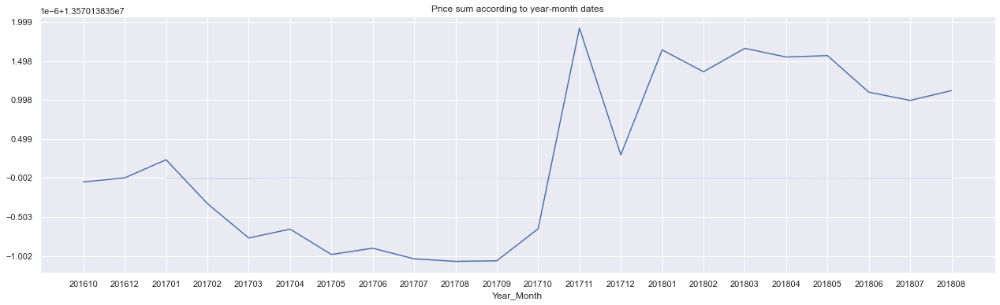

In [92]:
sns.set(rc={'figure.figsize':(21.7,6.0)})
sns.lineplot(data=final_data, x=final_data['Year_Month'].sort_values(), y=final_data["price"].sum())

plt.title('Price sum according to year-month dates')


In [93]:
final_data['Year_Month'].sort_values().unique()

array(['201610', '201612', '201701', '201702', '201703', '201704',
       '201705', '201706', '201707', '201708', '201709', '201710',
       '201711', '201712', '201801', '201802', '201803', '201804',
       '201805', '201806', '201807', '201808'], dtype=object)

In [94]:
year_month = final_data.groupby('Year_Month')['Year_Month'].size()
year_month

Year_Month
201610     328
201612       1
201701     958
201702    1902
201703    3010
201704    2622
201705    4174
201706    3639
201707    4666
201708    4973
201709    4921
201710    5382
201711    8693
201712    6261
201801    8146
201802    7669
201803    8184
201804    7987
201805    8017
201806    7265
201807    7117
201808    7295
Name: Year_Month, dtype: int64

In [95]:
Year_Month_Significant = final_data.groupby('Year_Month')['Year_Month'].size()[2:23]
Year_Month_Significant

Year_Month
201701     958
201702    1902
201703    3010
201704    2622
201705    4174
201706    3639
201707    4666
201708    4973
201709    4921
201710    5382
201711    8693
201712    6261
201801    8146
201802    7669
201803    8184
201804    7987
201805    8017
201806    7265
201807    7117
201808    7295
Name: Year_Month, dtype: int64

Text(0.5, 1.0, 'Orders between 2017 and 2018')

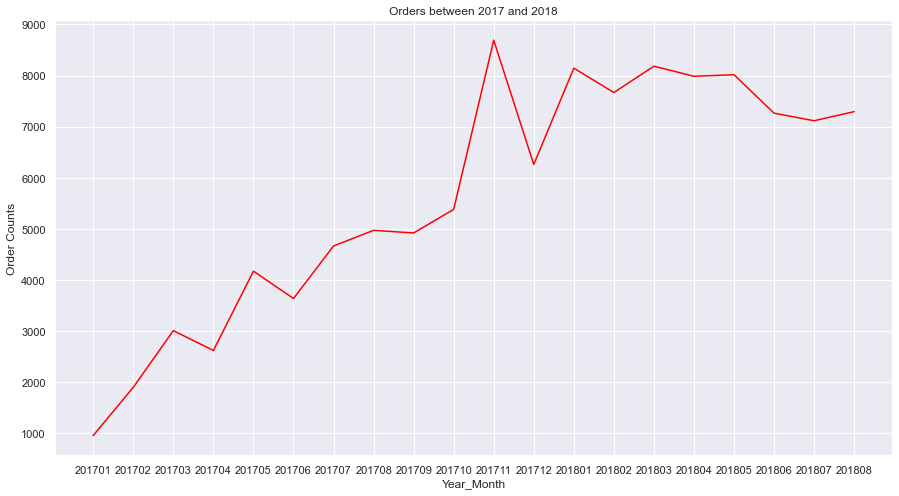

In [96]:
plt.figure(figsize=(15,8))
sns.lineplot(data=Year_Month_Significant, x=Year_Month_Significant.index, y=Year_Month_Significant.values,color="red")
sns.set(rc={'figure.figsize':(10.7,8.27)})
plt.ylabel('Order Counts')
plt.title('Orders between 2017 and 2018')

* Data for October and December 2016 are available. No data for November
* There is data for all months of 2017.
* There is data for the first 8 months of 2018.
* When I make a comparison between the years, I will mostly compare the first 8 months of 2017 and 2018.
* In order to compare the months in a year, I will examine the year 2017.

## <span style='color:gray '> Purchase Months </span> 

In [97]:
final_data['purchased_Month'].unique() # all months are available in the data

['October', 'August', 'September', 'February', 'July', ..., 'December', 'May', 'April', 'January', 'March']
Length: 12
Categories (12, object): ['October', 'August', 'September', 'February', ..., 'May', 'April', 'January', 'March']

In [98]:
Purchased_Month = final_data.groupby('purchased_Month').size().sort_values(ascending=False)
Purchased_Month

purchased_Month
August       12268
May          12191
July         11783
March        11194
June         10904
April        10609
February      9571
January       9104
November      8693
December      6262
October       5710
September     4921
                 0
dtype: int64

Text(0.5, 1.0, 'Purchased Months')

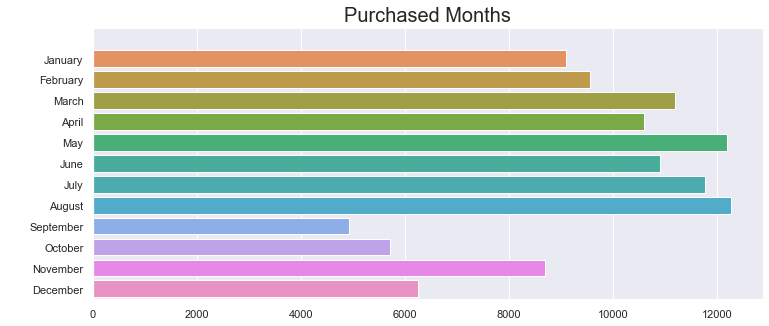

In [99]:
plt.figure(figsize=(12,5))
sns.set_style("darkgrid")
sns.barplot(y=Purchased_Month.index, x=Purchased_Month.values)
plt.ylabel(' ', fontsize=18 )
plt.title('Purchased Months', fontsize=20)

* Caution : Here, I looked at the values by month, but the 11th month of 2016 and the 11th month of 2018 are not available, so looking at the monthly values in all the data will not give the correct results.
* In that respect, comparing the first 8 months of 2017 and 2018 and comparing 2017 on a monthly basis will yield more accurate results.
* That's why I created months of 2017 below.

In [100]:
Monthsof2017 = final_data[final_data['purchased_Year']==2017]['purchased_Month']
Monthsof2017.nunique() # here 12 months are available

12

In [101]:
Monthsof2017 = pd.DataFrame(Monthsof2017)
Month_values2017 = Monthsof2017.groupby('purchased_Month').size() #.sort_values(ascending=False)
Month_values2017

purchased_Month
                0
January       958
February     1902
March        3010
April        2622
May          4174
June         3639
July         4666
August       4973
September    4921
October      5382
November     8693
December     6261
dtype: int64

Text(0.5, 1.0, 'Purchased Months of 2017')

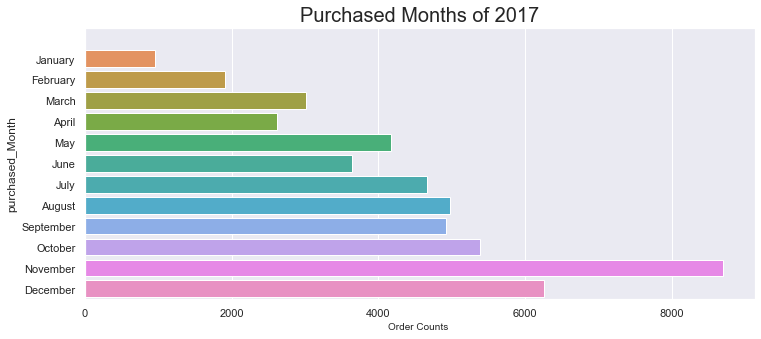

In [102]:
plt.figure(figsize=(12,5))
sns.set_style("darkgrid")
sns.barplot(y=Month_values2017.index, x=Month_values2017.values)
plt.xlabel('Order Counts ', fontsize=10 )
plt.title('Purchased Months of 2017', fontsize=20)

In [103]:
Monthsof2018 = final_data[final_data['purchased_Year']==2018]['purchased_Month']
Monthsof2018.nunique() # here 8 months are available

8

In [106]:
Monthsof2018 = pd.DataFrame(Monthsof2018)
Month_values2018 = Monthsof2018.groupby('purchased_Month').size().sort_values(ascending=False)
Month_values2018 = Month_values2018[:8]
Month_values2018

purchased_Month
March       8184
January     8146
May         8017
April       7987
February    7669
August      7295
June        7265
July        7117
dtype: int64

Text(0.5, 1.0, 'Purchased Months of 2018')

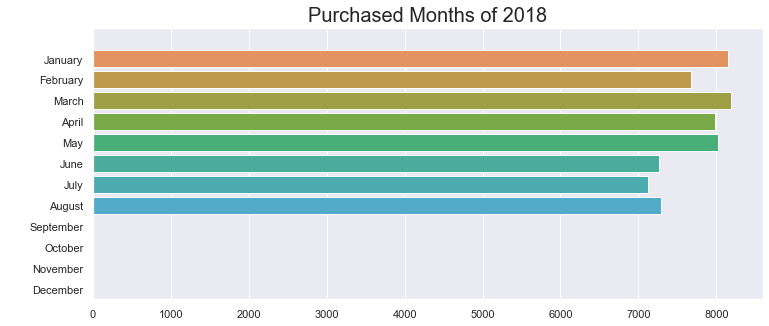

In [107]:
plt.figure(figsize=(12,5))
sns.set_style("darkgrid")
sns.barplot(y=Month_values2018.index, x=Month_values2018.values)
plt.ylabel(' ', fontsize=18 )
plt.title('Purchased Months of 2018', fontsize=20)

Text(0.5, 1.0, 'Purchased Months')

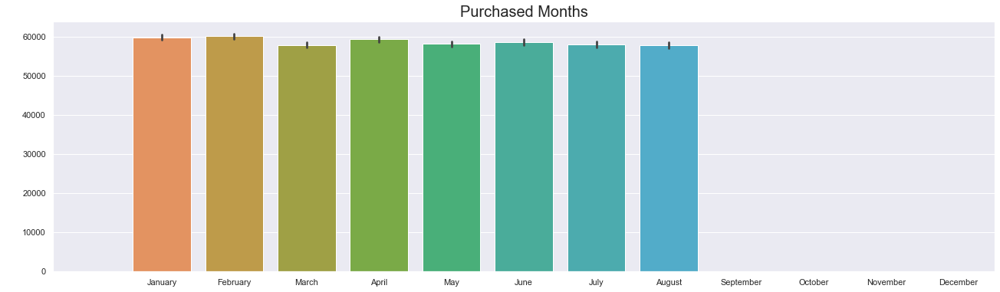

In [108]:
plt.figure(figsize=(22,6))
Data2018 = final_data[final_data['purchased_Year']==2018]['purchased_Month'].sort_values() # only october data were in 2016
sns.set_style("darkgrid")
sns.barplot(y=Data2018.index, x=Data2018.values)
plt.ylabel(' ', fontsize=18 )
plt.title('Purchased Months', fontsize=20)

#### <span style='color:gray '> Purchase Seasons </span> 

In [109]:
season2017  = final_data[final_data['purchased_Year']==2017].groupby('SeasonName')['order_id'].size().reset_index()
#season2017['SeasonName'] = season2017['SeasonName'].str.capitalize()
season2017.loc[0:]

,SeasonName,order_id
0,Autumn,9806
1,Spring,18996
2,Summer,9121
3,Winter,13278


In [111]:
# importing libraries for the subplots
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from matplotlib.gridspec import GridSpec
pd.set_option('display.max_columns', 100)
import plotly.offline as py
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
#for the millions format function
from matplotlib.ticker import FuncFormatter
import matplotlib.ticker as tkr
import matplotlib as mpl
from datetime import datetime, timedelta
from pandas import DataFrame
from PIL import Image



fig = make_subplots(rows=1, cols=1, specs=[[{"type": "pie"}]],vertical_spacing=0, horizontal_spacing=0.02)

fig.add_trace(go.Pie(values= season2017['order_id'], labels= season2017['SeasonName'], name='Store type',
                     marker=dict(colors=['purple','bj','gray','yellow']), hole=0.7,
                    hoverinfo='label+value', textinfo='label + value'), 
                    row=1, col=1)

fig.update_yaxes(showgrid=False, ticksuffix=' ', categoryorder='total ascending', row=1, col=1)
fig.update_xaxes(visible=False, row=1, col=1)
fig.update_yaxes(visible=False, row=1, col=1)
fig.update_layout(height=400, bargap=0.4,
                  margin=dict(b=0,r=20,l=20), xaxis=dict(tickmode='linear'),
                  title_text="Season versus Order Counts in 2017",
                  template="plotly_white",
                  title_font=dict(size=22, color='black', family="Lato, sans-serif"),
                  font=dict(color='#8a8d93'), 
                  hoverlabel=dict(bgcolor="#f2f2f2", font_size=13, font_family="Lato, sans-serif"),
                  showlegend=False)
fig.update_traces(rotation=90)
fig.update_traces(textposition="auto", selector=dict(type='pie'))
# I saw tthis graphic drawing while reading notebook on kaggle, so I started using it.
# I saw here : https://www.kaggle.com/luisenrique18/olist-ecommerce-2017-2018-eda/notebook

In [116]:
final_data['purchased_Day'].unique()

['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Saturday', 'Friday', 'Sunday']
Categories (7, object): ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Saturday', 'Friday', 'Sunday']

In [117]:
Purchased_Day = final_data.groupby('purchased_Day').size().sort_values(ascending=False)
Purchased_Day 

purchased_Day
Tuesday      18406
Monday       18367
Wednesday    17675
Thursday     16909
Friday       16189
Sunday       13451
Saturday     12213
dtype: int64

Text(0.5, 1.0, 'Purchased Days')

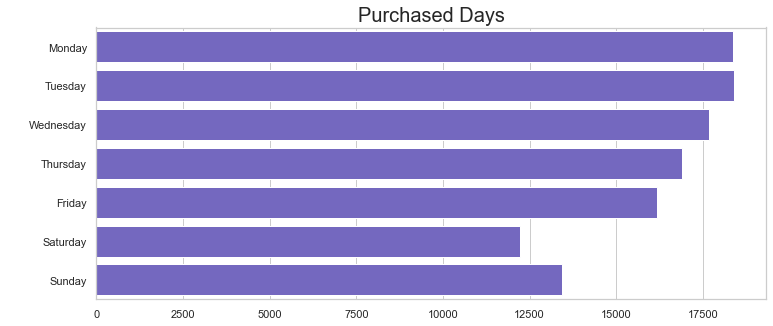

In [118]:
sns.set()
plt.figure(figsize=(12,5))
sns.set_style("whitegrid")
sns.barplot(y=Purchased_Day.index, x=Purchased_Day.values,color='slateblue')
plt.ylabel(' ', fontsize=18 )
plt.title('Purchased Days', fontsize=20)

In [119]:
final_data['purchased_Hour'] = pd.to_datetime(final_data['order_purchase_timestamp']).dt.hour

Text(0, 0.5, 'Order Counts')

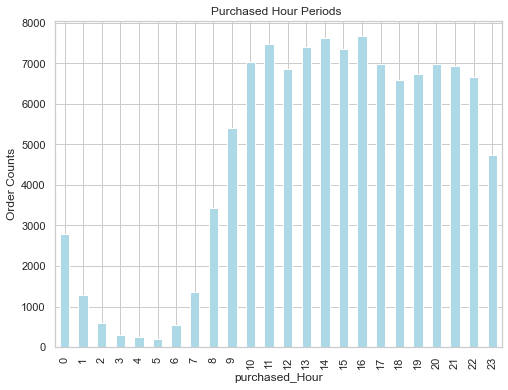

In [120]:
plt.figure(figsize=(8,6))
final_data.groupby('purchased_Hour')['purchased_Hour'].size().plot(kind='bar',color='lightblue')
plt.title('Purchased Hour Periods ')
plt.ylabel('Order Counts')

Text(0.5, 1.0, 'Purchase by Hour Periods Descending Orders')

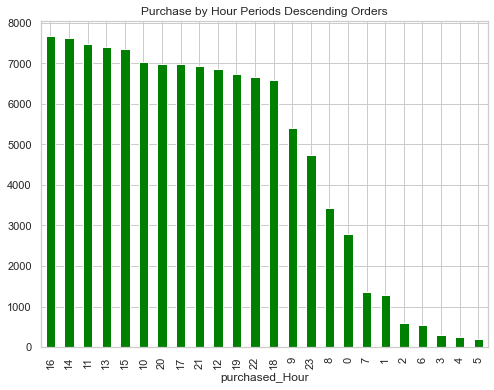

In [121]:
plt.figure(figsize=(8,6))
final_data.groupby('purchased_Hour')['purchased_Hour'].size().sort_values(ascending=False).plot(kind='bar', color='green')
plt.title('Purchase by Hour Periods Descending Orders')

In [122]:
final_data['day_periods'] = (pd.to_datetime(data['order_purchase_timestamp']).dt.hour % 24 + 4) // 4
final_data['day_periods'].replace({1: 'Late Night',
                      2: 'Early Morning',
                      3: 'Morning',
                      4: 'Afternoon',
                      5: 'Evening',
                      6: 'Night'}, inplace=True)

HOUR -->  SESSION       
* 1, 2, 3 and 4 --> Late Night     
   
* 5, 6, 7 and 8 -->  Early Morning  
  
* 9, 10, 11 and 12 --> Morning       
     
* 13,14 ,15 and 16 --> Afternoon       
        
* 17, 18, 19 and 20 -->  Eve         

* 21, 22, 23 and 24 --> Night

Text(0.5, 1.0, 'Purchase Day Periods')

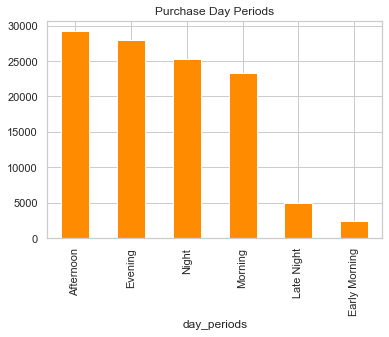

In [123]:
final_data.groupby('day_periods')['day_periods'].size().sort_values(ascending=False).plot(kind='bar', color='darkorange')
plt.title('Purchase Day Periods')

In [131]:
day_periods = final_data.groupby('day_periods').size().reset_index().sort_values(by=0,ascending=False)
day_periods["day_periods"] = day_periods["day_periods"].str.capitalize()
day_periods[0]

0    29233
2    27962
5    25340
4    23366
3     4951
1     2358
Name: 0, dtype: int64

day_periods
Afternoon        29233
Early Morning     2358
Evening          27962
Late Night        4951
Morning          23366
Night            25340
Name: day_periods, dtype: int64

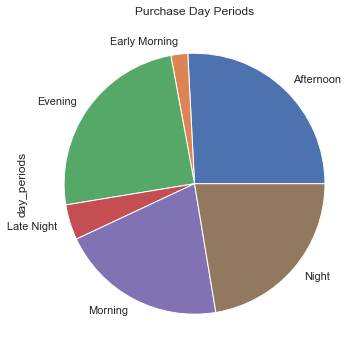

In [125]:
sns.set()
plt.figure(figsize=(8,6))
day_periods = final_data.groupby('day_periods')['day_periods'].size()
day_periods.plot(kind='pie')
plt.title('Purchase Day Periods')
day_periods

In [132]:

fig = make_subplots(rows=1, cols=1, specs=[[{"type": "pie"}]],vertical_spacing=0, horizontal_spacing=0.02)

fig.add_trace(go.Pie(values= day_periods[0], labels=day_periods["day_periods"], name='Store type',
                     marker=dict(colors=['slateblue','darkblue','lightblue','#91A2BF','#C8D0DF']), hole=0.7,
                    hoverinfo='label+value', textinfo='label + value'), 
                    row=1, col=1)

fig.update_yaxes(showgrid=False, ticksuffix=' ', categoryorder='total ascending', row=1, col=1)
fig.update_xaxes(visible=False, row=1, col=1)
fig.update_yaxes(visible=False, row=1, col=1)
fig.update_layout(height=400, bargap=0.4,
                  margin=dict(b=0,r=20,l=20), xaxis=dict(tickmode='linear'),
                  title_text="Order Counts According to Day Periods in the Data",
                  template="plotly_white",
                  title_font=dict(size=22, color='black', family="Lato, sans-serif"),
                  font=dict(color='#8a8d93'), 
                  hoverlabel=dict(bgcolor="#f2f2f2", font_size=13, font_family="Lato, sans-serif"),
                  showlegend=False)
fig.update_traces(rotation=90)
fig.update_traces(textposition="auto", selector=dict(type='pie'))

* The Year data is available for 2016, 2017 and 2018
* The Month data is available for each month
* The day data is available for each day.
* Most sales were made in the afternoon and evening hours.
* Order density on Monday and Tuesday is higher than other days of the week. 
* Spring is the season with the highest sales.
* November is the month with the highest sales in a year.
* When looking at the sales by days in November, the highest number of sales was made on Friday, Friday, November 24, 2017 is the time of the black week.

## <span style='color:gray '> Order Status Statistics   </span> 

In [133]:
# By the time this dataset was created, the highest amount of orders went from delivered ones

In [134]:
# here the data was used because in the final_data only delivered itesm are available
data.order_status.value_counts()

delivered      113210
shipped          1138
canceled          536
invoiced          358
processing        357
unavailable         7
approved            3
Name: order_status, dtype: int64

Text(0.5, 1.0, 'Order Status in the Data')

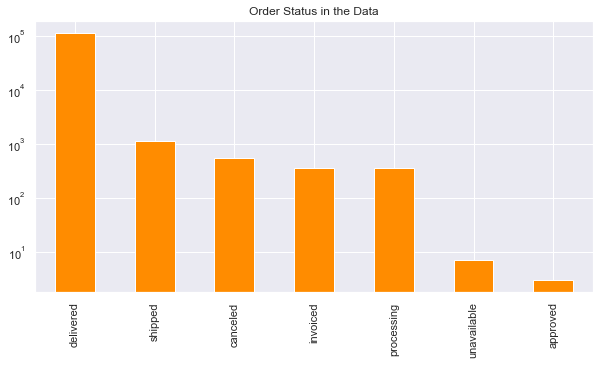

In [136]:
# here it was used data because in the final_data only delivered items are available
plt.figure(figsize=(10,5))
plt.yscale('log')
data.order_status.value_counts().plot(kind='bar', color='darkorange')
plt.title('Order Status in the Data')

In [137]:
order_status = data.groupby('order_status').size().reset_index().sort_values(by=0,ascending=False)
order_status["order_status"] = order_status["order_status"].str.capitalize()
order_status

,order_status,0
2,Delivered,113210
5,Shipped,1138
1,Canceled,536
3,Invoiced,358
4,Processing,357
6,Unavailable,7
0,Approved,3


In [138]:
fig = make_subplots(rows=1, cols=1, 
                    specs=[[{"type": "pie"}]],
                    vertical_spacing=0, horizontal_spacing=0.02)

fig.add_trace(go.Pie(values= order_status[0], labels=order_status["order_status"], name='Store type',
                     marker=dict(colors=['#6D83AA','#91A2BF','#334668','#496595','#C8D0DF']), hole=0.7,
                    hoverinfo='label+value', textinfo='label + value'), 
                    row=1, col=1)

fig.update_yaxes(showgrid=False, ticksuffix=' ', categoryorder='total ascending', row=1, col=1)
fig.update_xaxes(visible=False, row=1, col=1)
fig.update_yaxes(visible=False, row=1, col=1)
fig.update_layout(height=400, bargap=0.4,
                  margin=dict(b=0,r=20,l=20), xaxis=dict(tickmode='linear'),
                  title_text="Order Status Distribution in the Data",
                  template="plotly_white",
                  title_font=dict(size=22, color='black', family="Lato, sans-serif"),
                  font=dict(color='#8a8d93'), 
                  hoverlabel=dict(bgcolor="#f2f2f2", font_size=13, font_family="Lato, sans-serif"),
                  showlegend=False)
fig.update_traces(rotation=90)
fig.update_traces(textposition="auto", selector=dict(type='pie'))

 I only choosed delivered items in my analysis.
 97% of the delivered ones.
 I will continue my analysis using final_data (only delivered items)

## <span style='color:gray '> Order Delivery Time Statistics   </span> 

In [143]:
# Sellers mostly approved the sale after customers' purchases.
diff_app_purc = (final_data['order_approved_at'] - final_data['order_purchase_timestamp']).describe()
diff_app_purc

count                       113210
mean     0 days 10:25:55.862035155
std      0 days 20:56:50.760572226
min                0 days 00:00:00
25%                0 days 00:12:58
50%                0 days 00:20:50
75%         0 days 14:56:15.500000
max               30 days 21:26:37
dtype: object

In [144]:
# Products given to cargo in 2 to 3 days.
(final_data['order_delivered_carrier_date'] - final_data['order_purchase_timestamp']).describe()

count                       113210
mean     3 days 06:33:26.486591290
std      3 days 14:34:22.530310381
min            -172 days +18:54:07
25%         1 days 03:14:28.500000
50%                2 days 05:25:23
75%                4 days 02:39:30
max              107 days 01:33:02
dtype: object

In [145]:
# Orders were delivered in an average of 10 days.
(final_data['order_delivered_customer_date'] - final_data['order_purchase_timestamp']).describe()

count                        113202
mean     12 days 10:36:09.042914436
std       9 days 08:32:12.271096955
min                 0 days 12:48:07
25%                 6 days 17:43:59
50%         10 days 04:31:20.500000
75%                15 days 12:04:39
max               208 days 08:26:32
dtype: object

In [146]:
# The estimated delivery date is 23 days as the median value, which is a bit of a long time.
(final_data['order_estimated_delivery_date'] - final_data['order_purchase_timestamp']).describe()

count                        113210
mean     23 days 20:03:57.310228778
std       8 days 19:54:39.331719979
min                 2 days 00:11:32
25%         18 days 09:36:20.500000
50%         23 days 06:04:00.500000
75%         28 days 11:11:23.250000
max               155 days 03:15:04
dtype: object

In [147]:
# Most of the time, the products were delivered to the customers before the estimated delivery date.
(final_data['order_estimated_delivery_date'] - final_data['order_delivered_customer_date']).describe()

count                        113202
mean     11 days 09:27:48.564751506
std      10 days 02:11:37.781050563
min             -189 days +00:35:53
25%          6 days 13:10:26.250000
50%                12 days 01:38:30
75%                16 days 07:45:48
max               146 days 00:23:13
dtype: object

## <span style='color:gray '> Product Categories  </span> 

In [148]:
# There are 71 unique categories
final_data.product_category.nunique()

71

In [149]:
# Distribution of product sales by categories
ProductCategories = final_data.groupby('product_category')['product_category'].count().sort_values(ascending=False)
ProductCategories

product_category
bed_bath_table                             11685
health_beauty                               9747
sports_leisure                              8736
furniture_decor                             8558
computers_accessories                       7927
housewares                                  7154
watches_gifts                               6032
telephony                                   4580
garden_tools                                4452
auto                                        4260
toys                                        4161
cool_stuff                                  3888
perfumery                                   3495
baby                                        3096
electronics                                 2789
stationery                                  2557
fashion_bags_accessories                    2114
pet_shop                                    1998
office_furniture                            1748
luggage_accessories                         1144
con

Text(0.5, 1.0, 'Product Categories by Orders')

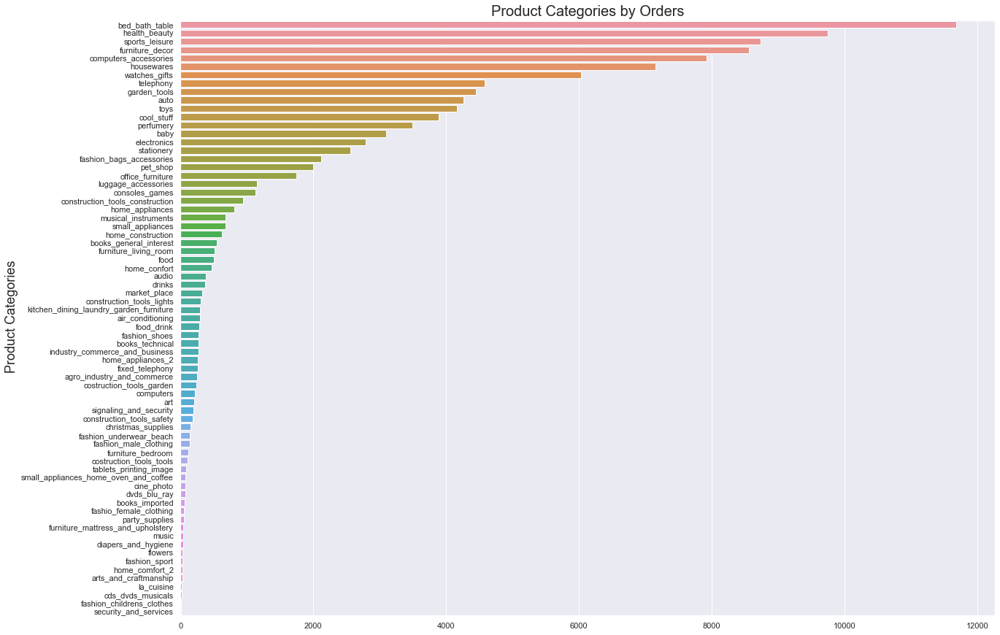

In [150]:
plt.figure(figsize=(20,15))
sns.set_style("darkgrid")
sns.barplot(y=ProductCategories.index, x=ProductCategories.values)
plt.ylabel(' Product Categories', fontsize=18 )
plt.title('Product Categories by Orders', fontsize=20)

In [151]:
# Let's choose top 10 highest categories
Top10highest = ProductCategories[:10]
Top10highest

product_category
bed_bath_table           11685
health_beauty             9747
sports_leisure            8736
furniture_decor           8558
computers_accessories     7927
housewares                7154
watches_gifts             6032
telephony                 4580
garden_tools              4452
auto                      4260
Name: product_category, dtype: int64

Text(0.5, 1.0, 'Distribution of product sales by categories - Top 10')

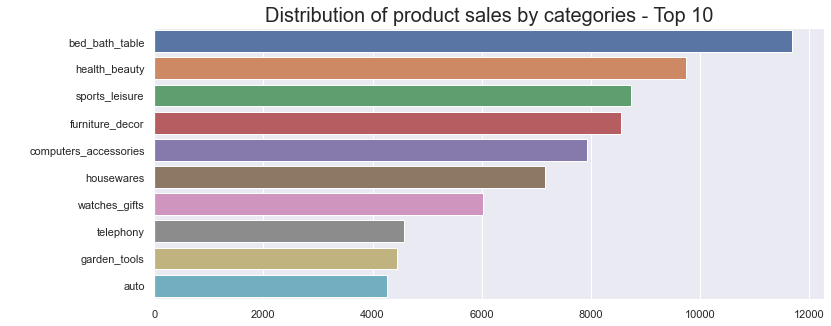

In [152]:
sns.set_style()
plt.figure(figsize=(12,5))
sns.set_style("darkgrid")
sns.barplot(y=ProductCategories[:10].index, x=ProductCategories[:10].values)
plt.ylabel(' ', fontsize=18 )
plt.title('Distribution of product sales by categories - Top 10', fontsize=20)
# It is important that we know which products are most demanded by the customers, 
# and the availability of stock in these products can prevent customers from shopping on other sites.
# It can be tried to gain more sellers for these products, to create choices for customers.

In [153]:
# Categories of least sold products
lowest10=ProductCategories[-10:]
lowest10

product_category
music                        40
diapers_and_hygiene          37
flowers                      31
fashion_sport                30
home_comfort_2               28
arts_and_craftmanship        24
la_cuisine                   15
cds_dvds_musicals            14
fashion_childrens_clothes     7
security_and_services         2
Name: product_category, dtype: int64

Text(0.5, 1.0, 'Distribution of product sales by categories - Least 10')

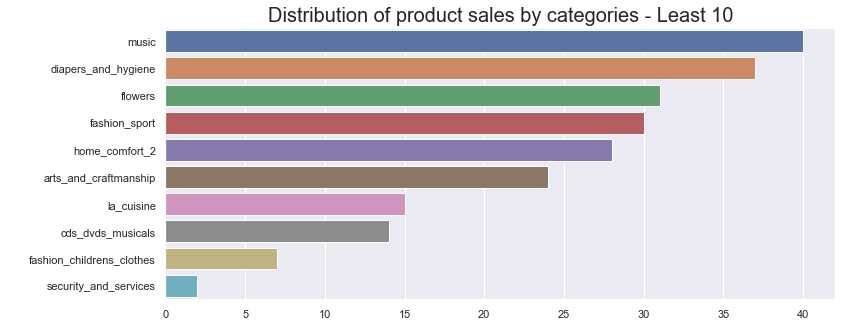

In [154]:
plt.figure(figsize=(12,5))
sns.set_style("darkgrid")
sns.barplot(y=ProductCategories[-10:].index, x=ProductCategories[-10:].values)
plt.ylabel(' ', fontsize=18 )
plt.title('Distribution of product sales by categories - Least 10', fontsize=20)

* Categories versus Scores

In [155]:
Category_by_score = final_data.groupby('product_category')['review_score'].mean().sort_values(ascending=False)
Category_by_score

product_category
fashion_childrens_clothes                  5.000000
cds_dvds_musicals                          4.642857
books_imported                             4.525424
books_general_interest                     4.502752
small_appliances_home_oven_and_coffee      4.453333
flowers                                    4.419355
costruction_tools_tools                    4.415842
books_technical                            4.400749
food_drink                                 4.387900
fashion_sport                              4.366667
luggage_accessories                        4.330420
cine_photo                                 4.305556
fashion_shoes                              4.272388
food                                       4.272366
dvds_blu_ray                               4.253731
stationery                                 4.235823
small_appliances                           4.229750
home_appliances_2                          4.229008
pet_shop                                   4.22

Text(0.5, 1.0, 'Product Ratings of the Least 10 product categories')

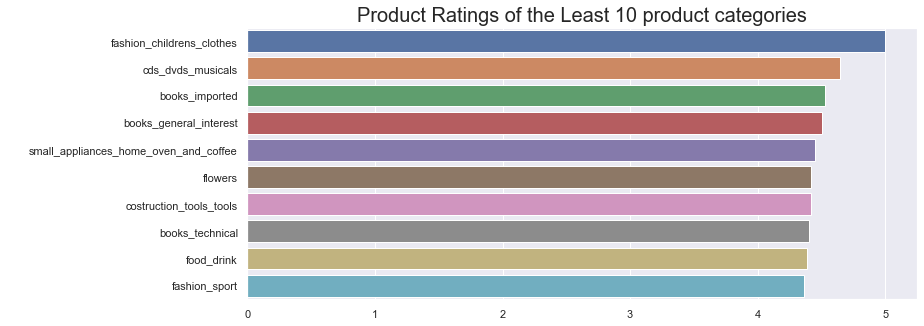

In [156]:
plt.figure(figsize=(12,5))
sns.set_style("darkgrid")
sns.barplot(y=Category_by_score[:10].index, x=Category_by_score[:10].values)
plt.ylabel(' ', fontsize=18 )
plt.title('Product Ratings of the Least 10 product categories' , fontsize=20)
# The 10 products with the highest scores are not the 10 categories with the highest demand. 

Text(0.5, 1.0, 'Lowest 10 Ratings ')

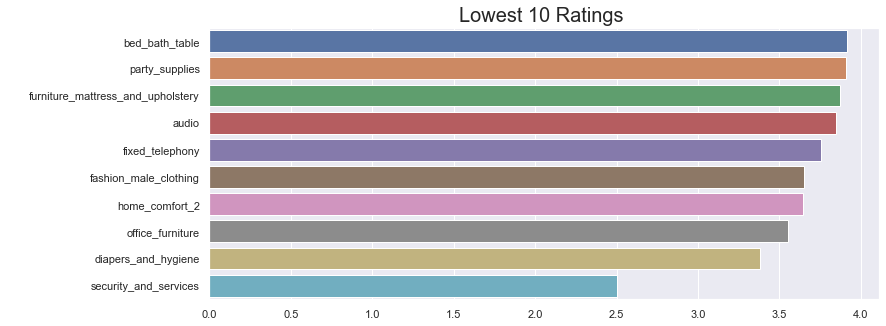

In [157]:
plt.figure(figsize=(12,5))
sns.set_style("darkgrid")
sns.barplot(y=Category_by_score[-10:].index, x=Category_by_score[-10:].values)
plt.ylabel(' ', fontsize=18 )
plt.title('Lowest 10 Ratings ', fontsize=20)


* The 10 products with the highest scores are not the 10 categories with the highest demand. 
* A few of the least sold categories are the products that sell the lowest rated.


* Total Price for each categories

In [158]:
Cat_vs_Price = final_data.groupby('product_category')['price'].sum().sort_values(ascending=False)
Cat_vs_Price

product_category
health_beauty                              1266992.59
watches_gifts                              1207633.40
bed_bath_table                             1082024.32
sports_leisure                              989781.66
computers_accessories                       922593.78
furniture_decor                             746811.14
housewares                                  646232.97
cool_stuff                                  628528.54
auto                                        594994.54
garden_tools                                490451.78
toys                                        483557.04
baby                                        419343.43
perfumery                                   404133.97
telephony                                   323588.44
office_furniture                            277472.70
stationery                                  230955.00
computers                                   229767.62
pet_shop                                    219619.94
musical_ins

Text(0.5, 1.0, 'Categories versus total price - Top 10')

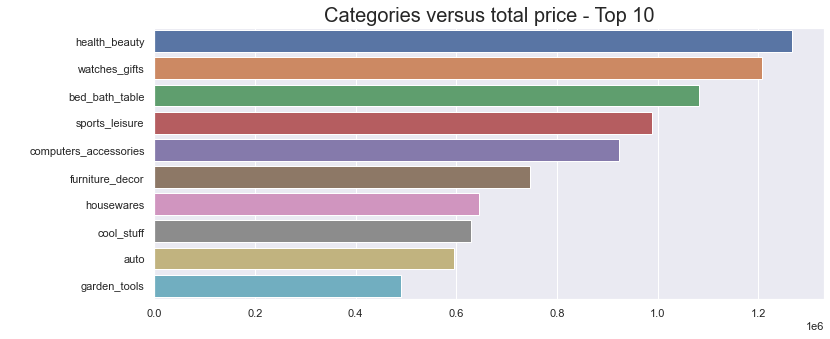

In [159]:
plt.figure(figsize=(12,5))
sns.set_style("darkgrid")
sns.barplot(y=Cat_vs_Price[:10].index, x=Cat_vs_Price[:10].values)
plt.ylabel(' ', fontsize=18 )
plt.title('Categories versus total price - Top 10', fontsize=20)

In [160]:
# Pivot table for the price sum for each categories
price_pivot = final_data.pivot_table(index =['product_category'], 
                       values =['price'], 
                       aggfunc ='sum')
price_pivot.sort_values(by='price', ascending=False)

,price
product_category,
health_beauty,1266992.59
watches_gifts,1207633.40
bed_bath_table,1082024.32
sports_leisure,989781.66
computers_accessories,922593.78
furniture_decor,746811.14
housewares,646232.97
cool_stuff,628528.54
auto,594994.54


<AxesSubplot:title={'center':'Price sum for each categories'}, ylabel='product_category'>

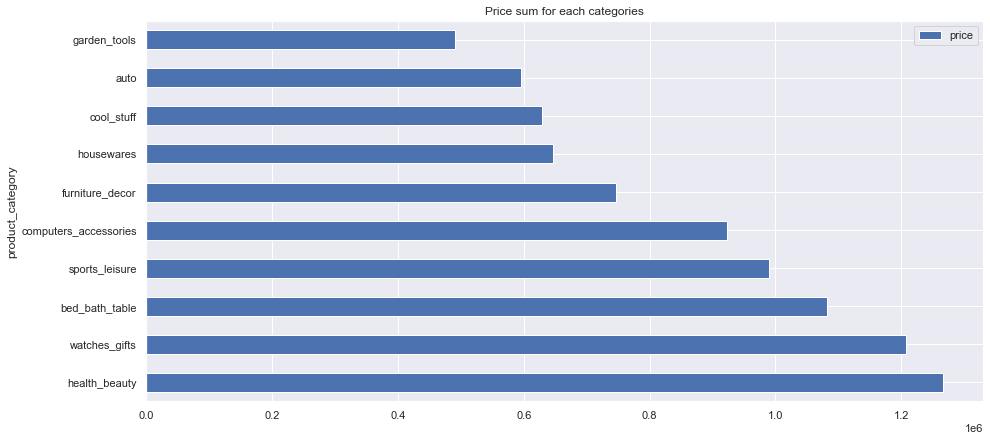

In [161]:
# top 10 price contribution
price_pivot.sort_values(by='price', ascending=False)[:10].plot.barh(figsize=(15,7),title='Price sum for each categories')

In [162]:
# In 2017 sales for each categories - top 10
final_data[final_data['purchased_Year']==2017].groupby('product_category')['product_category'].size().sort_values(ascending=False)[:10]

product_category
bed_bath_table           5611
furniture_decor          4272
sports_leisure           4162
health_beauty            3732
computers_accessories    3135
housewares               2991
toys                     2630
garden_tools             2528
cool_stuff               2388
watches_gifts            2293
Name: product_category, dtype: int64

In [164]:
# Now for 2018, top 10 categories
data[data['purchased_Year']==2018].groupby('product_category')['product_category'].size().sort_values(ascending=False)[:10]

product_category
bed_bath_table           6135
health_beauty            6080
computers_accessories    4858
sports_leisure           4647
furniture_decor          4275
housewares               4227
watches_gifts            3809
auto                     2697
telephony                2411
garden_tools             1948
Name: product_category, dtype: int64

In [163]:
# In 2017 product categories sales least 15 categories
final_data[final_data['purchased_Year']==2017].groupby('product_category')['product_category'].size().sort_values(ascending=False)[-15:]

product_category
furniture_mattress_and_upholstery        21
home_comfort_2                           18
construction_tools_lights                18
books_imported                           14
cds_dvds_musicals                        13
music                                    11
la_cuisine                               11
party_supplies                           10
cine_photo                                8
flowers                                   8
fashion_childrens_clothes                 4
small_appliances_home_oven_and_coffee     3
security_and_services                     2
diapers_and_hygiene                       2
arts_and_craftmanship                     2
Name: product_category, dtype: int64

In [165]:
# Least 10 categories in 2018
final_data[final_data['purchased_Year']==2018].groupby('product_category')['product_category'].size().sort_values(ascending=False)[-15:]

product_category
party_supplies                       35
diapers_and_hygiene                  34
dvds_blu_ray                         30
music                                29
fashion_male_clothing                25
flowers                              23
tablets_printing_image               22
arts_and_craftmanship                22
furniture_mattress_and_upholstery    19
fashio_female_clothing               16
home_comfort_2                       10
fashion_sport                         5
la_cuisine                            4
fashion_childrens_clothes             3
cds_dvds_musicals                     1
Name: product_category, dtype: int64

In [167]:
# via this pivot table, you can see each categorie's order counts for ach month
# hence we can se which categories increases or decreases monthly
# or in some months no orders available for some categories, it give us insgihts about orders
pd.pivot_table(final_data[(final_data['purchased_Year']==2017) ], 
                   values='order_id', index='product_category', columns=['purchased_Month'], aggfunc='count', fill_value=0)

purchased_Month,,January,February,March,April,May,June,July,August,September,October,November,December
product_category,,,,,,,,,,,,,
agro_industry_and_commerce,0,3,9,2,0,4,1,1,4,4,5,19,11
air_conditioning,0,4,11,18,15,7,11,5,15,7,14,18,3
art,0,0,0,6,1,6,6,3,4,3,3,2,4
arts_and_craftmanship,0,0,0,0,0,1,0,1,0,0,0,0,0
audio,0,0,7,14,12,17,11,5,9,11,31,38,18
auto,0,31,85,79,93,120,114,121,152,109,156,266,267
baby,0,39,31,46,51,107,78,135,129,175,138,204,143
bed_bath_table,0,49,171,309,308,412,416,618,577,562,604,1011,574
books_general_interest,0,2,8,24,12,20,20,13,27,15,10,39,42


In [169]:
# same logic but this time in 2018
pd.pivot_table(final_data[(final_data['purchased_Year']==2018) ], 
                   values='order_id', index='product_category', columns=['purchased_Month'], aggfunc='count', fill_value=0)

purchased_Month,,January,February,March,April,May,June,July,August,September,October,November,December
product_category,,,,,,,,,,,,,
agro_industry_and_commerce,0,18,48,41,12,8,10,28,18,0,0,0,0
air_conditioning,0,29,12,24,21,14,15,17,21,0,0,0,0
art,0,19,13,7,24,35,28,22,19,0,0,0,0
arts_and_craftmanship,0,0,0,0,1,1,0,11,9,0,0,0,0
audio,0,27,15,34,32,21,19,22,30,0,0,0,0
auto,0,269,331,345,359,321,307,352,375,0,0,0,0
baby,0,229,171,227,243,253,235,231,220,0,0,0,0
bed_bath_table,0,900,730,811,756,763,809,628,669,0,0,0,0
books_general_interest,0,44,28,40,49,53,37,26,36,0,0,0,0


In [170]:
final_data.groupby(['purchased_Year','product_category'])['order_id'].count()

purchased_Year  product_category                       
2016            air_conditioning                              8
                audio                                         2
                auto                                          8
                baby                                         11
                bed_bath_table                                8
                computers_accessories                        15
                consoles_games                                7
                cool_stuff                                    7
                diapers_and_hygiene                           1
                electronics                                   1
                fashio_female_clothing                        1
                fashion_bags_accessories                      9
                fashion_male_clothing                         1
                fashion_shoes                                 1
                fixed_telephony                 

In [171]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from matplotlib.gridspec import GridSpec
pd.set_option('display.max_columns', 100)
import plotly.offline as py
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
#for the millions format function
from matplotlib.ticker import FuncFormatter
import matplotlib.ticker as tkr
import matplotlib as mpl
from datetime import datetime, timedelta
from pandas import DataFrame
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from nltk.corpus import stopwords
import re


def thousand_count_y(y, pos):
    return '{:.0f} K'.format(y*1e-3)
formatter_thousand_count_y = FuncFormatter(thousand_count_y)
#ax2.yaxis.set_major_formatter(formatter_thousand_count_y)

def millons_count_y(y, pos):
    return '{:.0f} M'.format(y*1e-6)
formatter_millons_count_y = FuncFormatter(millons_count_y)
#ax2.yaxis.set_major_formatter(formatter_millons_count_y)

def thousand_count_x(x, pos):
    return '{:.0f} K'.format(x*1e-3)
formatter_thousand_count_x = FuncFormatter(thousand_count_x)
#ax2.yaxis.set_major_formatter(formatter_thousand_count_x)

def millons_count_x(x, pos):
    return '{:.0f} M'.format(x*1e-6)
formatter_millons_count_x = FuncFormatter(millons_count_x)
#ax2.yaxis.set_major_formatter(formatter_millons_count_x)
#__________________________________________________________________________
def thousand_real_y(y, pos):
    return 'R${:.0f} K'.format(y*1e-3)
formatter_thousand_real_y = FuncFormatter(thousand_real_y)
#ax2.yaxis.set_major_formatter(formatter_thousand_real_y)

def millons_real_y(y, pos):
    return 'R${:.1f} M'.format(y*1e-6)
formatter_millons_real_y = FuncFormatter(millons_real_y)
#ax2.yaxis.set_major_formatter(formatter_millons_real_y)

def thousand_real_x(x, pos):
    return 'R${:.0f} K'.format(x*1e-3)
formatter_thousand_real_x = FuncFormatter(thousand_real_x)
#ax2.yaxis.set_major_formatter(formatter_thousand_real_x)

def millons_real_x(x, pos):
    return 'R${:.1f} M'.format(x*1e-6)
formatter_millons_real_x = FuncFormatter(millons_real_x)
#ax2.yaxis.set_major_formatter(formatter_millons_real_x)

In [173]:
sellers_x_date = pd.merge(order_items,orders, on = "order_id")
sellers_x_date = sellers_x_date.drop_duplicates(subset=["seller_id"])
sellers_x_date.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29,3ce436f183e68e07877b285a838db11a,delivered,2017-09-13 08:59:02,2017-09-13 09:45:35,2017-09-19 18:34:16,2017-09-20 23:43:48,2017-09-29 00:00:00
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93,f6dd3ec061db4e3987629fe6b26e5cce,delivered,2017-04-26 10:53:06,2017-04-26 11:05:13,2017-05-04 14:35:00,2017-05-12 16:04:24,2017-05-15 00:00:00
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87,6489ae5e4333f3693df5ad4372dab6d3,delivered,2018-01-14 14:33:31,2018-01-14 14:48:30,2018-01-16 12:36:48,2018-01-22 13:19:16,2018-02-05 00:00:00
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79,d4eb9395c8c0431ee92fce09860c5a06,delivered,2018-08-08 10:00:35,2018-08-08 10:10:18,2018-08-10 13:28:00,2018-08-14 13:32:39,2018-08-20 00:00:00
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14,58dbd0b2d70206bf40e62cd34e84d795,delivered,2017-02-04 13:57:51,2017-02-04 14:10:13,2017-02-16 09:46:09,2017-03-01 16:42:31,2017-03-17 00:00:00


In [174]:
#The 10 cities with the most clients
clients_by_city = customers.groupby("customer_city").count()["customer_unique_id"].reset_index().sort_values(by="customer_unique_id",ascending=False).head(10)
clients_by_city.rename(columns = {"customer_unique_id":"total"}, inplace=True)
clients_by_city

,customer_city,total
3597,sao paulo,15540
3155,rio de janeiro,6882
453,belo horizonte,2773
558,brasilia,2131
1143,curitiba,1521
707,campinas,1444
2964,porto alegre,1379
3247,salvador,1245
1529,guarulhos,1189
3428,sao bernardo do campo,938


In [175]:
#The 10 states with the most clients
clients_by_state = customers.groupby(["customer_state"]).count()["customer_unique_id"].reset_index().sort_values(by="customer_unique_id",ascending=False).head(10)
clients_by_state.rename(columns = {"customer_unique_id":"total"}, inplace=True)
clients_by_state

,customer_state,total
25,SP,41746
18,RJ,12852
10,MG,11635
22,RS,5466
17,PR,5045
23,SC,3637
4,BA,3380
6,DF,2140
7,ES,2033
8,GO,2020


In [176]:
#The 10 cities with the most sellers
sellers_by_city = sellers.groupby("seller_city").count()["seller_id"].reset_index().sort_values(by="seller_id",ascending=False).head(10)
sellers_by_city.rename(columns = {"seller_id":"total"}, inplace=True)
sellers_by_city

,seller_city,total
517,sao paulo,694
159,curitiba,127
450,rio de janeiro,96
64,belo horizonte,68
442,ribeirao preto,52
220,guarulhos,50
227,ibitinga,49
483,santo andre,45
101,campinas,41
325,maringa,40


In [177]:
clients_x_date = pd.merge(customers, orders, on = "customer_id")
clients_x_date.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29 12:41:19,2018-02-06 00:00:00
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13 00:00:00
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10 00:00:00
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15 00:00:00


In [178]:
clients_x_date[['order_purchase_timestamp','order_approved_at','order_delivered_carrier_date','order_delivered_customer_date','order_estimated_delivery_date']]= clients_x_date[['order_purchase_timestamp','order_approved_at','order_delivered_carrier_date','order_delivered_customer_date','order_estimated_delivery_date']].apply(pd.to_datetime)

In [179]:
clients_x_date['Year_Month'] = clients_x_date['order_purchase_timestamp'].dt.strftime('%Y%m')
#clients_x_date['Year_Month'].sort_values() # values from september 2016 to september 2018

In [180]:
sellers_x_date[['order_purchase_timestamp','order_approved_at','order_delivered_carrier_date','order_delivered_customer_date','order_estimated_delivery_date']]= sellers_x_date[['order_purchase_timestamp','order_approved_at','order_delivered_carrier_date','order_delivered_customer_date','order_estimated_delivery_date']].apply(pd.to_datetime)

In [181]:
sellers_x_date['Year_Month'] = clients_x_date['order_purchase_timestamp'].dt.strftime('%Y%m')

In [182]:
#The 10 states with the most sellers
sellers_by_states = sellers.groupby("seller_state").count()["seller_id"].reset_index().sort_values(by="seller_id",ascending=False).head(10)
sellers_by_states.rename(columns = {"seller_id":"total"}, inplace=True)
sellers_by_states

,seller_state,total
22,SP,1849
15,PR,349
8,MG,244
20,SC,190
16,RJ,171
19,RS,129
6,GO,40
4,DF,30
5,ES,23
2,BA,19


In [183]:
sellers["seller_city"] = sellers["seller_city"].str.capitalize()
sellers.head()

,seller_id,zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,Campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,Mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,Rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,Sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,Braganca paulista,SP


Text(0.5, 0.98, 'Customers and Sellers (2017-2018)')

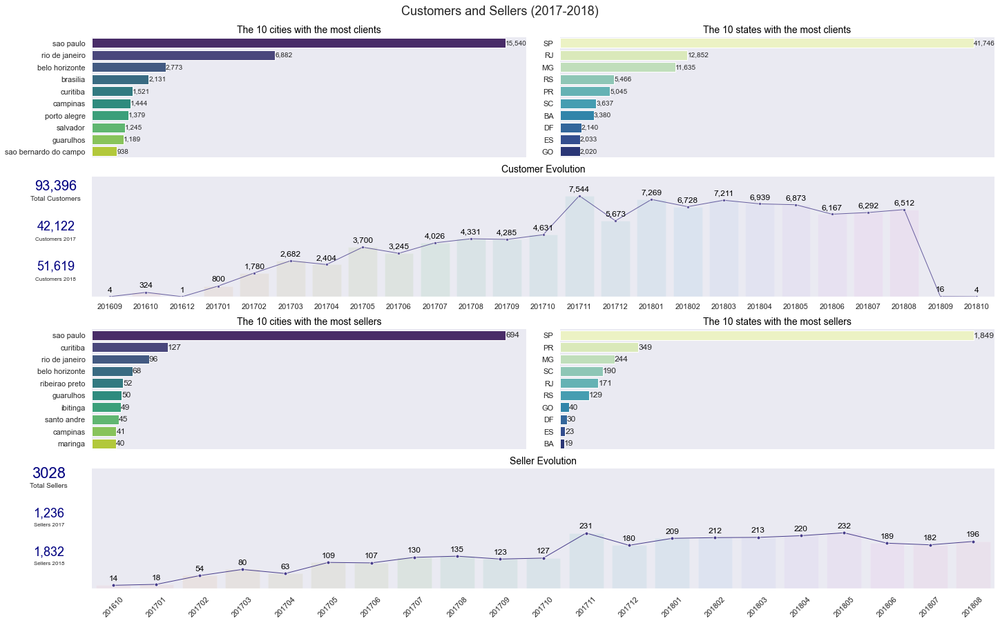

In [184]:
fig = plt.figure(constrained_layout=True, figsize=(20, 15))

# Axis definition
gs = GridSpec(5, 2, figure= fig)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[1, :])
#ax4 = fig.add_subplot(gs[1, 1])
ax5 = fig.add_subplot(gs[2, 0])
ax6 = fig.add_subplot(gs[2, 1])
#ax7 = fig.add_subplot(gs[3, 1])
ax8 = fig.add_subplot(gs[3, :])

#Customer city
sns.barplot(x="total", y="customer_city", data=clients_by_city, ax=ax1, palette='viridis')
ax1.set_title("The 10 cities with the most clients", size=14, color='black')
ax1.set_xlabel("")
ax1.set_ylabel("")
for rect in ax1.patches:
    ax1.annotate('{:,.0f}'.format(rect.get_width()),(rect.get_width(),rect.get_y() + rect.get_height() / 2),
                xytext=(0, 0),textcoords='offset points', va='center', ha='left', size=10)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
ax1.axes.get_xaxis().set_visible(False) 

#Customer states
sns.barplot(x="total", y='customer_state', data=clients_by_state, ax=ax2, palette="YlGnBu")
ax2.set_title("The 10 states with the most clients", size=14, color='black')
ax2.set_xlabel("")
ax2.set_ylabel("")
for rect in ax2.patches:
    ax2.annotate('{:,.0f}'.format(rect.get_width()),(rect.get_width(),rect.get_y() + rect.get_height() / 2),
                xytext=(0, 0),textcoords='offset points', va='center', ha='left', size=10)
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['left'].set_visible(False)
ax2.spines['bottom'].set_visible(False)
ax2.axes.get_xaxis().set_visible(False)

#Customer per year
sns.lineplot(x="Year_Month", y="order_id", data=clients_x_date.groupby("Year_Month").agg({"order_id" : "count"}).reset_index(),ax=ax3, alpha=0.8,
             color='darkslateblue', linewidth=1, marker='o', markersize=4)
sns.barplot(x="Year_Month", y="order_id", data=clients_x_date.groupby("Year_Month").agg({"order_id" : "count"}).reset_index(),ax=ax3, alpha=0.1)
ax3.set_title("Customer Evolution", size=14, color="black")
ax3.set_xlabel("")
ax3.set_ylabel("")
ax3.set_ylim(0,9000)
#plt.setp(ax3.get_xticklabels(), rotation=45)
for p in ax3.patches:
        ax3.annotate('{:,.0f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()),
                    ha="center", va="top", xytext=(0, 15), textcoords="offset points", 
                    color= "black", size=12)
ax3.spines["top"].set_visible(False)
ax3.spines["right"].set_visible(False)
ax3.spines["left"].set_visible(False)
ax3.set_yticklabels([])
ax3.set_yticks([])

#Total de Customers
ax3.text(-1.5, 8000, "93,396", fontsize=20, ha='center', color="navy")
ax3.text(-1.5, 7200, "Total Customers", fontsize=10, ha='center')
ax3.text(-1.5, 5000, "42,122", fontsize=18, ha='center', color="navy")
ax3.text(-1.5, 4200, "Customers 2017", fontsize=8, ha='center')
ax3.text(-1.5, 2000, "51,619", fontsize=18, ha='center', color="navy")
ax3.text(-1.5, 1200, "Customers 2018", fontsize=8, ha='center')

# Sellers city
sns.barplot(x="total", y="seller_city", data=sellers_by_city, ax=ax5, palette='viridis')
ax5.set_title("The 10 cities with the most sellers", size=14, color='black')
ax5.set_xlabel("")
ax5.set_ylabel("")
for rect in ax5.patches:
    ax5.annotate('{:,.0f}'.format(rect.get_width()),(rect.get_width(),rect.get_y() + rect.get_height() / 2),
                xytext=(0, 0),textcoords='offset points', va='center', ha='left', size=12)
ax5.spines['top'].set_visible(False)
ax5.spines['right'].set_visible(False)
ax5.spines['left'].set_visible(False)
ax5.spines['bottom'].set_visible(False)
ax5.axes.get_xaxis().set_visible(False)

# Sellers states
sns.barplot(x="total", y="seller_state", data=sellers_by_states, ax=ax6, palette="YlGnBu")
ax6.set_title("The 10 states with the most sellers", size=14, color='black')
ax6.set_xlabel("")
ax6.set_ylabel("")
for rect in ax6.patches:
    ax6.annotate('{:,.0f}'.format(rect.get_width()),(rect.get_width(),rect.get_y() + rect.get_height() / 2),
                xytext=(0, 0),textcoords='offset points', va='center', ha='left', size=12)
ax6.spines['top'].set_visible(False)
ax6.spines['right'].set_visible(False)
ax6.spines['left'].set_visible(False)
ax6.spines['bottom'].set_visible(False)
ax6.axes.get_xaxis().set_visible(False)

#Sellers per year
sns.lineplot(x="Year_Month", y="order_id", data=sellers_x_date.groupby("Year_Month").agg({"order_id" : "count"}).reset_index(),ax=ax8,
             color='darkslateblue', linewidth=1, marker='o', markersize=5)
sns.barplot(x="Year_Month", y="order_id", data=sellers_x_date.groupby("Year_Month").agg({"order_id" : "count"}).reset_index(),ax=ax8, alpha=0.1)
ax8.set_title("Seller Evolution", size=14, color="black")
ax8.set_xlabel("")
ax8.set_ylabel("")
ax8.set_ylim(0, 500)
plt.setp(ax8.get_xticklabels(), rotation=45)
for p in ax8.patches:
        ax8.annotate('{:,.0f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()),
                    ha="center", va="top", xytext=(0, 15), textcoords="offset points", 
                    color= "black", size=12)
ax8.spines["top"].set_visible(False)
ax8.spines["right"].set_visible(False)
ax8.spines["left"].set_visible(False)
ax8.set_yticklabels([])
ax8.set_yticks([])
        
#Total de Sellers
ax8.text(-1.5, 460, "3028", fontsize=22, ha='center', color="navy")
ax8.text(-1.5, 420, "Total Sellers", fontsize=10, ha='center')
ax8.text(-1.5, 300, "1,236", fontsize=18, ha='center', color="navy")
ax8.text(-1.5, 260, "Sellers 2017", fontsize=8, ha='center')
ax8.text(-1.5, 140, "1,832", fontsize=18, ha='center', color="navy")
ax8.text(-1.5, 100, "Sellers 2018", fontsize=8, ha='center')


plt.suptitle("Customers and Sellers (2017-2018)", size=18)

# plt.tight_layout()


## <span style='color:gray '>Payment Methods </span> 

In [185]:
final_data['payment_type'].unique() # 4 payment method type is available

array(['credit_card', 'voucher', 'boleto', 'debit_card'], dtype=object)

In [186]:
payment_types = final_data['payment_type'].value_counts(ascending=False)
payment_types
# Most used payment type credit card

credit_card    83536
boleto         22029
voucher         6022
debit_card      1623
Name: payment_type, dtype: int64

Text(0, 0.5, 'Order Counts')

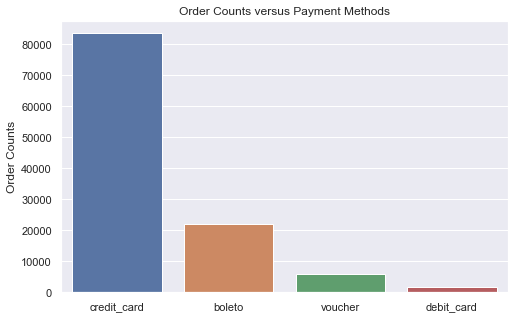

In [187]:
plt.figure(figsize=(8,5))
x = payment_types.index
y = payment_types.values
sns.barplot(x=x,y=y)
plt.title('Order Counts versus Payment Methods')
plt.ylabel('Order Counts')

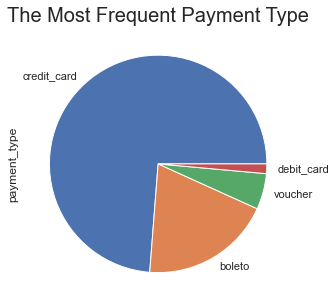

In [188]:
plt.figure(figsize=(10,5))
data['payment_type'].value_counts().plot(kind='pie')
plt.title('The Most Frequent Payment Type'.title() , fontsize=20);

Text(0.5, 1.0, 'Payment type over the years')

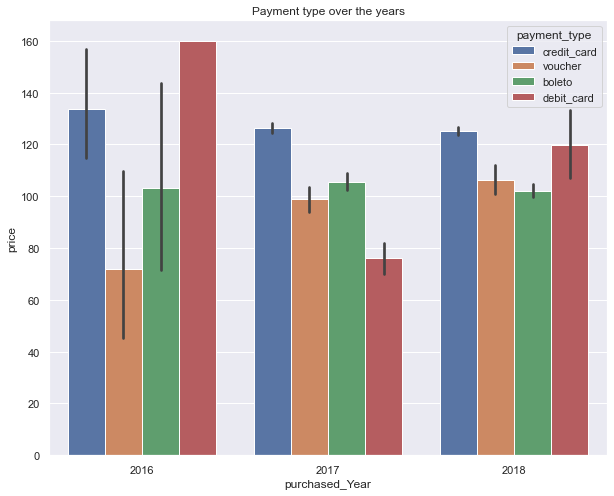

In [189]:
sns.set()
plt.figure(figsize=(10,8))
sns.barplot(x="purchased_Year", y='price', hue="payment_type", data=final_data)
plt.title('Payment type over the years')
# There was an increase in the use of debit cards from 2017 to 2018.
# It almost reached credit card usage. 

In [190]:
order_count = final_data.groupby(['Year_Month','payment_type'])['order_id'].count()
order_count

Year_Month  payment_type
201610      boleto            57
            credit_card      250
            debit_card         1
            voucher           20
201612      credit_card        1
201701      boleto           227
            credit_card      647
            debit_card        10
            voucher           74
201702      boleto           395
            credit_card     1385
            debit_card        14
            voucher          108
201703      boleto           646
            credit_card     2109
            debit_card        36
            voucher          219
201704      boleto           517
            credit_card     1916
            debit_card        26
            voucher          163
201705      boleto           823
            credit_card     3018
            debit_card        37
            voucher          296
201706      boleto           790
            credit_card     2576
            debit_card        28
            voucher          245
201707      boleto

Text(0.5, 1.0, 'Payment methods of prices by month')

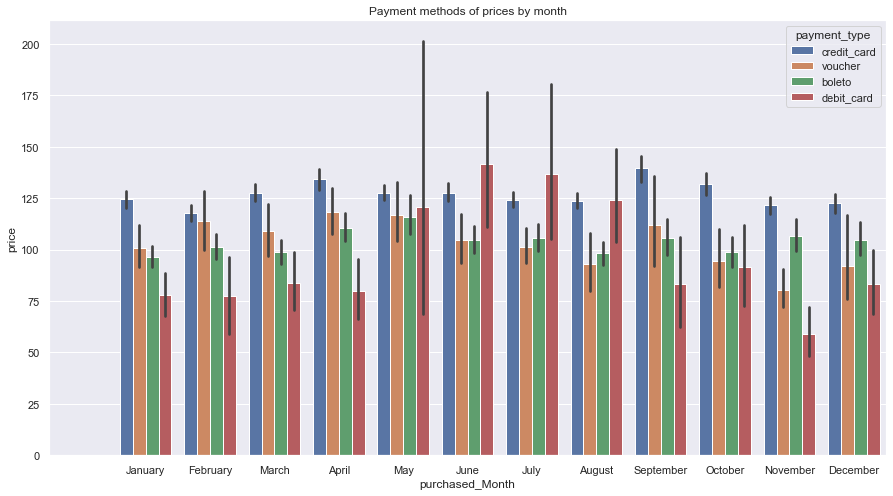

In [191]:
plt.figure(figsize=(15,8))
sns.barplot(x="purchased_Month", y='price', hue="payment_type", data=data)
plt.title('Payment methods of prices by month')
# The amounts used in some months have increased compared to the average prices, 
# and generally large payments from bank cards have not been made.

<AxesSubplot:xlabel='purchased_Day', ylabel='price'>

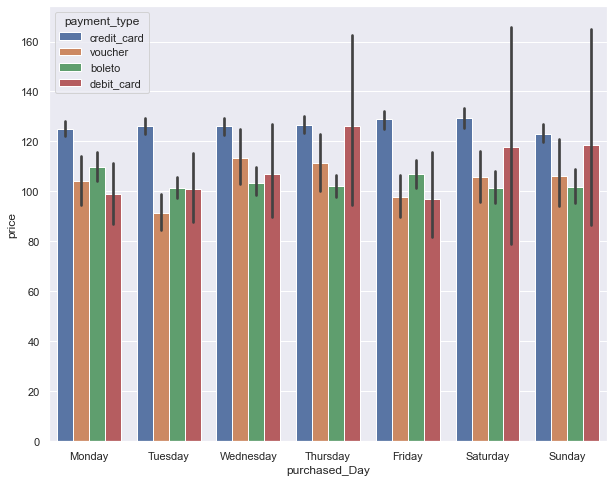

In [192]:
plt.figure(figsize=(10,8))
sns.barplot(x="purchased_Day", y='price', hue="payment_type", data=data)
# Interestingly, on a daily basis, the use of debit cards on Thursday showed values close to the use of credit cards.

In [193]:
price_vs_paymenttype = final_data.groupby('payment_type')['price'].sum()
price_vs_paymenttype

payment_type
boleto         2.284859e+06
credit_card    1.049508e+07
debit_card     1.749152e+05
voucher        6.152878e+05
Name: price, dtype: float64

Text(0, 0.5, 'Price Sum ')

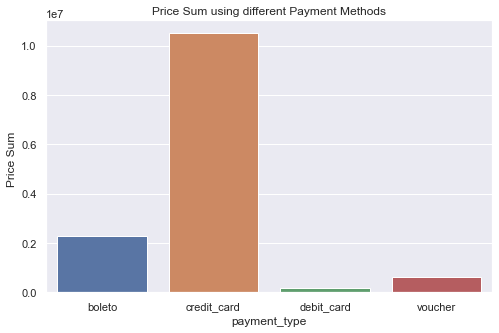

In [194]:
plt.figure(figsize=(8,5))
x = price_vs_paymenttype.index
y = price_vs_paymenttype.values
sns.barplot(x=x,y=y)
plt.title('Price Sum using different Payment Methods')
plt.ylabel('Price Sum ')
# Here, while there is a 4-fold difference between boleto and credit card usage according to the number of orders,
# a 5-fold difference is observed in terms of payment amount.

In [195]:
ordercount_vs_paymenttype = data.groupby('payment_type')['order_id'].count()
ordercount_vs_paymenttype

payment_type
boleto         22510
credit_card    85278
debit_card      1659
voucher         6162
Name: order_id, dtype: int64

<AxesSubplot:xlabel='payment_type'>

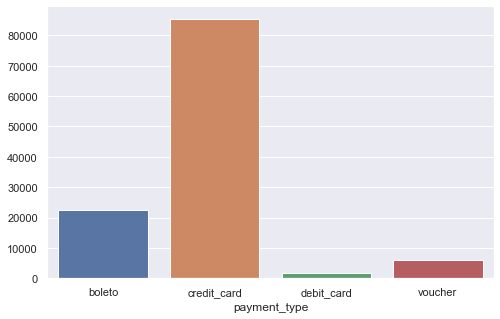

In [196]:
plt.figure(figsize=(8,5))
x = ordercount_vs_paymenttype.index
y = ordercount_vs_paymenttype.values
sns.barplot(x=x,y=y)

<AxesSubplot:xlabel='Year_Month'>

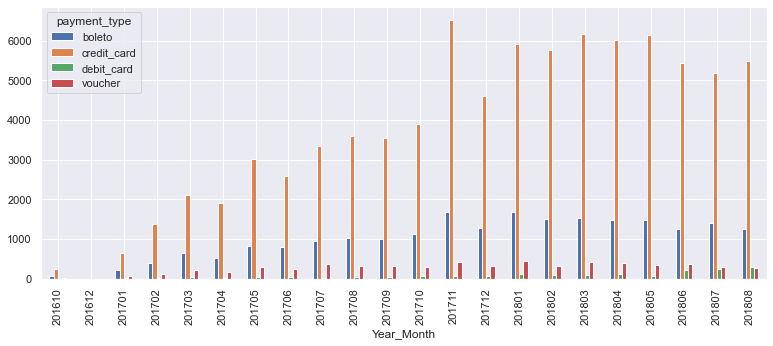

In [203]:
pd.pivot_table(final_data, values='order_id', index=['Year_Month'],
                    columns=['payment_type'], aggfunc='count').plot(kind='bar',figsize=(13,5) )

# Credit card usage stands out in the biggest increase in November.

Text(0.5, 1.0, 'Distribution of orders according to payment methods based on month and year.')

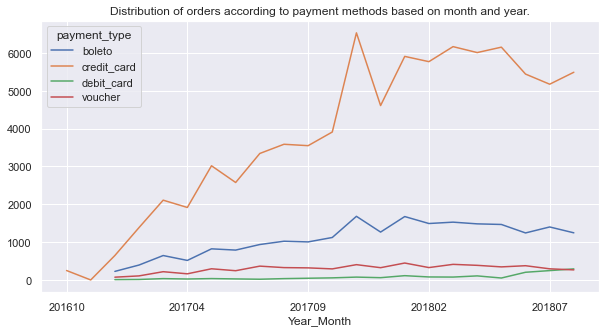

In [205]:
pd.pivot_table(final_data, values='order_id', index=['Year_Month'],
                    columns=['payment_type'], aggfunc='count').sort_values(by='Year_Month').plot(kind='line', figsize=(10,5))
plt.title('Distribution of orders according to payment methods based on month and year.')

## <span style='color:gray '> Payment Sequential  </span> 

In [206]:
final_data.payment_sequential.unique() 

array([ 1,  3,  2,  5,  6,  4,  8,  7, 13, 11, 12, 10,  9, 17, 16, 19, 21,
       18, 15, 20, 14, 22, 26, 25, 24, 23], dtype=int64)

In [207]:
len(final_data.payment_sequential.unique() ) # 26 payment sequentil type is avaliable

26

In [208]:
# Here we can see when payment type is vocuher sequential takes a lot of values.
pivot = final_data.pivot_table(index ='payment_type',
                       values =['order_id'], columns=['payment_sequential'],
                       aggfunc ='count',fill_value=0)

pivot
# it can be seen that when payment type voucher, payment sequential can take bigger values.

order_id                                                    \
payment_sequential       1     2    3    4    5    6   7   8   9   10  11  12   
payment_type                                                                    
boleto                22028     1    0    0    0    0   0   0   0   0   0   0   
credit_card           83181   355    0    0    0    0   0   0   0   0   0   0   
debit_card             1572    50    1    0    0    0   0   0   0   0   0   0   
voucher                1590  2833  626  303  180  124  85  55  44  38  34  26   

                                                                 
payment_sequential  13  14  15 16 17 18 19 20 21 22 23 24 25 26  
payment_type                                                     
boleto               0   0   0  0  0  0  0  0  0  0  0  0  0  0  
credit_card          0   0   0  0  0  0  0  0  0  0  0  0  0  0  
debit_card           0   0   0  0  0  0  0  0  0  0  0  0  0  0  
voucher             14  12  10  8  8  8  8  5  5  2  1  1  1  1

<Figure size 2500x1000 with 0 Axes>

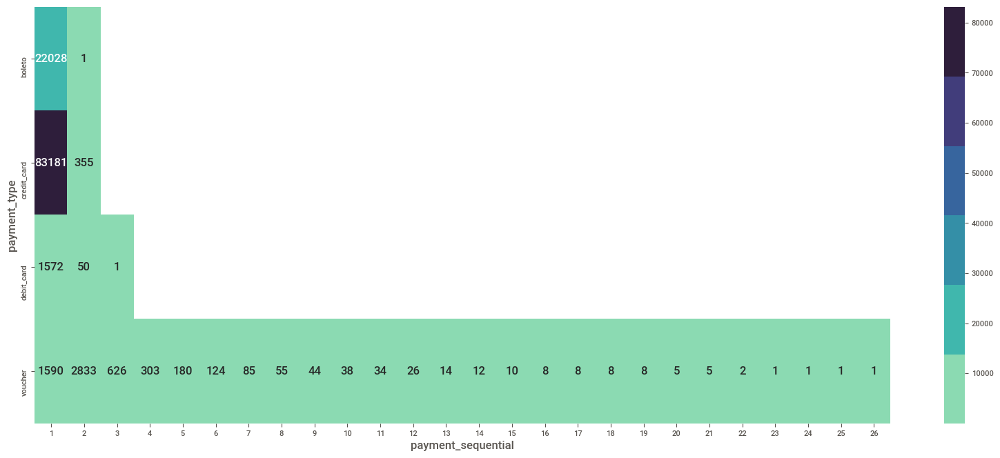

<Figure size 2500x1000 with 0 Axes>

In [494]:
palette = sns.color_palette("mako_r", 6)
payment=pd.crosstab(index=final_data['payment_type'], columns=final_data['payment_sequential'], values=final_data['order_id'],  aggfunc='count').round(0)
sns.heatmap(payment, cmap=palette, annot=True, fmt='g');
plt.figure(figsize=(25,10))

In [209]:
len(final_data[final_data['payment_type']=='voucher'].groupby('product_category')['product_category'].unique())
#.count()

65

In [210]:
final_data[final_data['payment_type']=='voucher'].groupby('product_category')['product_category'].count().sort_values(ascending=False)
# voucher can be used a lot of categories

product_category
bed_bath_table                             838
furniture_decor                            517
housewares                                 486
sports_leisure                             404
health_beauty                              369
computers_accessories                      340
watches_gifts                              250
garden_tools                               236
cool_stuff                                 236
perfumery                                  226
telephony                                  215
toys                                       197
auto                                       189
baby                                       172
fashion_bags_accessories                   166
stationery                                 132
pet_shop                                   102
electronics                                 99
luggage_accessories                         93
office_furniture                            88
consoles_games                             

In [211]:
len(final_data[final_data['payment_type']=='debit_card'].groupby('product_category')['product_category'].unique())

56

In [212]:
len(final_data[final_data['payment_type']=='boleto'].groupby('product_category')['product_category'].unique())

71

Different payment types can be used a lot of categories that is no category-specific payment types

## <span style='color:gray '> Payment Installments  </span> 

In [213]:
final_data.payment_installments.nunique()

24

In [214]:
install_order =final_data[final_data['payment_type']=='credit_card'].groupby('payment_installments')['order_id'].count()
install_order

payment_installments
0         3
1     26744
2     13150
3     11316
4      7696
5      5812
6      4452
7      1739
8      4878
9       695
10     6634
11       22
12      161
13       18
14       15
15       88
16        7
17        7
18       38
20       19
21        6
22        1
23        1
24       34
Name: order_id, dtype: int64

Text(0.5, 1.0, 'Order Counts versus Payment Installments')

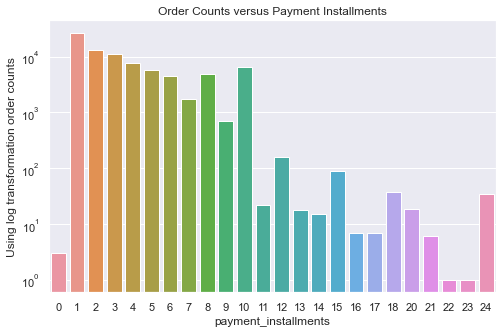

In [215]:
plt.figure(figsize=(8,5))
plt.yscale('log')
x = install_order.index
y = install_order.values
sns.barplot(x=x,y=y)
plt.ylabel('Using log transformation order counts')
plt.title('Order Counts versus Payment Installments')

In [216]:
data[data['payment_installments']==0]
# I didn't understand what does 0 payment installments mean

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,zip_code_prefix,seller_city,seller_state,product_category,review_id,review_score,purchased_Year,purchased_Month,purchased_Day,Day,Season,SeasonName
3208,1a57108394169c0b47d8f876acc9ba2d,48ebb06cf56dba9d009230cc751bb195,delivered,2018-05-15 16:25:14,2018-05-15 16:36:52,2018-05-17 12:37:00,2018-05-24 15:45:41,2018-06-06,2,credit_card,0,129.94,9925e1d7dff0d807355599dee04830ab,44001,feira de santana,BA,1,db35a562fb6ba63e19fa42a15349dc04,282f23a9769b2690c5dda22e316f9941,2018-05-18 16:31:54,41.69,23.28,31573,belo horizonte,MG,housewares,bc5dca6c957c328b1cbff760b0841fd2,5,2018,May,Tuesday,15,2,Autumn
3209,1a57108394169c0b47d8f876acc9ba2d,48ebb06cf56dba9d009230cc751bb195,delivered,2018-05-15 16:25:14,2018-05-15 16:36:52,2018-05-17 12:37:00,2018-05-24 15:45:41,2018-06-06,2,credit_card,0,129.94,9925e1d7dff0d807355599dee04830ab,44001,feira de santana,BA,2,db35a562fb6ba63e19fa42a15349dc04,282f23a9769b2690c5dda22e316f9941,2018-05-18 16:31:54,41.69,23.28,31573,belo horizonte,MG,housewares,bc5dca6c957c328b1cbff760b0841fd2,5,2018,May,Tuesday,15,2,Autumn
77751,744bade1fcf9ff3f31d860ace076d422,5e5794daaa13f73e2f1cdb4114529843,delivered,2018-04-22 11:34:42,2018-04-24 19:04:46,2018-04-24 03:14:34,2018-04-27 20:55:28,2018-05-16,2,credit_card,0,58.69,f54cea27c80dc09bfe07b1cf1e01b845,5263,sao paulo,SP,1,0cf573090c66bb30ac5e53c82bdb0403,7202e2ba20579a9bd1acb29e61fe71f6,2018-04-26 12:31:06,45.90,12.79,14401,franca,SP,telephony,c56b4b7042f417e70d3dc5340deb23fe,5,2018,April,Sunday,22,2,Autumn


In [217]:
data.payment_installments.unique()

array([ 1,  3,  8,  4,  2,  9,  6,  7,  5, 10, 11, 15, 12,  0, 17, 20, 13,
       24, 18, 14, 16, 22, 21, 23], dtype=int64)

In [218]:
data['payment_installments'].describe()

count    115609.000000
mean          2.946233
std           2.781087
min           0.000000
25%           1.000000
50%           2.000000
75%           4.000000
max          24.000000
Name: payment_installments, dtype: float64

In [219]:
installment = final_data.groupby('payment_installments')['price'].sum().sort_values(ascending=False)
installment

payment_installments
1     5.102254e+06
10    1.913126e+06
2     1.275990e+06
3     1.218557e+06
8     1.150231e+06
4     9.666284e+05
5     7.993081e+05
6     6.904620e+05
7     2.494325e+05
9     1.033980e+05
12    3.525454e+04
15    2.510454e+04
18    1.230787e+04
24    9.971560e+03
20    8.226160e+03
14    2.151190e+03
11    2.078450e+03
13    2.000390e+03
16    1.298800e+03
17    1.048220e+03
21    7.547000e+02
23    2.160000e+02
22    2.099900e+02
0     1.292800e+02
Name: price, dtype: float64

Text(0.5, 1.0, 'Price Sum versus Payment Installments')

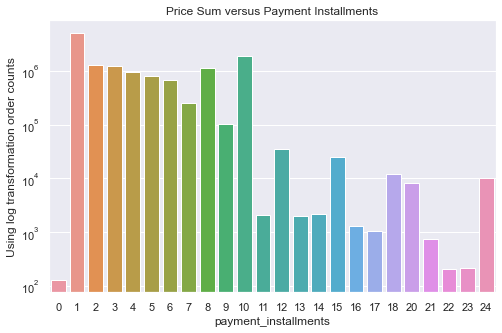

In [220]:
plt.figure(figsize=(8,5))
x = installment.index
plt.yscale('log')
y = installment.values
sns.barplot(x=x,y=y)
plt.ylabel('Using log transformation order counts')
plt.title('Price Sum versus Payment Installments')


Text(0.5, 1.0, 'Boxplot of the payment installments')

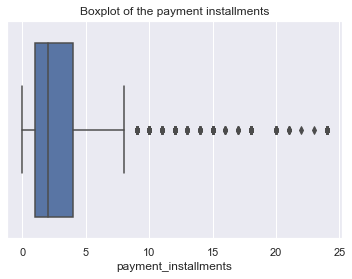

In [221]:
sns.boxplot(x=data['payment_installments'])
plt.title('Boxplot of the payment installments')

In [222]:
data.groupby('payment_installments')['payment_installments'].count().sort_values(ascending=False)

payment_installments
1     57599
2     13404
3     11551
4      7855
10     6785
5      5928
8      5013
6      4546
7      1789
9       710
12      164
15       91
18       38
24       34
11       22
20       20
13       19
14       16
16        7
17        7
21        6
0         3
22        1
23        1
Name: payment_installments, dtype: int64

In [224]:
pivot = data.pivot_table(index =None,
                       values =['order_id'], columns=['payment_installments'],
                       aggfunc ='count',fill_value=0)

pivot

payment_installments,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,20,21,22,23,24
order_id,3,57599,13404,11551,7855,5928,4546,1789,5013,710,6785,22,164,19,16,91,7,7,38,20,6,1,1,34


<AxesSubplot:xlabel='payment_installments'>

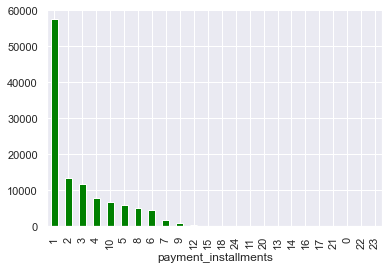

In [225]:
data.groupby('payment_installments')['payment_installments'].count().sort_values(ascending=False).plot(kind='bar', color='green')

<AxesSubplot:xlabel='payment_installments'>

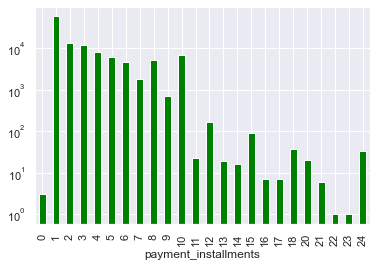

In [226]:
plt.yscale('log')
data.groupby('payment_installments')['payment_installments'].count().plot(kind='bar', color='green')

In [227]:
len(final_data[final_data['payment_installments']<5])

88583

In [228]:
len(final_data[(final_data['payment_installments']>=10) & (data['payment_installments']<=15)])

6938

In [229]:
len(final_data[final_data['payment_installments']>15])

113

<AxesSubplot:xlabel='payment_installments', ylabel='price'>

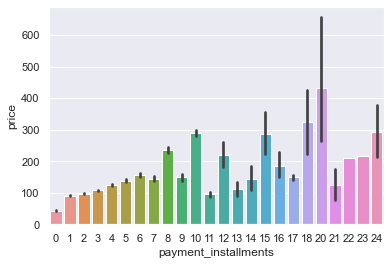

In [230]:
sns.barplot(x='payment_installments', y='price', data=final_data)

Brazilians mostly shopped with one shot, followed by 2, 3 and 4 installments.
It seems to have been seen in the case of an increase in the amount of 10 installments.

In [232]:
np.corrcoef(final_data['payment_installments'], final_data['price']) # it has 0.27 correlated, not that much.

array([[1.       , 0.2798469],
       [0.2798469, 1.       ]])

## <span style='color:gray '> Geolocation </span> 

In [236]:
import os
import conda

conda_file_dir = conda.__file__
conda_dir = conda_file_dir.split('lib')[0]
proj_lib = os.path.join(os.path.join(conda_dir, 'share'), 'proj')
os.environ["PROJ_LIB"] = proj_lib
from mpl_toolkits.basemap import Basemap

In [237]:
geolocation = pd.read_csv('olist_geolocation_dataset.csv')
geolocation.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


In [238]:
geolocation.groupby('geolocation_city')['geolocation_city'].count().sort_values(ascending=False)

geolocation_city
sao paulo             135800
rio de janeiro         62151
belo horizonte         27805
são paulo              24918
curitiba               16593
                       ...  
serra dos dourados         1
guaxima                    1
guia de pacobaíba          1
serra da tapuia            1
* cidade                   1
Name: geolocation_city, Length: 8011, dtype: int64

Text(0.5, 1.0, 'Distribution of orders by States')

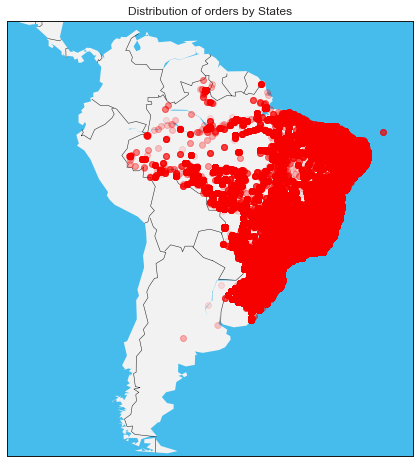

In [239]:
lat = geolocation['geolocation_lat']
lon = geolocation['geolocation_lng']

plt.figure(figsize=(8,8))

m = Basemap(llcrnrlat=-55.401805,llcrnrlon=-92.269176,urcrnrlat=13.884615,urcrnrlon=-27.581676)
m.bluemarble()
m.drawmapboundary(fill_color='#46bcec')
m.fillcontinents(color='#f2f2f2',lake_color='#46bcec') 
#m.drawcoastlines()
m.drawcountries()
m.scatter(lon, lat,zorder=8,alpha=0.1,color='red')
plt.title('Distribution of orders by States')

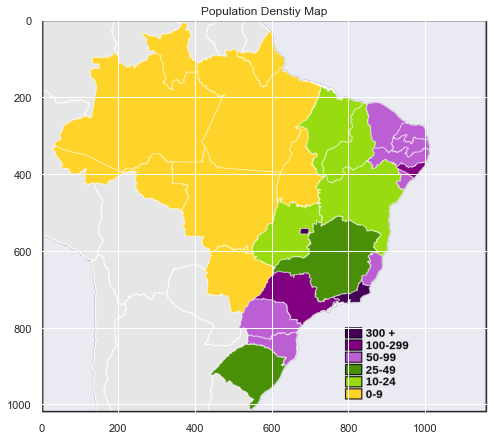

In [240]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
plt.figure(figsize=(8,8))
img = mpimg.imread('Brazilian_States_by_Population_density.svg.png')
plt.imshow(img)
plt.title('Population Denstiy Map')
plt.show()
#

Places with high population density and high number of orders in Brazil are similar cities

## <span style='color:gray '> Customer States & Seller States </span> 

In [241]:
data['seller_state'].describe()

count     115609
unique        23
top           SP
freq       82417
Name: seller_state, dtype: object

In [242]:
seller_states = final_data.groupby('seller_state')['order_id'].count().sort_values(ascending=False)
seller_states

seller_state
SP    80744
MG     8794
PR     8758
RJ     4775
SC     4148
RS     2195
DF      920
BA      679
GO      527
PE      459
MA      400
ES      366
MT      146
CE       99
MS       59
RN       56
PB       39
RO       14
PI       11
SE       10
PA        8
AM        3
Name: order_id, dtype: int64

Text(0.5, 1.0, 'Seller States')

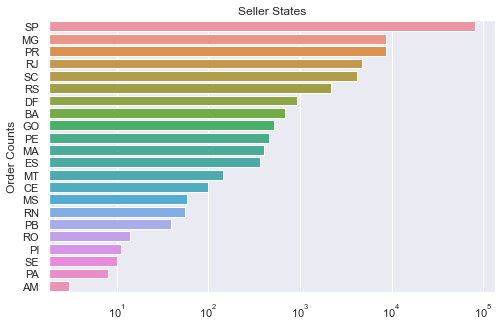

In [243]:
plt.figure(figsize=(8,5))
y = seller_states.index
plt.xscale('log')
x = seller_states.values
sns.barplot(x=x,y=y)
plt.ylabel('Order Counts')
plt.title('Seller States')


In [253]:
data['customer_state'].describe()

count     115609
unique        27
top           SP
freq       48797
Name: customer_state, dtype: object

In [244]:
final_data['customer_state'].unique()

array(['SP', 'SC', 'AM', 'MA', 'ES', 'MG', 'RS', 'PR', 'RJ', 'PE', 'RO',
       'DF', 'MS', 'BA', 'PA', 'PB', 'AP', 'SE', 'GO', 'CE', 'PI', 'RN',
       'MT', 'AL', 'TO', 'AC', 'RR'], dtype=object)

In [245]:
# Here I looked at the order counts in non-seller states
final_data[(final_data['seller_state']=='TO') |(final_data['seller_state']=='AL')| (final_data['seller_state']=='PE') | (final_data['seller_state']=='AP') ]['order_id'].count()

459

In [247]:
final_data[(final_data['seller_state']=='TO') |(final_data['seller_state']=='AL')| (final_data['seller_state']=='PE') | (final_data['seller_state']=='AP') & (final_data['seller_state']!='RR') ]['product_category'].unique()

array(['housewares', 'cool_stuff', 'sports_leisure', 'toys',
       'furniture_decor', 'health_beauty', 'auto', 'watches_gifts',
       'computers_accessories', 'audio', 'telephony', 'consoles_games',
       'home_confort'], dtype=object)

In [246]:
# Here I looked at the order counts in seller states
final_data[(final_data['seller_state']=='TO') |(final_data['seller_state']!='AL') & (final_data['seller_state']!='PE') & (final_data['seller_state']!='AP') ]['order_id'].count()

112751

In [248]:
final_data[(final_data['seller_state']!='TO') |(final_data['seller_state']!='AL') & (final_data['seller_state']!='PE') & (final_data['seller_state']!='AP') & (final_data['seller_state']!='RR')]['freight_value'].mean()

20.002576715840238

In [249]:
final_data[((final_data['product_category']=='housewares')| (final_data['product_category']=='cool_stuff') | (final_data['product_category']=='sports_leisure')| (final_data['product_category']=='toys')| (final_data['product_category']=='furniture_decor')|(final_data['product_category']=='watches_gifts')| (final_data['product_category']=='computers_accessories')|(final_data['product_category']=='consoles_games')| (final_data['product_category']=='health_beauty') | (final_data['product_category']=='auto')| (final_data['product_category']=='home_confort')) & (final_data['seller_state']=='TO') |(final_data['seller_state']!='AL') & (final_data['seller_state']!='PE') & (final_data['seller_state']!='AP') ]['freight_value'].mean()

19.97182827646994

In [250]:
final_data[(final_data['seller_state']=='TO') |(final_data['seller_state']=='AL')| (final_data['seller_state']=='PE') | (final_data['seller_state']=='AP') | (final_data['seller_state']=='RR')]['freight_value'].mean()

27.555773420479373

In [251]:
final_data[final_data['seller_state']=='AM']['freight_value']

78948    25.29
78949    35.26
78950    21.25
Name: freight_value, dtype: float64

In [254]:
Customer_State = final_data.groupby('customer_state')['order_id'].size().sort_values(ascending=False)
Customer_State

customer_state
SP    47822
RJ    14566
MG    13218
RS     6314
PR     5790
SC     4142
BA     3844
DF     2397
GO     2305
ES     2268
PE     1795
CE     1481
MT     1060
PA     1056
MS      837
MA      808
PB      605
RN      553
PI      541
AL      438
SE      382
TO      329
RO      274
AM      167
AC       92
AP       82
RR       44
Name: order_id, dtype: int64

In [255]:
len(Customer_State)

27

In [256]:
len(seller_states)

22

Text(0.5, 1.0, 'Customer States')

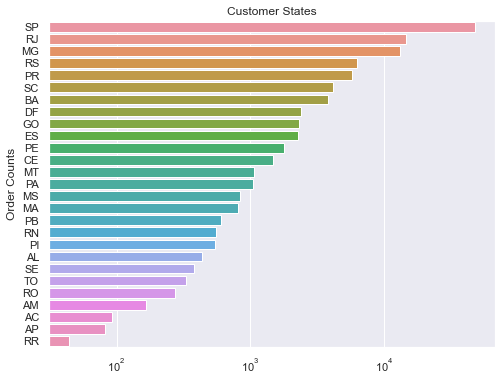

In [257]:
plt.figure(figsize=(8,6))
y = Customer_State.index
plt.xscale('log')
x = Customer_State.values
sns.barplot(x=x,y=y)
plt.ylabel('Order Counts')
plt.title('Customer States')


Text(0.5, 1.0, 'Customer States Sales')

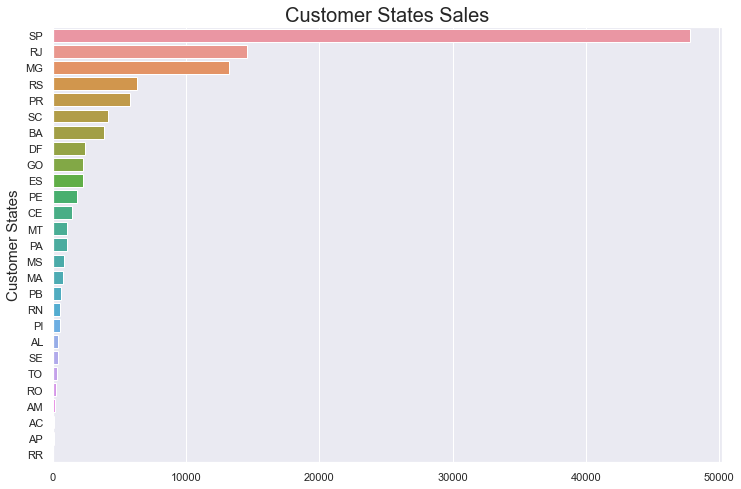

In [258]:
plt.figure(figsize=(12,8))
sns.set_style("darkgrid")
sns.barplot(y=Customer_State.index, x=Customer_State.values)
plt.ylabel('Customer States', fontsize=15 )
plt.title("Customer States Sales", fontsize=20)

In [259]:
data.groupby('customer_state')['price'].mean().sort_values(ascending=False)

customer_state
PB    190.589176
AC    182.715484
AL    178.664945
TO    167.177237
RN    166.547054
RO    166.152222
AP    163.956627
PI    161.470481
PA    158.273922
CE    154.178304
MT    152.929123
SE    152.369084
RR    151.669000
MA    145.190060
MS    142.583089
PE    142.559833
BA    134.572618
AM    131.598036
GO    127.293001
DF    127.128955
RJ    124.606432
SC    123.955920
RS    121.529850
MG    119.946637
PR    118.663179
ES    117.787422
SP    109.996537
Name: price, dtype: float64

In [260]:
# States of sale and average sales, maximum values, etc.
data.groupby(by='customer_state')[['payment_value']].agg(['sum','mean','median']).sort_values(by=('payment_value','sum'),ascending=False)[0:15]

payment_value                     
                         sum        mean   median
customer_state                                   
SP                7502926.95  153.757955   97.510
RJ                2708839.33  180.745935  114.440
MG                2288949.71  170.448262  112.490
RS                1131899.22  176.500736  115.370
PR                1055747.81  179.579488  110.070
BA                 780334.54  197.953968  117.945
SC                 769744.94  182.490503  116.945
GO                 459466.06  194.771539  116.570
DF                 430126.51  175.633528  114.350
ES                 390840.58  169.930687  110.540
PE                 368309.23  198.978514  133.050
CE                 337096.92  220.757642  134.940
MT                 253916.03  229.580497  129.160
PA                 241870.17  223.746688  147.130
MA                 195954.74  235.522524  138.120

In [261]:
Pivot= pd.pivot_table(data, values='price', index=['product_category'],
                    columns=['customer_state'], aggfunc=np.mean, fill_value=0)

In [262]:
# function to indicate some values with colors
def add_color(val):
  if val <10 :
    color = 'black'
  elif val < 100:
    color = 'gray'
  elif val < 500:
    color = 'green'
  elif val < 1000:
    color='purple'
  else:
    color='red'
    
  return 'color: %s' % color

In [263]:
Pivot.style.highlight_null(null_color='gray')

customer_state,AC,AL,AM,AP,BA,CE,DF,ES,GO,MA,MG,MS,MT,PA,PB,PE,PI,PR,RJ,RN,RO,RR,RS,SC,SE,SP,TO
product_category,,,,,,,,,,,,,,,,,,,,,,,,,,,
agro_industry_and_commerce,0.000000,1476.300000,0.000000,589.990000,451.400000,75.483333,0.000000,221.150000,328.341429,559.990000,593.954091,175.630000,265.000000,554.990000,264.495000,1122.384000,106.326667,408.627500,214.564545,0.000000,22.000000,0.000000,350.658889,356.660000,0.000000,300.110593,0.000000
air_conditioning,0.000000,540.000000,89.000000,0.000000,138.810000,223.080000,156.000000,142.180000,134.412857,199.000000,214.524286,0.000000,117.160000,0.000000,35.900000,138.450000,156.300000,264.737857,238.755882,0.000000,0.000000,0.000000,113.479333,149.900000,0.000000,166.120580,0.000000
art,0.000000,0.000000,58.350000,99.990000,89.895000,0.000000,94.298333,49.900000,102.392500,0.000000,75.870526,129.990000,69.990000,84.945000,110.990000,110.990000,110.990000,78.980000,91.511143,79.990000,74.320000,0.000000,67.937778,70.365000,0.000000,143.268381,0.000000
arts_and_craftmanship,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,129.490000,0.000000,0.000000,0.000000,81.463333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,289.490000,0.000000,56.640625,0.000000
audio,0.000000,80.025000,89.900000,0.000000,102.192143,160.315000,128.014375,85.555714,282.125714,244.626667,153.429459,190.900000,167.950000,568.000000,79.000000,110.447500,51.920000,151.114211,169.143051,189.000000,0.000000,0.000000,143.300000,156.038333,0.000000,120.347200,175.000000
auto,121.394000,160.887619,120.650000,405.463333,189.462346,231.073607,154.761416,158.230330,118.208125,133.889268,140.179702,274.717308,200.957541,149.086226,174.450800,143.102874,291.702286,119.718870,146.825611,215.829000,138.916000,219.900000,141.058410,140.579409,113.041905,122.870499,151.177500
baby,232.613333,104.110000,131.538000,0.000000,148.995238,143.695000,126.860435,135.010484,166.903548,195.380741,127.376208,148.716774,195.403611,222.281111,154.043846,115.936190,357.757500,132.815868,117.044920,377.108182,201.308182,494.435000,142.700091,141.225398,180.936250,125.919864,311.375714
bed_bath_table,141.925000,105.586316,87.900000,111.583333,96.840220,82.080787,77.575864,99.342490,97.233834,107.580750,97.736472,86.898649,101.549857,88.366905,105.140313,101.907717,105.722727,98.696839,90.702993,104.677647,115.484667,203.233333,94.537556,94.740086,120.811333,90.051613,101.083000
books_general_interest,316.900000,30.500000,87.000000,0.000000,64.914286,234.743750,72.020526,144.986364,137.506000,99.666667,83.973019,115.500000,22.250000,35.280000,36.938000,80.385000,133.900000,82.425000,74.495614,53.059259,44.990000,0.000000,89.578333,86.000800,135.000000,84.133799,32.900000


In [264]:
Pivot.style.applymap(add_color, 
                    subset=["AC","AL","AM","AP","BA", "CE", "DF","ES","GO","MA", "MG","MS","MT","PA","PB","PE","PI","PR","RJ","RN","RO","RR","RS","SC","SE","SP","TO"])

customer_state,AC,AL,AM,AP,BA,CE,DF,ES,GO,MA,MG,MS,MT,PA,PB,PE,PI,PR,RJ,RN,RO,RR,RS,SC,SE,SP,TO
product_category,,,,,,,,,,,,,,,,,,,,,,,,,,,
agro_industry_and_commerce,0.000000,1476.300000,0.000000,589.990000,451.400000,75.483333,0.000000,221.150000,328.341429,559.990000,593.954091,175.630000,265.000000,554.990000,264.495000,1122.384000,106.326667,408.627500,214.564545,0.000000,22.000000,0.000000,350.658889,356.660000,0.000000,300.110593,0.000000
air_conditioning,0.000000,540.000000,89.000000,0.000000,138.810000,223.080000,156.000000,142.180000,134.412857,199.000000,214.524286,0.000000,117.160000,0.000000,35.900000,138.450000,156.300000,264.737857,238.755882,0.000000,0.000000,0.000000,113.479333,149.900000,0.000000,166.120580,0.000000
art,0.000000,0.000000,58.350000,99.990000,89.895000,0.000000,94.298333,49.900000,102.392500,0.000000,75.870526,129.990000,69.990000,84.945000,110.990000,110.990000,110.990000,78.980000,91.511143,79.990000,74.320000,0.000000,67.937778,70.365000,0.000000,143.268381,0.000000
arts_and_craftmanship,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,129.490000,0.000000,0.000000,0.000000,81.463333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,289.490000,0.000000,56.640625,0.000000
audio,0.000000,80.025000,89.900000,0.000000,102.192143,160.315000,128.014375,85.555714,282.125714,244.626667,153.429459,190.900000,167.950000,568.000000,79.000000,110.447500,51.920000,151.114211,169.143051,189.000000,0.000000,0.000000,143.300000,156.038333,0.000000,120.347200,175.000000
auto,121.394000,160.887619,120.650000,405.463333,189.462346,231.073607,154.761416,158.230330,118.208125,133.889268,140.179702,274.717308,200.957541,149.086226,174.450800,143.102874,291.702286,119.718870,146.825611,215.829000,138.916000,219.900000,141.058410,140.579409,113.041905,122.870499,151.177500
baby,232.613333,104.110000,131.538000,0.000000,148.995238,143.695000,126.860435,135.010484,166.903548,195.380741,127.376208,148.716774,195.403611,222.281111,154.043846,115.936190,357.757500,132.815868,117.044920,377.108182,201.308182,494.435000,142.700091,141.225398,180.936250,125.919864,311.375714
bed_bath_table,141.925000,105.586316,87.900000,111.583333,96.840220,82.080787,77.575864,99.342490,97.233834,107.580750,97.736472,86.898649,101.549857,88.366905,105.140313,101.907717,105.722727,98.696839,90.702993,104.677647,115.484667,203.233333,94.537556,94.740086,120.811333,90.051613,101.083000
books_general_interest,316.900000,30.500000,87.000000,0.000000,64.914286,234.743750,72.020526,144.986364,137.506000,99.666667,83.973019,115.500000,22.250000,35.280000,36.938000,80.385000,133.900000,82.425000,74.495614,53.059259,44.990000,0.000000,89.578333,86.000800,135.000000,84.133799,32.900000


In [265]:
data['seller_city'].describe()

count        115609
unique          604
top       sao paulo
freq          28811
Name: seller_city, dtype: object

In [266]:
data['customer_city'].describe()

count        115609
unique         4093
top       sao paulo
freq          18267
Name: customer_city, dtype: object

* São Paulo, Brazil’s vibrant financial center, is among the world's most populous cities, with numerous cultural institutions and a rich architectural tradition.

## <span style='color:gray '> Review Scores </span> 

In [267]:
data.review_score.unique() # from 1 to 5

array([4, 5, 3, 1, 2], dtype=int64)

In [268]:
data.groupby('review_score')['review_score'].count().sort_values(ascending=False)  # High rate of 5 score

review_score
5    65374
4    21951
1    14546
3     9718
2     4020
Name: review_score, dtype: int64

Text(0.5, 1.0, 'Review Scores')

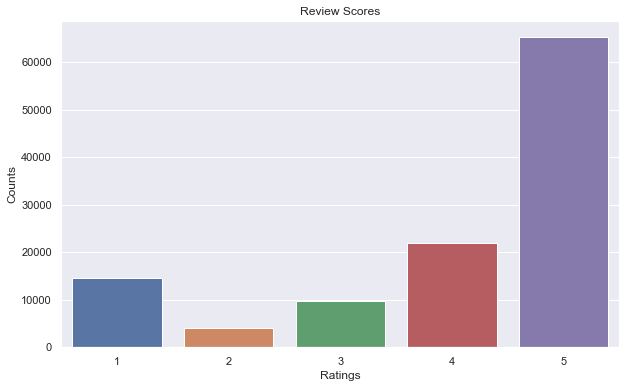

In [269]:
plt.figure(figsize=(10,6))
sns.barplot(x=data['review_score'].value_counts().index,y=data['review_score'].value_counts().values)
plt.xlabel('Ratings')
plt.ylabel('Counts')
plt.title('Review Scores')

<AxesSubplot:>

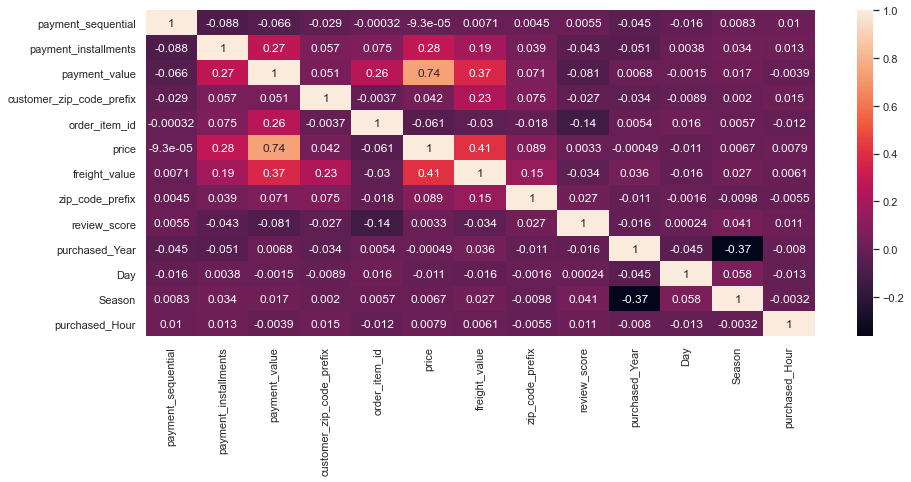

In [271]:
# I looked here if there is a correlation between review score and delivery time but I dind't find higher correlations
plt.figure(figsize=(15,6))
corr = final_data.corr()
sns.heatmap(corr, annot=True)
# I looked for correlations on the data

In [272]:
import scipy

In [274]:
# correlations between price and 
np.corrcoef(final_data['freight_value'], final_data['price']) # there is a high correlation here, when price is increase freight value also increases

array([[1.        , 0.41272072],
       [0.41272072, 1.        ]])

In [275]:
scipy.stats.pearsonr(final_data['freight_value'], final_data['price'])

(0.41272071860775106, 0.0)

* Review Scores versus Product Categories

In [276]:
product_reviews_mean = final_data.groupby('product_category').mean()['review_score'].reset_index()
product_reviews_mean.sort_values(by='review_score').reset_index()

,index,product_category,review_score
0,61,security_and_services,2.500000
1,23,diapers_and_hygiene,3.378378
2,57,office_furniture,3.553204
3,46,home_comfort_2,3.642857
4,30,fashion_male_clothing,3.649635
5,34,fixed_telephony,3.756757
6,4,audio,3.845333
7,41,furniture_mattress_and_upholstery,3.875000
8,58,party_supplies,3.911111
9,7,bed_bath_table,3.915276


Text(0.5, 1.0, 'Delivery Time versus review scores')

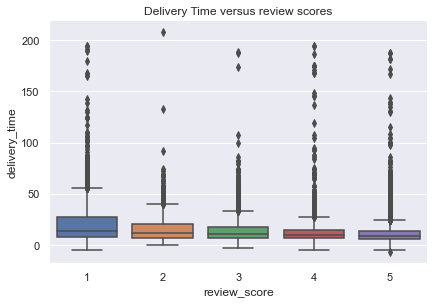

In [280]:
df = final_data.copy() # not to have new column in the final data

df['delivery_time'] = (df['order_delivered_customer_date'] - df['order_approved_at']).dt.total_seconds() / 86400
ax = sns.catplot(x="review_score", y="delivery_time", kind="box",
                 data= df, height=4, aspect=1.5)
plt.title('Delivery Time versus review scores')
# I looked if there is correlation between review score and delivery time 
# here I thought that when delivery time decreases score increase but in the heatmap I didn't find a valuable correlation

In [283]:
final_data[final_data['review_score']==1]['product_category'].nunique() # when score is 1 it can be seen almost all categories

69

In [284]:
final_data[final_data['review_score']==2]['product_category'].nunique()

62

In [285]:
final_data[final_data['review_score']==3]['product_category'].nunique()

68

In [286]:
final_data[final_data['review_score']==4]['product_category'].nunique()

70

In [287]:
final_data[final_data['review_score']==5]['product_category'].nunique()

70

Here I looked to see if the scores are specific to some categories or are seen in every category, almost every category is seen in the score values.

In [ ]:
#scores[scores>4.5].count()

In [288]:
(final_data['order_delivered_customer_date']-final_data['order_purchase_timestamp']).describe()

count                        113202
mean     12 days 10:36:09.042914436
std       9 days 08:32:12.271096955
min                 0 days 12:48:07
25%                 6 days 17:43:59
50%         10 days 04:31:20.500000
75%                15 days 12:04:39
max               208 days 08:26:32
dtype: object

In [289]:
#While it reaches the customer in an average of 12 days in normal times, it reaches the customer in 18 days in those with score 1 
score_1_2 = final_data[(final_data['review_score']==1) | (final_data['review_score']==2)]
(score_1_2['order_delivered_customer_date'] - score_1_2['order_purchase_timestamp']).mean()

Timedelta('18 days 17:13:06.721214298')

In [290]:
score_3= final_data[(final_data['review_score']==3)]
(score_3['order_delivered_customer_date'] - score_3['order_purchase_timestamp']).mean()

Timedelta('14 days 00:42:25.469946501')

In [291]:
score_4_5 = final_data[(final_data['review_score']==4) | (final_data['review_score']==5)]
(score_4_5['order_delivered_customer_date'] - score_4_5['order_purchase_timestamp']).mean()

Timedelta('11 days 01:30:07.048569589')

Here, as the score increases, there is a decrease in the average delivery date.

In [292]:
seller_scores = pd.pivot_table(final_data, values='review_score', index='seller_id', columns=None, aggfunc='mean', fill_value=0, margins=False, dropna=False, margins_name='All', observed=False).sort_values(by='review_score', ascending=False)
seller_scores

,review_score
seller_id,
48efc9d94a9834137efd9ea76b065a38,5.0
bbf4a892cac7b82422baa711dffb8997,5.0
340636a908b13bbe0f4fb63fbe1d0c03,5.0
3442033154be05bac582e173ef54fd12,5.0
9d213f303afae4983637247556438ede,5.0
...,...
2a50b7ee5aebecc6fd0ff9784a4747d6,1.0
f664f98bfda2eaf266a23ff144e7a872,1.0
f524ad65d7e0f1daab730ef2d2e86196,1.0


In [293]:
final_data[final_data['seller_id']=='48efc9d94a9834137efd9ea76b065a38']['order_id'].count()

34

In [295]:
# seller who has score 5 sells in different categories
final_data[final_data['seller_id']=='48efc9d94a9834137efd9ea76b065a38']['product_category'].unique()

array(['baby', 'toys', 'music', 'pet_shop', 'auto', 'stationery',
       'fashion_bags_accessories', 'furniture_bedroom'], dtype=object)

In [296]:
# The number of products with a score of 5 in the most sold products is also quite high.
score_5 = final_data[final_data['review_score']==5]
score_5.groupby('product_category')['order_id'].count().sort_values(ascending=False)[:10]

product_category
bed_bath_table           6149
health_beauty            6010
sports_leisure           5263
furniture_decor          4683
computers_accessories    4334
housewares               4185
watches_gifts            3447
toys                     2612
garden_tools             2560
auto                     2441
Name: order_id, dtype: int64

## <span style='color:gray '> Seller Analysis </span> 

In [298]:
final_data.groupby('seller_id')['product_category'].count().sort_values(ascending=False)

seller_id
4a3ca9315b744ce9f8e9374361493884    2093
6560211a19b47992c3666cc44a7e94c0    2076
1f50f920176fa81dab994f9023523100    2003
cc419e0650a3c5ba77189a1882b7556a    1828
da8622b14eb17ae2831f4ac5b9dab84a    1650
                                    ... 
b3809b8d4394588a47c8470ea331e135       1
dbc51f5e45d654ecc16cb68e6817ecea       1
4fae87d32467e18eb46e4a76a0a0b9ce       1
299c89a525fee36c567f4fe72f038100       1
c092292535a57dacd95a8765f5518f87       1
Name: product_category, Length: 2907, dtype: int64

In [307]:
final_data.groupby('seller_id')['price'].sum().sort_values(ascending=False)

seller_id
53243585a1d6dc2643021fd1853d8905    237755.94
4869f7a5dfa277a7dca6462dcf3b52b2    233980.94
4a3ca9315b744ce9f8e9374361493884    209872.17
fa1c13f2614d7b5c4749cbc52fecda94    199591.73
7c67e1448b00f6e969d365cea6b010ab    196764.46
                                      ...    
0f94588695d71662beec8d883ffacf09         9.00
4965a7002cca77301c82d3f91b82e1a9         8.49
ad14615bdd492b01b0d97922e87cb87f         8.25
1fa2d3def6adfa70e58c276bb64fe5bb         6.90
77128dec4bec4878c37ab7d6169d6f26         6.50
Name: price, Length: 2907, dtype: float64

In [299]:
final_data['seller_id'].describe() # there are 3028 sellers

count                               113210
unique                                2907
top       4a3ca9315b744ce9f8e9374361493884
freq                                  2093
Name: seller_id, dtype: object

In [300]:
final_data[final_data['seller_id']=='4a3ca9315b744ce9f8e9374361493884']['product_category'].unique()

array(['bed_bath_table', 'baby', 'cool_stuff', 'toys', 'home_confort',
       'furniture_decor', 'home_comfort_2'], dtype=object)

In [301]:
# top one seller sells the most demanded category
top_one_seller =final_data[final_data['seller_id']=='4a3ca9315b744ce9f8e9374361493884']
top_one_seller.groupby('product_category')['product_category'].count().sort_values(ascending=False)

product_category
bed_bath_table     1654
home_confort        269
furniture_decor      82
toys                 58
home_comfort_2       24
baby                  5
cool_stuff            1
Name: product_category, dtype: int64

In [302]:
top_one_seller.groupby('product_category')['price'].sum().sort_values(ascending=False)

product_category
bed_bath_table     172617.60
home_confort        26883.20
furniture_decor      6173.89
toys                 3374.38
baby                  344.50
home_comfort_2        309.60
cool_stuff            169.00
Name: price, dtype: float64

In [304]:
final_data[final_data['seller_id']=='4a3ca9315b744ce9f8e9374361493884']['review_score'].mean() # top1 seller review score

3.8246536072623027

In [305]:
# most seller according to price contribution
final_data[final_data['seller_id']=='53243585a1d6dc2643021fd1853d8905']['seller_city'].describe()

count                  425
unique                   1
top       lauro de freitas
freq                   425
Name: seller_city, dtype: object

In [306]:
# second most seller's product categories telephony and computers
final_data[final_data['seller_id']=='53243585a1d6dc2643021fd1853d8905']['product_category'].unique()

array(['telephony', 'computers'], dtype=object)

In [362]:
# second most seller
final_data[final_data['seller_id']=='53243585a1d6dc2643021fd1853d8905']['price'].sum()

242591.55

In [309]:
final_data[final_data['seller_id']=='53243585a1d6dc2643021fd1853d8905']['seller_city'].unique()

array(['lauro de freitas'], dtype=object)

* The sellers with the highest sales and those with the highest prices are different, and their contribution to the price varies considerably according to the categories. Since phones and computers are expensive categories, they are valuable in monetary terms even if their sales are low.

In [308]:
final_data.groupby('seller_id')['order_id'].count().sort_values(ascending=False)[:10]

seller_id
4a3ca9315b744ce9f8e9374361493884    2093
6560211a19b47992c3666cc44a7e94c0    2076
1f50f920176fa81dab994f9023523100    2003
cc419e0650a3c5ba77189a1882b7556a    1828
da8622b14eb17ae2831f4ac5b9dab84a    1650
955fee9216a65b617aa5c0531780ce60    1492
1025f0e2d44d7041d6cf58b6550e0bfa    1456
7c67e1448b00f6e969d365cea6b010ab    1445
7a67c85e85bb2ce8582c35f2203ad736    1221
ea8482cd71df3c1969d7b9473ff13abc    1217
Name: order_id, dtype: int64

In [310]:
top20sellers_ordercounts = final_data.groupby('seller_id')['order_id'].count().sort_values(ascending=False).head(20)
top20sellers_ordercounts

seller_id
4a3ca9315b744ce9f8e9374361493884    2093
6560211a19b47992c3666cc44a7e94c0    2076
1f50f920176fa81dab994f9023523100    2003
cc419e0650a3c5ba77189a1882b7556a    1828
da8622b14eb17ae2831f4ac5b9dab84a    1650
955fee9216a65b617aa5c0531780ce60    1492
1025f0e2d44d7041d6cf58b6550e0bfa    1456
7c67e1448b00f6e969d365cea6b010ab    1445
7a67c85e85bb2ce8582c35f2203ad736    1221
ea8482cd71df3c1969d7b9473ff13abc    1217
3d871de0142ce09b7081e2b9d1733cb1    1176
4869f7a5dfa277a7dca6462dcf3b52b2    1170
8b321bb669392f5163d04c59e235e066    1014
cca3071e3e9bb7d12640c9fbe2301306     872
620c87c171fb2a6dd6e8bb4dec959fc6     797
a1043bafd471dff536d0c462352beb48     788
e9779976487b77c6d4ac45f75ec7afe9     749
f8db351d8c4c4c22c6835c19a46f01b0     747
d2374cbcbb3ca4ab1086534108cc3ab7     680
391fc6631aebcf3004804e51b40bcf1e     630
Name: order_id, dtype: int64

Text(0.5, 1.0, 'Top 20 sellers')

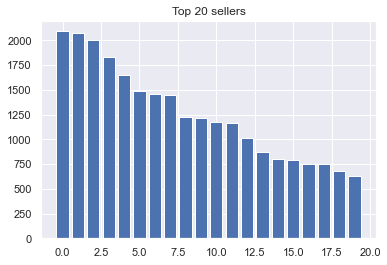

In [313]:
top20sellerdic = {'4a3ca9315b744ce9f8e9374361493884' : 2093,
'6560211a19b47992c3666cc44a7e94c0' :  2076,
'1f50f920176fa81dab994f9023523100'   : 2003,
'cc419e0650a3c5ba77189a1882b7556a'   : 1828,
'da8622b14eb17ae2831f4ac5b9dab84a'   : 1650,
'955fee9216a65b617aa5c0531780ce60'   : 1492,
'1025f0e2d44d7041d6cf58b6550e0bfa'   : 1456,
'7c67e1448b00f6e969d365cea6b010ab'   : 1445,
'7a67c85e85bb2ce8582c35f2203ad736'   : 1221,
'ea8482cd71df3c1969d7b9473ff13abc'   : 1217,
'3d871de0142ce09b7081e2b9d1733cb1'   : 1176,
'4869f7a5dfa277a7dca6462dcf3b52b2'   : 1170,
'8b321bb669392f5163d04c59e235e066'   : 1014,
'cca3071e3e9bb7d12640c9fbe2301306'   :  872,
'620c87c171fb2a6dd6e8bb4dec959fc6'   :  797,
'a1043bafd471dff536d0c462352beb48'  : 788,
'e9779976487b77c6d4ac45f75ec7afe9'  : 749,
'f8db351d8c4c4c22c6835c19a46f01b0'   : 747,
'd2374cbcbb3ca4ab1086534108cc3ab7'   : 680,
'391fc6631aebcf3004804e51b40bcf1e'   :  630}

plt.bar(range(len(top20sellerdic)), list(top20sellerdic.values()), align='center')
#plt.xticks(range(len(top20sellerdic)), list(top20sellerdic.keys()))
plt.title('Top 20 sellers')

In [314]:
final_data.groupby('seller_id')['price'].sum().sort_values(ascending=False)[:10]
# The sellers who sell the most and those who sell the most may differ from each other.

seller_id
53243585a1d6dc2643021fd1853d8905    237755.94
4869f7a5dfa277a7dca6462dcf3b52b2    233980.94
4a3ca9315b744ce9f8e9374361493884    209872.17
fa1c13f2614d7b5c4749cbc52fecda94    199591.73
7c67e1448b00f6e969d365cea6b010ab    196764.46
7e93a43ef30c4f03f38b393420bc753a    172197.80
da8622b14eb17ae2831f4ac5b9dab84a    170155.77
7a67c85e85bb2ce8582c35f2203ad736    147613.03
1025f0e2d44d7041d6cf58b6550e0bfa    141853.79
955fee9216a65b617aa5c0531780ce60    132857.12
Name: price, dtype: float64

In [315]:
# sellers sale their products from 1 city.
final_data.groupby('seller_id')['seller_city'].nunique().sort_values() # bütün satıcılar bir şehir üzerinden satış yapıyor.

seller_id
0015a82c2db000af6aaaf3ae2ecb0532    1
aa17b35ce4de7b565be3249ba838944f    1
aa1eb17b9fdf6dfd546e25c45c7b9235    1
aa2640d851ec322526f1295bbeb20092    1
aa762680c40618316a896838866140ea    1
                                   ..
539ed9e19811677513447759be5eccfc    1
53b0300ca793f9834cd69c0678d35ee8    1
53d00c40e32aeb924a84ce72b1af869d    1
54065e9aef7e9e9c2dc23b7594db021a    1
ffff564a4f9085cd26170f4732393726    1
Name: seller_city, Length: 2907, dtype: int64

In [316]:
# a seller where expensive categories are sold, the 2nd highest selling seller in terms of price
final_data[final_data['seller_id']=='4869f7a5dfa277a7dca6462dcf3b52b2']['product_category'].unique()

array(['watches_gifts', 'cool_stuff', 'sports_leisure', 'health_beauty',
       'auto', 'audio', 'computers_accessories', 'electronics',
       'telephony', 'consoles_games'], dtype=object)

In [374]:
#data.pivot_table('price', index='seller_id', columns='product_category', aggfunc='sum', fill_value=0)

* Sellers who has review score 1

In [317]:
# Sellers who has review score 1
seller_score_1 = final_data[final_data['review_score']==1]
seller_score_1.groupby('seller_id')['order_id'].count().sort_values(ascending=False)

seller_id
7c67e1448b00f6e969d365cea6b010ab    326
4a3ca9315b744ce9f8e9374361493884    304
1f50f920176fa81dab994f9023523100    290
6560211a19b47992c3666cc44a7e94c0    251
1025f0e2d44d7041d6cf58b6550e0bfa    226
                                   ... 
b248792ac0b60ec3f93d80af1b4fae47      1
b29d3380981c51df13fc6fbe87e1763d      1
49e7217cfe4e427191c378ec626d8737      1
b347677812ea483b0f528eaf8cbc09b7      1
0015a82c2db000af6aaaf3ae2ecb0532      1
Name: order_id, Length: 1506, dtype: int64

In [377]:
seller_score_1.groupby('seller_id')['order_id'].count().sort_values(ascending=False)[:10]

seller_id
7c67e1448b00f6e969d365cea6b010ab    330
4a3ca9315b744ce9f8e9374361493884    321
1f50f920176fa81dab994f9023523100    294
6560211a19b47992c3666cc44a7e94c0    276
1025f0e2d44d7041d6cf58b6550e0bfa    235
cc419e0650a3c5ba77189a1882b7556a    233
da8622b14eb17ae2831f4ac5b9dab84a    184
955fee9216a65b617aa5c0531780ce60    153
ea8482cd71df3c1969d7b9473ff13abc    153
4869f7a5dfa277a7dca6462dcf3b52b2    136
Name: order_id, dtype: int64

In [319]:
final_data[final_data['seller_id']=='7c67e1448b00f6e969d365cea6b010ab']['product_category'].unique()

array(['baby', 'sports_leisure', 'office_furniture', 'furniture_decor',
       'auto', 'furniture_living_room'], dtype=object)

In [322]:
final_data[final_data['seller_id']=='7c67e1448b00f6e969d365cea6b010ab']['review_score'].value_counts()
# Sellers with always low scores can be warned to ensure that their customers' experience on the site is not bad.

5    488
4    338
1    326
3    210
2     83
Name: review_score, dtype: int64

## <span style='color:gray '> Customer Analysis </span> 

In [325]:
final_data['customer_unique_id'].describe()

count                               113210
unique                               91481
top       9a736b248f67d166d2fbb006bcb877c3
freq                                    75
Name: customer_unique_id, dtype: object

In [326]:
final_data.customer_unique_id.value_counts()[:10]

9a736b248f67d166d2fbb006bcb877c3    75
6fbc7cdadbb522125f4b27ae9dee4060    38
f9ae226291893fda10af7965268fb7f6    35
569aa12b73b5f7edeaa6f2a01603e381    26
d97b3cfb22b0d6b25ac9ed4e9c2d481b    24
90807fdb59eec2152bc977feeb6e47e7    24
5419a7c9b86a43d8140e2939cd2c2f7e    24
db1af3fd6b23ac3873ef02619d548f9c    24
1d2435aa3b858d45c707c9fc25e18779    24
c8460e4251689ba205045f3ea17884a1    24
Name: customer_unique_id, dtype: int64

In [327]:
final_data['customer_id'].describe()

count                               113210
unique                               94488
top       270c23a11d024a44c896d1894b261a83
freq                                    63
Name: customer_id, dtype: object

In [328]:
final_data.customer_id.value_counts()

270c23a11d024a44c896d1894b261a83    63
13aa59158da63ba0e93ec6ac2c07aacb    38
92cd3ec6e2d643d4ebd0e3d6238f69e2    26
63b964e79dee32a3587651701a2b8dbf    24
2ba91e12e5e4c9f56b82b86d9031d329    24
                                    ..
8543c0b4f11a268a7f4713ca98c4b2ba     1
42a745668db9403a33580aa5c72271e3     1
47c0dc33aca81e253eeb1398c2327b34     1
a8d813fb13a1697d868dcd44130cfb31     1
d7dfcfd41adf9bb80e3f2838b3be52b3     1
Name: customer_id, Length: 94488, dtype: int64

In [329]:
topcustomers = final_data.pivot_table(index =['customer_unique_id'], 
                       values =['product_category'], 
                       aggfunc ='count')
topcustomers.sort_values(by='product_category', ascending=False)[:20]

,product_category
customer_unique_id,
9a736b248f67d166d2fbb006bcb877c3,75
6fbc7cdadbb522125f4b27ae9dee4060,38
f9ae226291893fda10af7965268fb7f6,35
569aa12b73b5f7edeaa6f2a01603e381,26
90807fdb59eec2152bc977feeb6e47e7,24
1d2435aa3b858d45c707c9fc25e18779,24
db1af3fd6b23ac3873ef02619d548f9c,24
85963fd37bfd387aa6d915d8a1065486,24
c8460e4251689ba205045f3ea17884a1,24


#### customer with customer unique id : '9a736b248f67d166d2fbb006bcb877c3' 

##### I think this customer is an opportunistic customer.

In [ ]:
#data[data['customer_unique_id']=='9a736b248f67d166d2fbb006bcb877c3']c# to see its orders

In [330]:
# Let's start with top purchased customer
top_purchaser = final_data[final_data['customer_unique_id']=='9a736b248f67d166d2fbb006bcb877c3']
top_purchaser.groupby('product_id').size()

product_id
4eb99b5f0d7e411f246a5c9c0ae27a5e    12
5ddab10d5e0a23acb99acf56b62b3276    21
ebf9bc6cd600eadd681384e3116fda85    42
dtype: int64

In [333]:
# The customer who bought the most products in the data
final_data[final_data['customer_unique_id']=='9a736b248f67d166d2fbb006bcb877c3']['product_category'].unique()

array(['housewares', 'bed_bath_table', 'furniture_decor'], dtype=object)

In [332]:
# 12 furniture decor
len(final_data[(final_data['customer_unique_id']=='9a736b248f67d166d2fbb006bcb877c3') & (data['product_category']=='furniture_decor')])

12

In [335]:
final_data[(final_data['customer_unique_id']=='9a736b248f67d166d2fbb006bcb877c3') & (data['product_id']=='4eb99b5f0d7e411f246a5c9c0ae27a5e')]['order_item_id']

32632    1
32633    1
32634    1
32635    1
32636    1
32637    1
32638    1
32639    1
32640    1
32641    1
32642    1
32643    1
Name: order_item_id, dtype: int64

In [334]:
# These 12 items were also purchased on the same day.
final_data[(final_data['customer_unique_id']=='9a736b248f67d166d2fbb006bcb877c3') & (data['product_category']=='furniture_decor')]['order_purchase_timestamp'].unique()

array(['2017-07-27T12:50:46.000000000'], dtype='datetime64[ns]')

In [336]:
final_data[(final_data['customer_unique_id']=='9a736b248f67d166d2fbb006bcb877c3') & (final_data['product_id']=='ebf9bc6cd600eadd681384e3116fda85')]['order_item_id'].sum()

63

In [339]:
#All 21 products received on the same day by the same customer
final_data[(final_data['customer_unique_id']=='9a736b248f67d166d2fbb006bcb877c3') & (final_data['product_category']=='housewares')]['order_purchase_timestamp'].unique()

array(['2017-08-08T20:26:31.000000000'], dtype='datetime64[ns]')

In [337]:
final_data[(final_data['customer_unique_id']=='9a736b248f67d166d2fbb006bcb877c3') & (data['product_id']=='5ddab10d5e0a23acb99acf56b62b3276')]['order_item_id'].sum()

63

In [387]:
len(data[(data['customer_unique_id']=='9a736b248f67d166d2fbb006bcb877c3') & (data['product_category']=='bed_bath_table')])

42

In [340]:
# These 42 products were also sold on the same date.
final_data[(final_data['customer_unique_id']=='9a736b248f67d166d2fbb006bcb877c3') & (final_data['product_category']=='bed_bath_table')]['order_purchase_timestamp'].unique()

array(['2017-08-08T20:26:31.000000000'], dtype='datetime64[ns]')

##### customer_unique_id : ' 6fbc7cdadbb522125f4b27ae9dee4060'  - second most buyer

In [341]:
len(final_data[final_data['customer_unique_id']=='6fbc7cdadbb522125f4b27ae9dee4060'])
# this customer buy 38 same product in a same day

38

In [343]:
# Let's look at the categories of products bought by the second most shopping customer.
final_data[final_data['customer_unique_id']=='6fbc7cdadbb522125f4b27ae9dee4060']['product_category'].unique()

array(['office_furniture'], dtype=object)

In [342]:
final_data[final_data['customer_unique_id']=='6fbc7cdadbb522125f4b27ae9dee4060']['product_id'].unique()

array(['0554911df28fda9fd668ce5ba5949695'], dtype=object)

In [404]:
len(final_data[final_data['product_id']=='0554911df28fda9fd668ce5ba5949695'])

38

In [344]:
len(final_data[(final_data['customer_unique_id']=='6fbc7cdadbb522125f4b27ae9dee4060') & (final_data['product_category']=='office_furniture')])

38

In [347]:
# this customer also bought 38 of the same product and they were all bought on the same day
final_data[(final_data['customer_unique_id']=='6fbc7cdadbb522125f4b27ae9dee4060') & (final_data['product_category']=='office_furniture')]['product_id'].unique()

array(['0554911df28fda9fd668ce5ba5949695'], dtype=object)

In [345]:
final_data[(final_data['customer_unique_id']=='6fbc7cdadbb522125f4b27ae9dee4060') & (final_data['product_category']=='office_furniture')]['order_item_id'].sum()

57

In [348]:
# this customer also bought 38 of the same product and they were all bought on the same day
final_data[(final_data['customer_unique_id']=='6fbc7cdadbb522125f4b27ae9dee4060') & (final_data['product_category']=='office_furniture')]['order_purchase_timestamp'].unique()

array(['2017-09-23T14:56:45.000000000'], dtype='datetime64[ns]')

In [346]:
final_data[(final_data['customer_unique_id']=='6fbc7cdadbb522125f4b27ae9dee4060') & (final_data['product_category']=='office_furniture')][['product_id','order_purchase_timestamp','order_item_id','seller_id','payment_installments','payment_type','payment_sequential']]

,product_id,order_purchase_timestamp,order_item_id,seller_id,payment_installments,payment_type,payment_sequential
91706,0554911df28fda9fd668ce5ba5949695,2017-09-23 14:56:45,1,7c67e1448b00f6e969d365cea6b010ab,1,voucher,15
91707,0554911df28fda9fd668ce5ba5949695,2017-09-23 14:56:45,2,7c67e1448b00f6e969d365cea6b010ab,1,voucher,15
91708,0554911df28fda9fd668ce5ba5949695,2017-09-23 14:56:45,1,7c67e1448b00f6e969d365cea6b010ab,1,credit_card,1
91709,0554911df28fda9fd668ce5ba5949695,2017-09-23 14:56:45,2,7c67e1448b00f6e969d365cea6b010ab,1,credit_card,1
91710,0554911df28fda9fd668ce5ba5949695,2017-09-23 14:56:45,1,7c67e1448b00f6e969d365cea6b010ab,1,voucher,9
91711,0554911df28fda9fd668ce5ba5949695,2017-09-23 14:56:45,2,7c67e1448b00f6e969d365cea6b010ab,1,voucher,9
91712,0554911df28fda9fd668ce5ba5949695,2017-09-23 14:56:45,1,7c67e1448b00f6e969d365cea6b010ab,1,voucher,11
91713,0554911df28fda9fd668ce5ba5949695,2017-09-23 14:56:45,2,7c67e1448b00f6e969d365cea6b010ab,1,voucher,11
91714,0554911df28fda9fd668ce5ba5949695,2017-09-23 14:56:45,1,7c67e1448b00f6e969d365cea6b010ab,1,voucher,8
91715,0554911df28fda9fd668ce5ba5949695,2017-09-23 14:56:45,2,7c67e1448b00f6e969d365cea6b010ab,1,voucher,8


 Receiving all products in the same category as the same product on the same day made us think that this customer may also be a seller.

##### customer_unique_id : ' f9ae226291893fda10af7965268fb7f6'

In [349]:
# Let's look at the categories of products bought by the third most shopping customer.
final_data[final_data['customer_unique_id']=='f9ae226291893fda10af7965268fb7f6']['product_category'].unique()

array(['garden_tools'], dtype=object)

In [350]:
final_data[(final_data['customer_unique_id']=='f9ae226291893fda10af7965268fb7f6') & (final_data['product_category']=='garden_tools')]['product_id'].unique()

array(['5dddb31154cbd968caa4706ef0f4e0f0',
       '0449db5eede617c5fd413071d582f038'], dtype=object)

In [351]:
final_data[(final_data['customer_unique_id']=='f9ae226291893fda10af7965268fb7f6') & (data['product_category']=='garden_tools')][['order_purchase_timestamp','order_item_id','seller_id','product_id','payment_type','payment_sequential']]

,order_purchase_timestamp,order_item_id,seller_id,product_id,payment_type,payment_sequential
89470,2017-03-11 18:34:44,1,df560393f3a51e74553ab94004ba5c87,5dddb31154cbd968caa4706ef0f4e0f0,voucher,7
89471,2017-03-11 18:34:44,1,df560393f3a51e74553ab94004ba5c87,5dddb31154cbd968caa4706ef0f4e0f0,voucher,11
89472,2017-03-11 18:34:44,1,df560393f3a51e74553ab94004ba5c87,5dddb31154cbd968caa4706ef0f4e0f0,credit_card,1
89473,2017-03-11 18:34:44,1,df560393f3a51e74553ab94004ba5c87,5dddb31154cbd968caa4706ef0f4e0f0,voucher,5
89474,2017-03-11 18:34:44,1,df560393f3a51e74553ab94004ba5c87,5dddb31154cbd968caa4706ef0f4e0f0,voucher,10
89475,2017-03-11 18:34:44,1,df560393f3a51e74553ab94004ba5c87,5dddb31154cbd968caa4706ef0f4e0f0,voucher,3
89476,2017-03-11 18:34:44,1,df560393f3a51e74553ab94004ba5c87,5dddb31154cbd968caa4706ef0f4e0f0,voucher,8
89477,2017-03-11 18:34:44,1,df560393f3a51e74553ab94004ba5c87,5dddb31154cbd968caa4706ef0f4e0f0,voucher,6
89478,2017-03-11 18:34:44,1,df560393f3a51e74553ab94004ba5c87,5dddb31154cbd968caa4706ef0f4e0f0,voucher,9
89479,2017-03-11 18:34:44,1,df560393f3a51e74553ab94004ba5c87,5dddb31154cbd968caa4706ef0f4e0f0,voucher,2


In [352]:
third_purchaser =final_data[final_data['customer_unique_id']=='f9ae226291893fda10af7965268fb7f6']
third_purchaser.groupby('product_id').size()

product_id
0449db5eede617c5fd413071d582f038    24
5dddb31154cbd968caa4706ef0f4e0f0    11
dtype: int64

In [353]:
final_data[(final_data['customer_unique_id']=='f9ae226291893fda10af7965268fb7f6') & (final_data['product_category']=='garden_tools')]['order_purchase_timestamp'].unique()

array(['2017-03-11T18:34:44.000000000', '2017-03-09T23:39:26.000000000'],
      dtype='datetime64[ns]')

In [354]:
final_data[final_data['customer_unique_id']=='f9ae226291893fda10af7965268fb7f6']['order_item_id'].sum()

47

I could not decide whether this customer is an opportunistic customer, he may have made various campaigns in the garden tools sale in March, the products he bought could be flower pots, but I can see that he bought a lot of products from the same product.

In [ ]:
#data[(data['customer_unique_id']=='8af7ac63b2efbcbd88e5b11505e8098a')]

In [ ]:
#index = pivot.sort_values(by='product_category', ascending=False)[:20].index
#index

In [ ]:
#category = []
#count_different_product = []
#date = []
#for i in index:
#    i=str(i)
#    count_different_product.append(data[data['customer_unique_id']==i]['product_id'].unique())
#    date.append(data[data['customer_unique_id']==i]['order_purchase_timestamp'][0:9].unique())
#    print('Customer unique id :', i,'\nproduct id count :',count_different_product)
#    print('                                           ')
#    print('Unique dates to purchase:\n', date)
#    print('                                           ')
#    print('*******************************************')

## <span style='color:gray '> Order Items </span> 

In [355]:
final_data['order_item_id'].describe()

count    113210.000000
mean          1.195036
std           0.687479
min           1.000000
25%           1.000000
50%           1.000000
75%           1.000000
max          21.000000
Name: order_item_id, dtype: float64

In [356]:
final_data['order_item_id'].unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21], dtype=int64)

In [357]:
final_data.groupby('order_id')['order_item_id'].sum().sort_values(ascending=False)

order_id
8272b63d03f5f79c56e9e4120aec44ef    231
1b15974a0141d54e36626dca3fdc731a    210
5a3b1c29a49756e75f1ef513383c0c12    132
895ab968e7bb0d5659d16cd74cd1650c    126
428a2f660dc84138d969ccd69a0ab6d5    120
                                   ... 
5bd1a9bce151c7b6f014c44d3bd1dd08      1
5bd12089d3beaa286c0faa3f596d0c89      1
5bd09c25c13fd88f4f9928d25cba13e3      1
5bcf5ca118d9e81440bf98e26c943255      1
fffe41c64501cc87c801fd61db3f6244      1
Name: order_item_id, Length: 94488, dtype: int64

In [192]:
# Health and beauty products can be makeup products with the highest number of items in an order.
final_data[final_data['order_id']=='8272b63d03f5f79c56e9e4120aec44ef'] 

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,zip_code_prefix,seller_city,seller_state,product_category,review_id,review_score,review_creation_date,review_answer_timestamp,purchased_Year,purchased_Month,purchased_Day,Day,Year_Month,purchased_Hour,day_periods
49694,8272b63d03f5f79c56e9e4120aec44ef,fc3d1daec319d62d49bfb5e1f83123e9,delivered,2017-07-16 18:19:25,2017-07-17 18:25:23,2017-07-20 15:45:53,2017-07-31 18:03:02,2017-07-28,1,credit_card,2,196.11,4546caea018ad8c692964e3382debd19,5882,sao paulo,SP,1,270516a3f41dc035aa87d220228f844c,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89,3813,sao paulo,SP,health_beauty,e8236fe7b6e1bdd513a500de361e2b87,1,2017-07-30,2017-07-30 14:19:07,2017,July,Sunday,16,201707,18,Evening
49695,8272b63d03f5f79c56e9e4120aec44ef,fc3d1daec319d62d49bfb5e1f83123e9,delivered,2017-07-16 18:19:25,2017-07-17 18:25:23,2017-07-20 15:45:53,2017-07-31 18:03:02,2017-07-28,1,credit_card,2,196.11,4546caea018ad8c692964e3382debd19,5882,sao paulo,SP,12,270516a3f41dc035aa87d220228f844c,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89,3813,sao paulo,SP,health_beauty,e8236fe7b6e1bdd513a500de361e2b87,1,2017-07-30,2017-07-30 14:19:07,2017,July,Sunday,16,201707,18,Evening
49696,8272b63d03f5f79c56e9e4120aec44ef,fc3d1daec319d62d49bfb5e1f83123e9,delivered,2017-07-16 18:19:25,2017-07-17 18:25:23,2017-07-20 15:45:53,2017-07-31 18:03:02,2017-07-28,1,credit_card,2,196.11,4546caea018ad8c692964e3382debd19,5882,sao paulo,SP,13,270516a3f41dc035aa87d220228f844c,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89,3813,sao paulo,SP,health_beauty,e8236fe7b6e1bdd513a500de361e2b87,1,2017-07-30,2017-07-30 14:19:07,2017,July,Sunday,16,201707,18,Evening
49697,8272b63d03f5f79c56e9e4120aec44ef,fc3d1daec319d62d49bfb5e1f83123e9,delivered,2017-07-16 18:19:25,2017-07-17 18:25:23,2017-07-20 15:45:53,2017-07-31 18:03:02,2017-07-28,1,credit_card,2,196.11,4546caea018ad8c692964e3382debd19,5882,sao paulo,SP,14,270516a3f41dc035aa87d220228f844c,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89,3813,sao paulo,SP,health_beauty,e8236fe7b6e1bdd513a500de361e2b87,1,2017-07-30,2017-07-30 14:19:07,2017,July,Sunday,16,201707,18,Evening
49698,8272b63d03f5f79c56e9e4120aec44ef,fc3d1daec319d62d49bfb5e1f83123e9,delivered,2017-07-16 18:19:25,2017-07-17 18:25:23,2017-07-20 15:45:53,2017-07-31 18:03:02,2017-07-28,1,credit_card,2,196.11,4546caea018ad8c692964e3382debd19,5882,sao paulo,SP,15,270516a3f41dc035aa87d220228f844c,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89,3813,sao paulo,SP,health_beauty,e8236fe7b6e1bdd513a500de361e2b87,1,2017-07-30,2017-07-30 14:19:07,2017,July,Sunday,16,201707,18,Evening
49699,8272b63d03f5f79c56e9e4120aec44ef,fc3d1daec319d62d49bfb5e1f83123e9,delivered,2017-07-16 18:19:25,2017-07-17 18:25:23,2017-07-20 15:45:53,2017-07-31 18:03:02,2017-07-28,1,credit_card,2,196.11,4546caea018ad8c692964e3382debd19,5882,sao paulo,SP,16,270516a3f41dc035aa87d220228f844c,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89,3813,sao paulo,SP,health_beauty,e8236fe7b6e1bdd513a500de361e2b87,1,2017-07-30,2017-07-30 14:19:07,2017,July,Sunday,16,201707,18,Evening
49700,8272b63d03f5f79c56e9e4120aec44ef,fc3d1daec319d62d49bfb5e1f83123e9,delivered,2017-07-16 18:19:25,2017-07-17 18:25:23,2017-07-20 15:45:53,2017-07-31 18:03:02,2017-07-28,1,credit_card,2,196.11,4546caea018ad8c692964e3382debd19,5882,sao paulo,SP,17,270516a3f41dc035aa87d220228f844c,2709af9587499e95e803a6498a5a56e9,2017-07-21 18:25:23,1.2,7.89,3813,sao paulo,SP,health_beauty,e8236fe7b6e1bdd513a500de361e2b87,1,2017-07-30,2017-07-30 14:19:07,2017,July,Sunday,16,201707,18,Evening
49701,8272b63d03f5f79c56e9e4120aec44ef,

## <span style='color:gray '> Order ID </span> 

In [358]:
final_data['order_id'].describe()

count                               113210
unique                               94488
top       895ab968e7bb0d5659d16cd74cd1650c
freq                                    63
Name: order_id, dtype: object

In [359]:
len(final_data[final_data['order_id']=='895ab968e7bb0d5659d16cd74cd1650c'])

63

In [360]:
final_data[final_data['order_id']=='895ab968e7bb0d5659d16cd74cd1650c']

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,zip_code_prefix,seller_city,seller_state,product_category,review_id,review_score,purchased_Year,purchased_Month,purchased_Day,Day,Season,SeasonName,Year_Month,purchased_Hour,day_periods
6497,895ab968e7bb0d5659d16cd74cd1650c,270c23a11d024a44c896d1894b261a83,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,17,voucher,1,16.70,9a736b248f67d166d2fbb006bcb877c3,3227,sao paulo,SP,3,5ddab10d5e0a23acb99acf56b62b3276,3d0cd21d41671c46f82cd11176bf7277,2017-08-14 20:43:31,83.80,5.12,89217,joinville,SC,housewares,eef5dbca8d37dfce6db7d7b16dd0525e,5,2017,August,Tuesday,8,3,Winter,201708,20,Night
6498,895ab968e7bb0d5659d16cd74cd1650c,270c23a11d024a44c896d1894b261a83,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,1,voucher,1,2.61,9a736b248f67d166d2fbb006bcb877c3,3227,sao paulo,SP,3,5ddab10d5e0a23acb99acf56b62b3276,3d0cd21d41671c46f82cd11176bf7277,2017-08-14 20:43:31,83.80,5.12,89217,joinville,SC,housewares,eef5dbca8d37dfce6db7d7b16dd0525e,5,2017,August,Tuesday,8,3,Winter,201708,20,Night
6499,895ab968e7bb0d5659d16cd74cd1650c,270c23a11d024a44c896d1894b261a83,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,13,voucher,1,16.70,9a736b248f67d166d2fbb006bcb877c3,3227,sao paulo,SP,3,5ddab10d5e0a23acb99acf56b62b3276,3d0cd21d41671c46f82cd11176bf7277,2017-08-14 20:43:31,83.80,5.12,89217,joinville,SC,housewares,eef5dbca8d37dfce6db7d7b16dd0525e,5,2017,August,Tuesday,8,3,Winter,201708,20,Night
6500,895ab968e7bb0d5659d16cd74cd1650c,270c23a11d024a44c896d1894b261a83,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,16,voucher,1,16.70,9a736b248f67d166d2fbb006bcb877c3,3227,sao paulo,SP,3,5ddab10d5e0a23acb99acf56b62b3276,3d0cd21d41671c46f82cd11176bf7277,2017-08-14 20:43:31,83.80,5.12,89217,joinville,SC,housewares,eef5dbca8d37dfce6db7d7b16dd0525e,5,2017,August,Tuesday,8,3,Winter,201708,20,Night
6501,895ab968e7bb0d5659d16cd74cd1650c,270c23a11d024a44c896d1894b261a83,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,19,voucher,1,0.24,9a736b248f67d166d2fbb006bcb877c3,3227,sao paulo,SP,3,5ddab10d5e0a23acb99acf56b62b3276,3d0cd21d41671c46f82cd11176bf7277,2017-08-14 20:43:31,83.80,5.12,89217,joinville,SC,housewares,eef5dbca8d37dfce6db7d7b16dd0525e,5,2017,August,Tuesday,8,3,Winter,201708,20,Night
6502,895ab968e7bb0d5659d16cd74cd1650c,270c23a11d024a44c896d1894b261a83,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,4,voucher,1,2.61,9a736b248f67d166d2fbb006bcb877c3,3227,sao paulo,SP,3,5ddab10d5e0a23acb99acf56b62b3276,3d0cd21d41671c46f82cd11176bf7277,2017-08-14 20:43:31,83.80,5.12,89217,joinville,SC,housewares,eef5dbca8d37dfce6db7d7b16dd0525e,5,2017,August,Tuesday,8,3,Winter,201708,20,Night
6503,895ab968e7bb0d5659d16cd74cd1650c,270c23a11d024a44c896d1894b261a83,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,21,voucher,1,0.28,9a736b248f67d166d2fbb006bcb877c3,3227,sao paulo,SP,3,5ddab10d5e0a23acb99acf56b62b3276,3d0cd21d41671c46f82cd11176bf7277,2017-08-14 20:43:31,83.80,5.12,89217,joinville,SC,housewares,eef5dbca8d37dfce6db7d7b16dd0525e,5,2017,August,Tuesday,8,3,Winter,201708,20,Night
6504,895ab968e7bb0d5659d16cd74cd1650c,270c23a11d024a44c896d1894b261a83,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,2,voucher,1,2.61,9a736b248f67d166d2fbb006bcb877c3,3227,sao paulo,SP,3,5ddab10d5e0a23acb99acf56b

##### some orders 
895ab968e7bb0d5659d16cd74cd1650c	63	 0.1%

fedcd9f7ccdc8cba3a18defedd1a5547	38	 < 0.1%

fa65dad1b0e818e3ccc5cb0e39231352	29	 < 0.1%

ccf804e764ed5650cd8759557269dc13	26	 < 0.1%

a3725dfe487d359b5be08cac48b64ec5	24	 < 0.1%

6d58638e32674bebee793a47ac4cbadc	24	 < 0.1%

68986e4324f6a21481df4e6e89abcf01	24	 < 0.1%

c6492b842ac190db807c15aff21a7dd6	24	 < 0.1%

465c2e1bee4561cb39e0db8c5993aafc	24	 < 0.1%

285c2e15bebd4ac83635ccc563dc71f4

## <span style='color:gray '> Product ID </span> 

In [361]:
final_data['product_id'].describe() # most purchased product

count                               113210
unique                               31481
top       aca2eb7d00ea1a7b8ebd4e68314663af
freq                                   526
Name: product_id, dtype: object

In [362]:
final_data.groupby('product_id')['product_id'].count().sort_values(ascending=False)

product_id
aca2eb7d00ea1a7b8ebd4e68314663af    526
422879e10f46682990de24d770e7f83d    507
99a4788cb24856965c36a24e339b6058    507
389d119b48cf3043d311335e499d9c6b    402
368c6c730842d78016ad823897a372db    395
                                   ... 
6ed222ae1a69000a035843cc85964446      1
6ec96c91757fad0aecafc0ee7f262dcc      1
6ec26b3516fecd18cda3001a9c48a242      1
6ec18f98bd4eb7efc0989af1505a3f86      1
fffe9eeff12fcbd74a2f2b007dde0c58      1
Name: product_id, Length: 31481, dtype: int64

In [368]:
len(final_data[final_data['product_id']=='ebf9bc6cd600eadd681384e3116fda85']) 
# bu ürün 44 defa satılmış, 42 tanesi aynı müşteri tarafından alınmış. Diğer iki ürün 12.  ayda alınmış

44

In [369]:
final_data[final_data['product_id']=='ebf9bc6cd600eadd681384e3116fda85']['customer_unique_id'].unique()

array(['9a736b248f67d166d2fbb006bcb877c3',
       '51966fd6328b1e4c5fed16ed597ad96d'], dtype=object)

In [370]:
final_data[final_data['product_id']=='ebf9bc6cd600eadd681384e3116fda85']['customer_unique_id'].value_counts()

9a736b248f67d166d2fbb006bcb877c3    42
51966fd6328b1e4c5fed16ed597ad96d     2
Name: customer_unique_id, dtype: int64

An opportunistic customer may be, this product was sold 44 times, 42 of which were bought by the same customer. It is important to identify these customers as it prevents new customers from benefiting from the campaign.

In [371]:
final_data[final_data['product_id']=='ebf9bc6cd600eadd681384e3116fda85'][['product_category','price']]

,product_category,price
6518,bed_bath_table,12.99
6519,bed_bath_table,12.99
6520,bed_bath_table,12.99
6521,bed_bath_table,12.99
6522,bed_bath_table,12.99
6523,bed_bath_table,12.99
6524,bed_bath_table,12.99
6525,bed_bath_table,12.99
6526,bed_bath_table,12.99
6527,bed_bath_table,12.99


In [364]:
len(final_data[final_data['product_id']=='5ddab10d5e0a23acb99acf56b62b3276']) # burdaki ürün de aynı müşteri tarafından alınmış tamamı

21

In [365]:
len(final_data[final_data['product_id']=='4eb99b5f0d7e411f246a5c9c0ae27a5e']) # burda da 12 tanesi aynı müşteri tarfından alınmış.

13

In [367]:
len(final_data[final_data['product_id']=='0449db5eede617c5fd413071d582f038'])

24

In [366]:
len(final_data[final_data['product_id']=='5dddb31154cbd968caa4706ef0f4e0f0']) # 1 tanesi başka müşteri tarafından alınmış.

12

## <span style='color:gray '> Price or Payment Values </span> 

In [372]:
final_data['price'].describe()

count    113210.000000
mean        119.866958
std         181.150493
min           0.850000
25%          39.900000
50%          74.900000
75%         133.000000
max        6735.000000
Name: price, dtype: float64

<AxesSubplot:xlabel='price'>

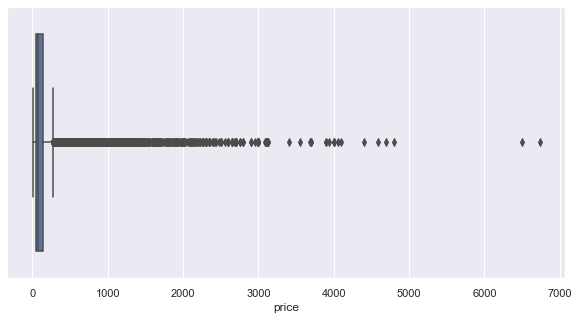

In [375]:
plt.figure(figsize=(10,5))
sns.boxplot(x=final_data['price'])

<AxesSubplot:xlabel='price'>

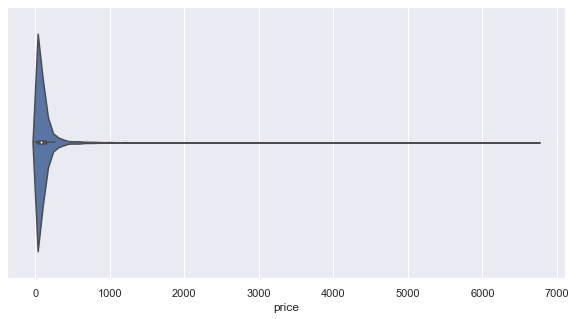

In [376]:
plt.figure(figsize=(10,5))
sns.violinplot(x=final_data['price'])

<AxesSubplot:xlabel='price', ylabel='Count'>

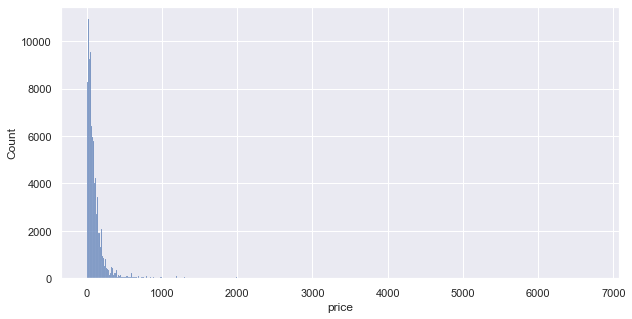

In [377]:
plt.figure(figsize=(10,5))
sns.histplot(data=final_data, x='price',binwidth=10)

<AxesSubplot:xlabel='price', ylabel='Density'>

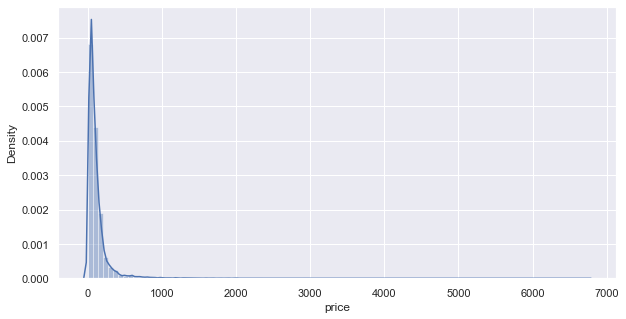

In [379]:
plt.figure(figsize=(10,5))
sns.distplot(final_data['price'], bins=100)

In [419]:
data['payment_value'].describe()

count    115609.000000
mean        172.387379
std         265.873969
min           0.000000
25%          60.870000
50%         108.050000
75%         189.480000
max       13664.080000
Name: payment_value, dtype: float64

<AxesSubplot:xlabel='payment_value'>

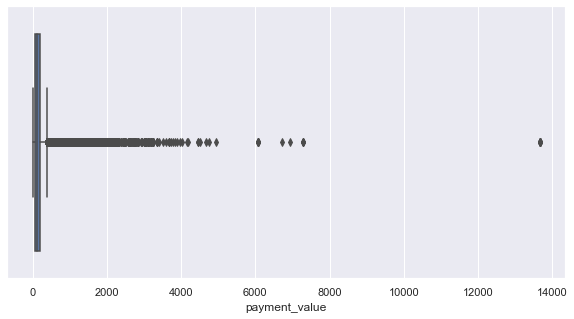

In [381]:
plt.figure(figsize=(10,5))
sns.boxplot(x=final_data['payment_value'])

<AxesSubplot:xlabel='payment_value'>

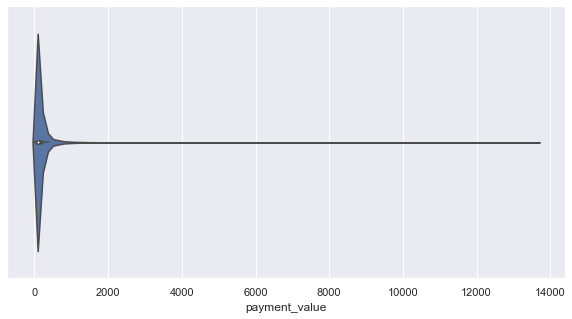

In [382]:
plt.figure(figsize=(10,5))
sns.violinplot(x=final_data['payment_value'])

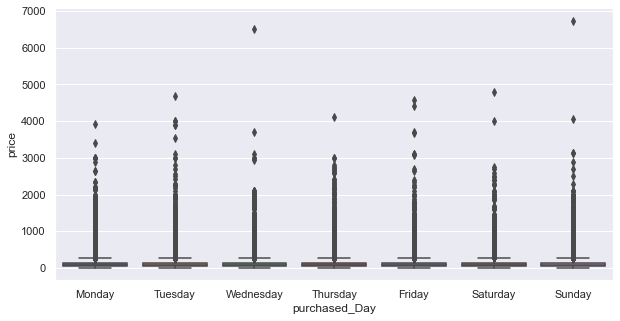

In [384]:
plt.figure(figsize=(10,5))
sns.boxplot(x="purchased_Day", y="price", data=final_data)
sns.set(rc = {'figure.figsize':(20,8)})

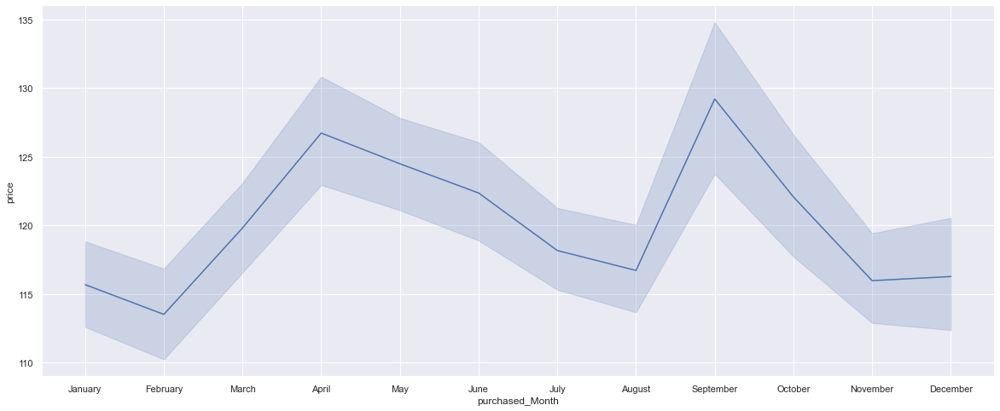

In [387]:
sns.lineplot(data=final_data, x="purchased_Month", y="price")
sns.set(rc={'figure.figsize':(10.7,8.27)})

## <span style='color:gray '>Freight Values </span> 

In [390]:
final_data['freight_value'].describe()

count    113210.000000
mean         20.002577
std          15.710680
min           0.000000
25%          13.080000
50%          16.320000
75%          21.190000
max         409.680000
Name: freight_value, dtype: float64

In [391]:
final_data['freight_value'].sort_values() # some of the order's freight values are 0

57834      0.00
29019      0.00
29024      0.00
29027      0.00
29036      0.00
          ...  
45839    338.30
7178     339.59
6950     375.28
6951     375.28
10453    409.68
Name: freight_value, Length: 113210, dtype: float64

<AxesSubplot:xlabel='freight_value'>

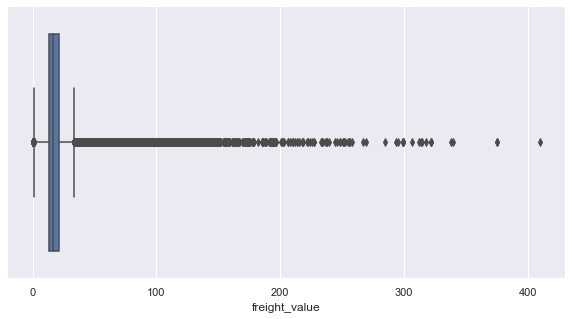

In [392]:
plt.figure(figsize=(10,5))
sns.boxplot(x=final_data['freight_value'])

In [ ]:
#sns.boxplot(x=data['freight_value'])
#sns.set(rc = {'figure.figsize':(20,8)})

<AxesSubplot:xlabel='payment_value', ylabel='freight_value'>

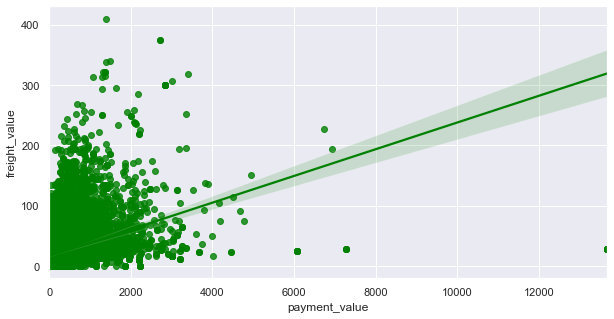

In [394]:
plt.figure(figsize=(10,5))
sns.regplot(x="payment_value", y="freight_value", data=final_data, color='green')

<AxesSubplot:xlabel='price', ylabel='freight_value'>

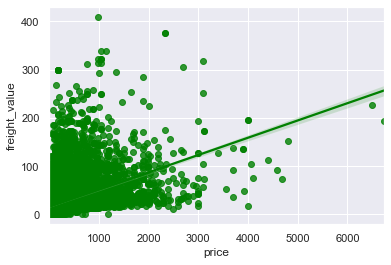

In [441]:
sns.regplot(x="price", y="freight_value", data=final_data, color='green')

<AxesSubplot:xlabel='price', ylabel='freight_value'>

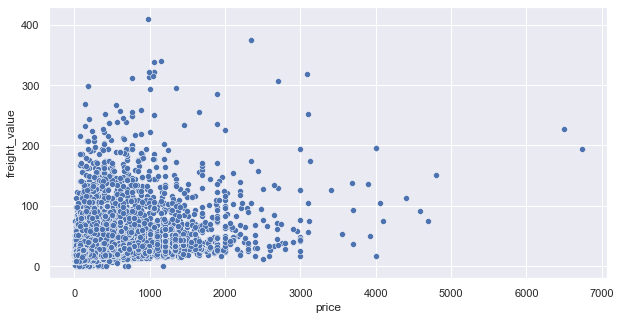

In [395]:
plt.figure(figsize=(10,5))
sns.scatterplot(data=final_data, x="price", y="freight_value")

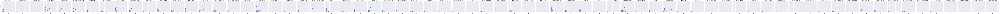

In [396]:
# I looked for each category to see prices and freight values
sns.relplot(
    data=final_data, x="price", y="freight_value",
    col="product_category",
    kind="scatter"
)

<AxesSubplot:xlabel='freight_value'>

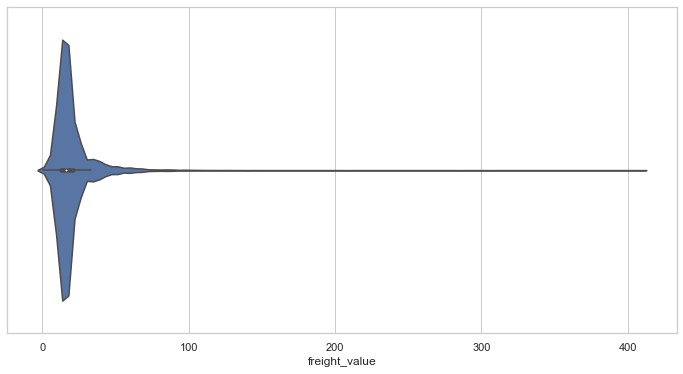

In [501]:
plt.figure(figsize=(12,6))
sns.violinplot(x=final_data['freight_value']) # distribution of the freight value in the data

<AxesSubplot:xlabel='price'>

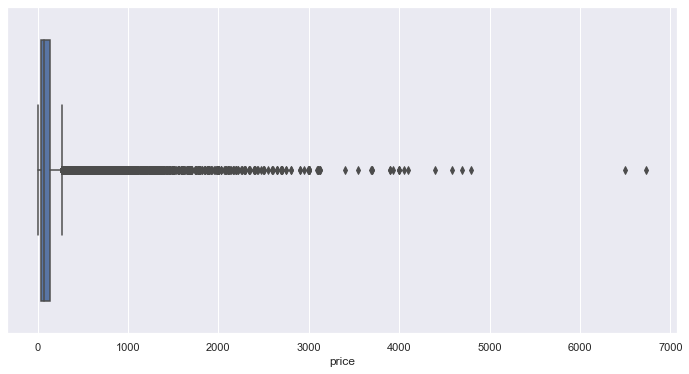

In [397]:
plt.figure(figsize=(12,6))
sns.boxplot(x= final_data['price']) 

In [398]:
final_data[final_data['price']>2000]['product_category'].nunique()

24

In [399]:
final_data[final_data['price']>2000]['product_category'].unique()

array(['housewares', 'baby', 'cool_stuff', 'sports_leisure',
       'health_beauty', 'pet_shop', 'auto', 'watches_gifts',
       'computers_accessories', 'electronics', 'telephony',
       'consoles_games', 'garden_tools',
       'construction_tools_construction', 'art', 'musical_instruments',
       'home_appliances', 'small_appliances_home_oven_and_coffee',
       'small_appliances', 'industry_commerce_and_business',
       'agro_industry_and_commerce', 'home_appliances_2',
       'construction_tools_safety', 'computers'], dtype=object)

In [400]:
final_data[final_data['freight_value']>200]['product_category'].nunique()

18

In [401]:
final_data[final_data['freight_value']>200]['product_category'].unique()

array(['housewares', 'baby', 'sports_leisure', 'furniture_decor',
       'health_beauty', 'auto', 'watches_gifts', 'stationery',
       'signaling_and_security', 'garden_tools', 'office_furniture',
       'furniture_living_room', 'construction_tools_construction',
       'bed_bath_table', 'art', 'musical_instruments',
       'kitchen_dining_laundry_garden_furniture',
       'industry_commerce_and_business'], dtype=object)

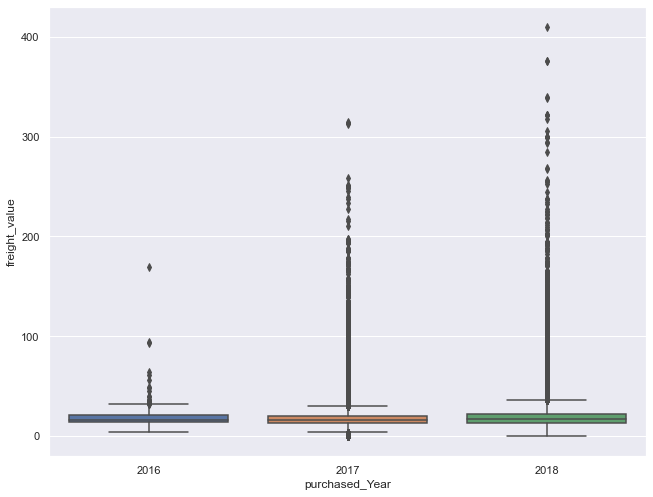

In [402]:
sns.boxplot(x="purchased_Year", y="freight_value", data=final_data)
sns.set(rc = {'figure.figsize':(20,8)})

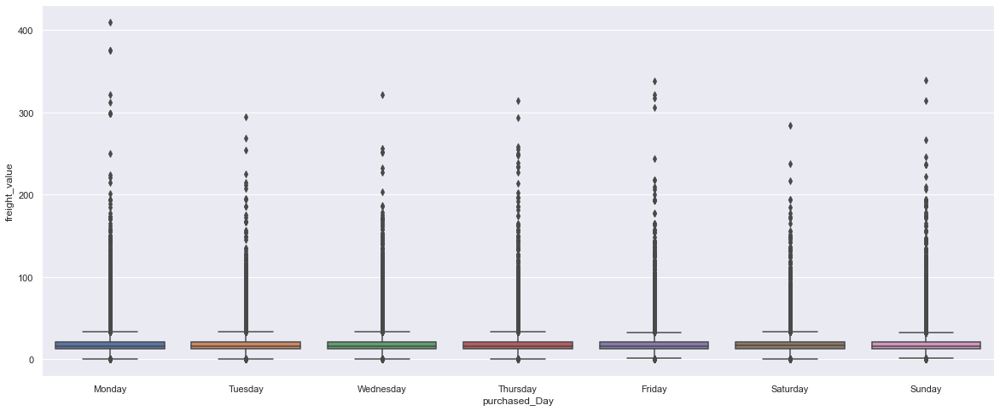

In [403]:
sns.boxplot(x="purchased_Day", y="freight_value", data=final_data)
sns.set(rc = {'figure.figsize':(20,8)})

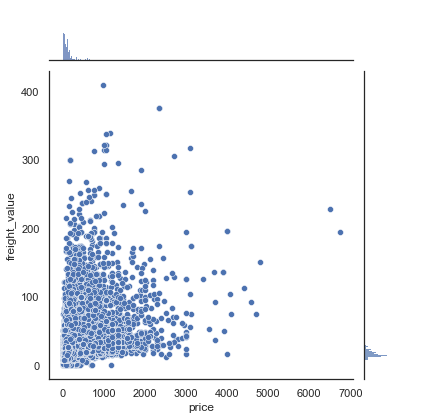

In [404]:
with sns.axes_style('white'):
    sns.jointplot("price", "freight_value", data=final_data)

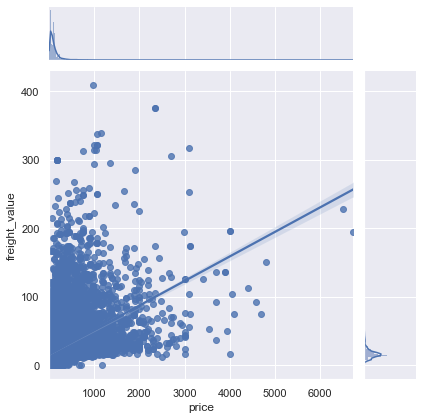

In [405]:
sns.jointplot("price", "freight_value", data=final_data, kind='reg');

In [435]:
len(final_data[(final_data['price'] + data['freight_value'])==data['payment_value']])

68507

In [406]:
len(final_data[(final_data['price'] + data['freight_value'])!=data['payment_value']])

46185

## <span style='color:gray '> Outlier Detection </span> 

In [407]:
# Method 1 — Standard Deviation:

def finding_anomalies(data):
  # I've created empty list to gather anomalies
  anomalies = []

  data_std = np.std(data['price'])  # price std values
  data_mean = np.mean(data['price']) # price mean values
  anomaly_cut_off = data_std * 3

  # Here above the 3 times std plus mean values are outliers
  upper_limit = data_mean + anomaly_cut_off
  # Similarly below the mean minus 3 times std values are also outliers.
  lower_limit  = data_mean - anomaly_cut_off 

  print('Lower limit is:',lower_limit)
  print('Upper limit is:',upper_limit)

      # Generate outliers
  for outlier in data['price']:
      if ((outlier > upper_limit) or (outlier < lower_limit)):
          anomalies.append(outlier)
  return anomalies


In [408]:
finding_anomalies(final_data)

Lower limit is: -423.58212171446365
Upper limit is: 663.3160383298366


[699.0,
 949.0,
 849.0,
 699.0,
 1149.0,
 1149.0,
 1099.0,
 1099.0,
 898.0,
 880.0,
 720.99,
 720.0,
 720.0,
 699.99,
 733.3,
 690.0,
 1799.0,
 798.0,
 699.0,
 686.21,
 686.21,
 686.21,
 686.21,
 1395.0,
 1150.0,
 1150.0,
 1150.0,
 2338.08,
 2338.08,
 2338.08,
 749.0,
 799.0,
 859.9,
 1149.0,
 1489.0,
 1377.5,
 1277.5,
 1377.5,
 1377.5,
 1377.5,
 6735.0,
 1326.0,
 1300.0,
 1009.9,
 889.0,
 987.0,
 1106.99,
 1106.99,
 1106.99,
 999.0,
 1049.0,
 987.0,
 949.9,
 987.0,
 1106.99,
 1106.99,
 987.0,
 949.9,
 1055.9,
 999.0,
 1055.9,
 1055.9,
 999.0,
 987.0,
 987.0,
 987.0,
 987.0,
 987.0,
 987.0,
 987.0,
 1106.99,
 987.0,
 987.0,
 987.0,
 987.0,
 987.0,
 1106.99,
 1106.99,
 999.0,
 987.0,
 949.9,
 1089.0,
 1009.0,
 1009.0,
 999.0,
 1009.0,
 1009.0,
 1009.0,
 887.0,
 887.0,
 887.0,
 1007.0,
 669.0,
 669.0,
 907.9,
 898.0,
 898.0,
 898.0,
 2218.0,
 778.0,
 775.0,
 887.0,
 887.0,
 887.0,
 887.0,
 889.0,
 889.0,
 889.0,
 889.0,
 1837.9,
 887.0,
 799.99,
 679.99,
 699.99,
 799.99,
 899.99,
 799.9

## <span style='color:gray '> Special Day Analysis </span> 

In [409]:
november = final_data[final_data['Year_Month']=='201711']
november.groupby('purchased_Day')['price'].sum()

purchased_Day
Monday       140143.46
Tuesday      127076.88
Wednesday    127110.60
Thursday     152958.81
Friday       224789.24
Saturday     131133.47
Sunday       104910.74
Name: price, dtype: float64

Text(0.5, 1.0, 'Total price by days in November 2017')

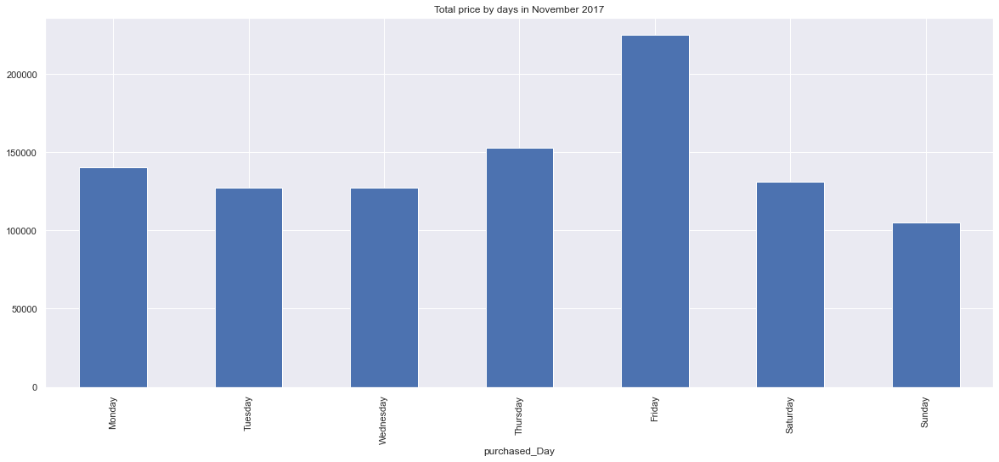

In [410]:
november.groupby('purchased_Day')['price'].sum().plot(kind='bar')
plt.title('Total price by days in November 2017')

In [411]:
november = final_data[final_data['Year_Month']=='201711']
november.groupby('purchased_Day')['order_id'].count()

purchased_Day
Monday       1164
Tuesday      1085
Wednesday    1143
Thursday     1269
Friday       1958
Saturday     1089
Sunday        985
Name: order_id, dtype: int64

Text(0.5, 1.0, 'Total sales by days in November 2017')

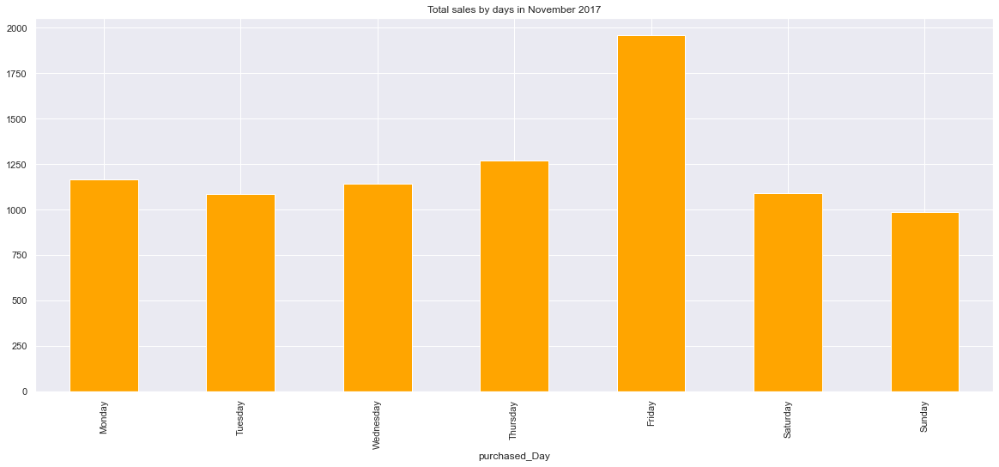

In [412]:
november.groupby('purchased_Day')['order_id'].count().plot(kind='bar', color='orange')
plt.title('Total sales by days in November 2017')

Text(0.5, 1.0, 'Novermber Sales by days')

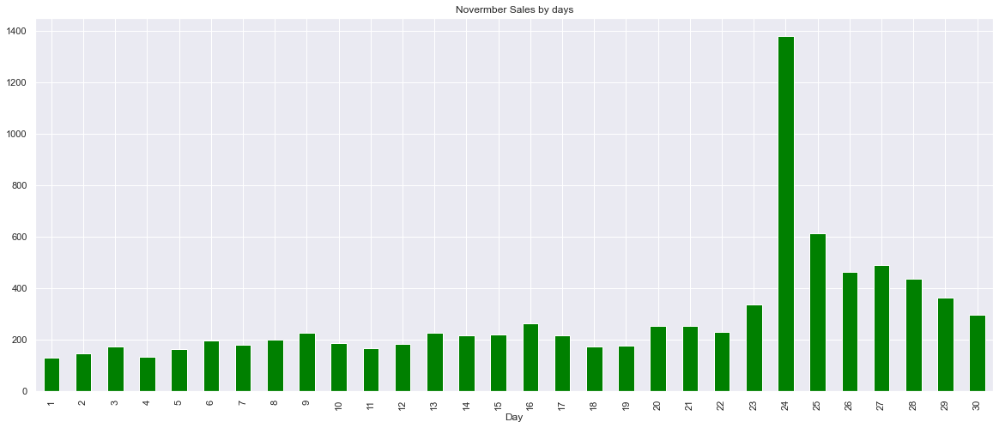

In [413]:
november.groupby('Day')['order_id'].count().plot(kind='bar', color='green')
plt.title('Novermber Sales by days')

In [458]:
november['product_category'].nunique()

64

In [464]:
november.groupby('product_category')['price'].sum().sort_values(ascending=False)

product_category
watches_gifts                              99424.16
bed_bath_table                             91970.91
health_beauty                              82669.70
computers_accessories                      75570.76
sports_leisure                             67043.64
toys                                       66154.06
furniture_decor                            65473.93
cool_stuff                                 57090.94
garden_tools                               47214.22
housewares                                 37612.98
auto                                       35481.39
perfumery                                  35203.13
telephony                                  27176.54
baby                                       22390.18
office_furniture                           18347.19
stationery                                 16660.09
musical_instruments                        16509.90
fashion_bags_accessories                   14266.46
agro_industry_and_commerce                 1393

In [463]:
november.groupby('product_category')['order_id'].count().sort_values(ascending=False)

product_category
bed_bath_table                             1023
furniture_decor                             820
sports_leisure                              629
health_beauty                               600
garden_tools                                573
computers_accessories                       551
toys                                        518
watches_gifts                               471
housewares                                  447
telephony                                   393
perfumery                                   346
cool_stuff                                  312
auto                                        268
fashion_bags_accessories                    220
baby                                        210
electronics                                 193
stationery                                  165
consoles_games                              143
pet_shop                                    105
office_furniture                            104
luggage_accessories    

In [466]:
#data[(data['Year_Month']=='201712')]

<AxesSubplot:xlabel='Day'>

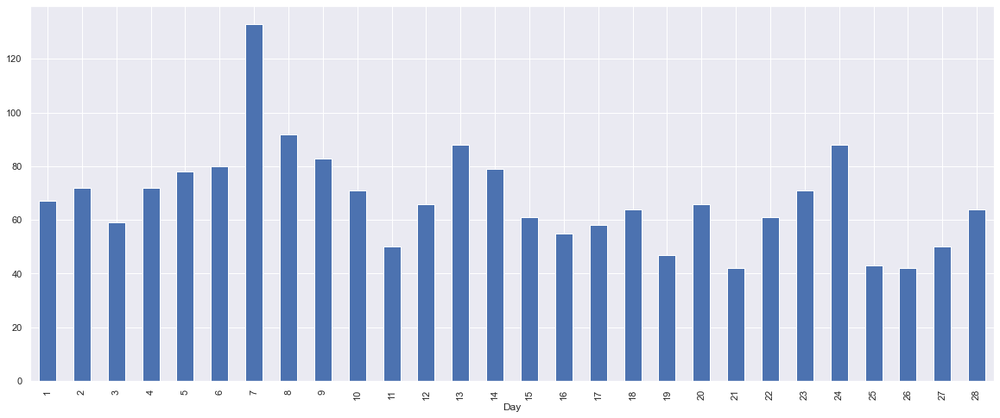

In [415]:
feb2017 = final_data[(final_data['purchased_Year']==2017) & (final_data['purchased_Month']=='February')]
feb2017.groupby('Day')['order_id'].count().plot(kind='bar')

Text(0.5, 1.0, 'Orders in February 2018')

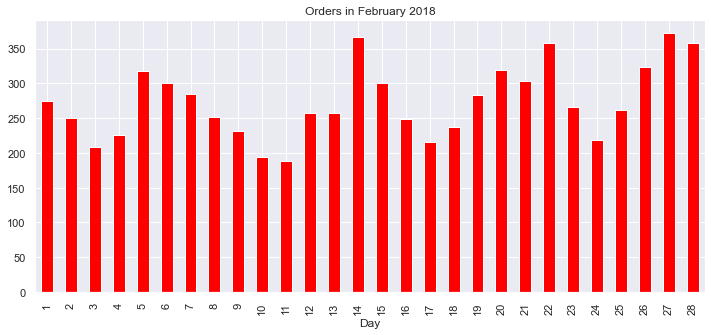

In [416]:
plt.figure(figsize=(12,5))
feb2018 = final_data[(final_data['purchased_Year']==2018) & (data['purchased_Month']=='February')]
feb2018.groupby('Day')['order_id'].count().plot(kind='bar', color='red')
plt.title('Orders in February 2018')

Text(0.5, 1.0, 'Orders in February 2018')

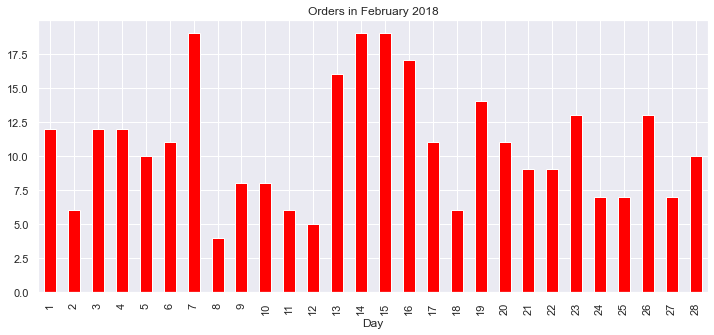

In [417]:
plt.figure(figsize=(12,5))
rio_feb_2018 = final_data[(final_data['purchased_Year']==2018) & (final_data['seller_state']=='RJ') & (data['purchased_Month']=='February')]
rio_feb_2018.groupby('Day')['order_id'].count().plot(kind='bar', color='red')
plt.title('Orders in February 2018')

Text(0, 0.5, 'Order Counts')

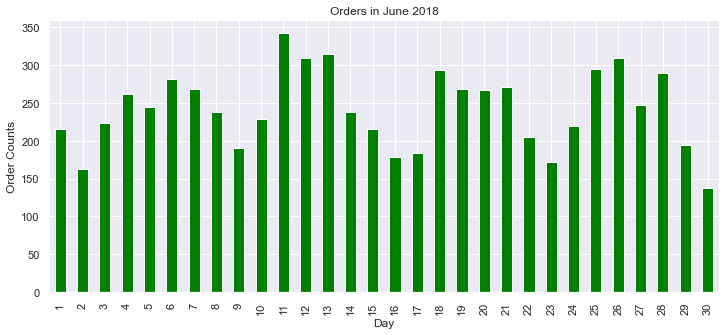

In [418]:
plt.figure(figsize=(12,5))
june2018 = final_data[(final_data['purchased_Year']==2018) & (data['purchased_Month']=='June')]
june2018.groupby('Day')['order_id'].count().plot(kind='bar', color='green')
plt.title('Orders in June 2018')
plt.ylabel('Order Counts')

Text(0.5, 1.0, 'Orders in May 2018')

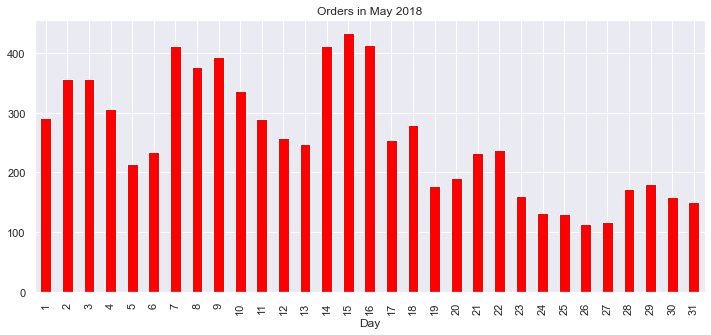

In [419]:
plt.figure(figsize=(12,5))
may2018 = final_data[(final_data['purchased_Year']==2018) &  (data['purchased_Month']=='May')]
may2018.groupby('Day')['order_id'].count().plot(kind='bar', color='red')
plt.title('Orders in May 2018') # to see mother's day difference


Text(0.5, 1.0, 'Orders in May 2018')

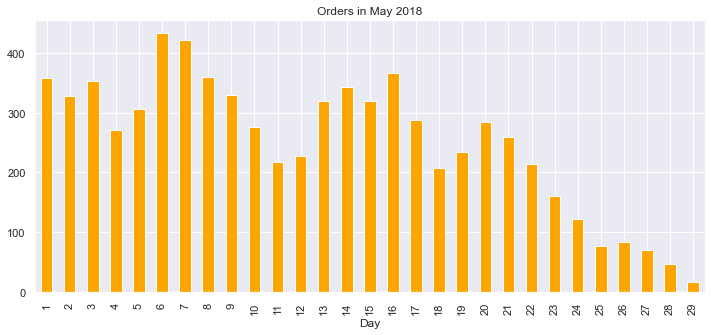

In [420]:
plt.figure(figsize=(12,5))
august2018 = final_data[(final_data['purchased_Year']==2018) &  (data['purchased_Month']=='August')]
august2018.groupby('Day')['order_id'].count().plot(kind='bar', color='orange')
plt.title('Orders in May 2018') # to see father's day difference


<AxesSubplot:xlabel='Day'>

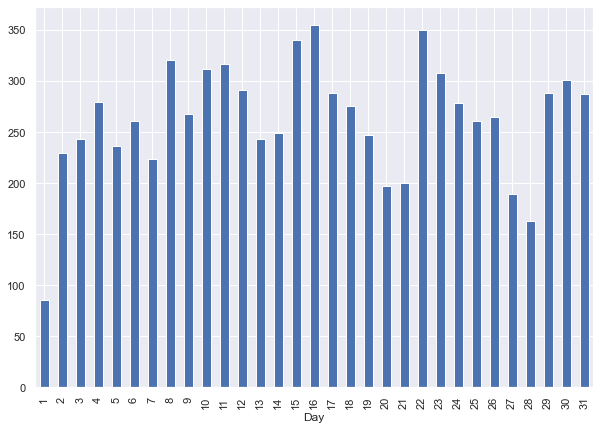

In [421]:
plt.figure(figsize=(10,7))
jan2018 = final_data[(final_data['Year_Month']=='201801') & (data['purchased_Month']=='January')]
jan2018.groupby('Day')['order_id'].count().plot(kind='bar')

<AxesSubplot:xlabel='Day'>

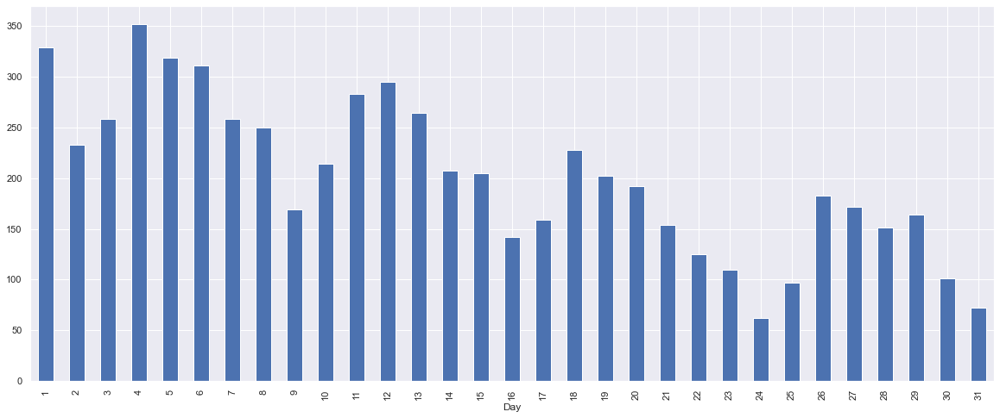

In [423]:
# Let' s look at the december 2017 
december2017 = final_data[(final_data['Year_Month']=='201712') & (data['purchased_Month']=='December')]
december2017.groupby('Day')['order_id'].count().plot(kind='bar')

In [424]:
final_data[(final_data['Year_Month']=='201712') & (final_data['purchased_Month']=='December') & (final_data['Day']==4)]['product_category'].unique()

array(['housewares', 'baby', 'cool_stuff', 'sports_leisure', 'toys',
       'furniture_decor', 'bed_bath_table', 'perfumery', 'health_beauty',
       'pet_shop', 'auto', 'watches_gifts', 'computers_accessories',
       'electronics', 'telephony', 'consoles_games', 'stationery',
       'party_supplies', 'fashion_male_clothing', 'food',
       'fashion_bags_accessories', 'garden_tools', 'office_furniture',
       'construction_tools_construction', 'market_place', 'home_confort',
       'art', 'fixed_telephony', 'musical_instruments',
       'luggage_accessories', 'home_appliances', 'small_appliances',
       'kitchen_dining_laundry_garden_furniture',
       'agro_industry_and_commerce', 'drinks', 'food_drink',
       'home_appliances_2', 'costruction_tools_garden', 'computers',
       'books_imported'], dtype=object)

In [426]:
final_data[(final_data['purchased_Year']==2017) & (final_data['purchased_Month']=='February') & (final_data['Day']==14)]['product_category'].nunique()

24

In [428]:
final_data[(final_data['Year_Month']=='201702') & (data['Day']>20)] # shrove tuesday

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_sequential,payment_type,payment_installments,payment_value,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,zip_code_prefix,seller_city,seller_state,product_category,review_id,review_score,purchased_Year,purchased_Month,purchased_Day,Day,Season,SeasonName,Year_Month,purchased_Hour,day_periods
628,153ba9c8183c2c6f39e8191d50cf0255,6d95fae30dcaee20608501a142ecf1a1,delivered,2017-02-28 21:38:21,2017-02-28 21:45:20,2017-03-01 06:15:59,2017-03-03 14:32:27,2017-03-21,1,credit_card,4,42.98,61fe29e2a95240e5a321e0e7aaccbcdf,1312,sao paulo,SP,1,9798f14fd2be3c482aaff824a05ac605,c8417879a15366a17c30af34c798c332,2017-03-07 21:45:20,29.90,13.08,4445,sao paulo,SP,housewares,f3159d3f84571b7def6064a2ddf8d780,5,2017,February,Tuesday,28,1,Summer,201702,21,Night
629,0a20452461e34d59bfd981e9e06fe988,bd2865d536f66e07f6b334425e30d027,delivered,2017-02-28 17:54:36,2017-02-28 19:19:47,2017-03-01 06:43:49,2017-03-10 07:04:35,2017-03-23,1,credit_card,4,49.74,88dd4a28d3887d6b56afd1fc9cee7bc3,22772,rio de janeiro,RJ,1,00929aaa7751a77220db9caa1ae6d3ab,c8417879a15366a17c30af34c798c332,2017-03-07 19:19:47,29.90,19.84,4445,sao paulo,SP,housewares,46725bae865a43c83b6a17c4f483613c,4,2017,February,Tuesday,28,1,Summer,201702,17,Evening
918,a0726e4fe3c5c989d0f89d5432c905b1,0899ee3a7b3e045cb930b5f394293736,delivered,2017-02-21 15:32:27,2017-02-21 15:42:29,2017-02-23 14:36:13,2017-03-01 05:59:03,2017-03-20,1,credit_card,1,58.86,035fe666eaf44eb44ec1967c30710ddb,4571,sao paulo,SP,1,5a17789f1d9b487c6f42da9212059dcf,0adac9fbd9a2b63cccaac4f8756c1ca8,2017-02-25 15:32:27,47.90,10.96,13290,louveira,SP,housewares,1d685288da2ae270a895e13beff3edba,2,2017,February,Tuesday,21,1,Summer,201702,15,Afternoon
951,4010af255873d6e26073000d24a8f52f,82c595ab5dcb46ee4c08bcef2ba09981,delivered,2017-02-23 16:39:13,2017-02-23 16:50:26,2017-02-24 15:24:52,2017-03-07 19:42:02,2017-03-20,1,credit_card,2,88.84,132acb0eb75c96160db9e064d80e42d6,88901,ararangua,SC,1,3c078c878d44c18bb8c02acc54ae25e5,0adac9fbd9a2b63cccaac4f8756c1ca8,2017-02-27 16:39:13,29.90,14.52,13290,louveira,SP,housewares,7c0f861002ca42073d7966b74125e686,4,2017,February,Thursday,23,1,Summer,201702,16,Evening
952,4010af255873d6e26073000d24a8f52f,82c595ab5dcb46ee4c08bcef2ba09981,delivered,2017-02-23 16:39:13,2017-02-23 16:50:26,2017-02-24 15:24:52,2017-03-07 19:42:02,2017-03-20,1,credit_card,2,88.84,132acb0eb75c96160db9e064d80e42d6,88901,ararangua,SC,2,3c078c878d44c18bb8c02acc54ae25e5,0adac9fbd9a2b63cccaac4f8756c1ca8,2017-02-27 16:39:13,29.90,14.52,13290,louveira,SP,housewares,7c0f861002ca42073d7966b74125e686,4,2017,February,Thursday,23,1,Summer,201702,16,Evening
1188,5ce15ec3d65174e3ebfd1d12ee096fb6,405835f2dd9f1e03e48f2531ac2018f0,delivered,2017-02-24 09:27:44,2017-02-24 09:42:55,2017-03-02 17:43:36,2017-03-14 11:47:29,2017-03-27,1,credit_card,3,70.52,c74f33f8921f86511371450f0655d4a9,13301,itu,SP,1,0124d1581f26143e988b8e1a4b7adab7,ca3bd7cd9f149df75950150d010fe4a2,2017-03-10 09:42:55,24.30,10.96,4361,sao paulo,SP,housewares,5a86eb2cc89faaed64c716ca5fed0b99,2,2017,February,Friday,24,1,Summer,201702,9,Morning
1189,5ce15ec3d65174e3ebfd1d12ee096fb6,405835f2dd9f1e03e48f2531ac2018f0,delivered,2017-02-24 09:27:44,2017-02-24 09:42:55,2017-03-02 17:43:36,2017-03-14 11:47:29,2017-03-27,1,credit_card,3,70.52,c74f33f8921f86511371450f0655d4a9,13301,itu,SP,2,0124d1581f26143e988b8e1a4b7adab7,ca3bd7cd9f149df75950150d010fe4a2,2017-03-10 09:42:55,24.30,10.96,4361,sao paulo,SP,housewares,5a86eb2cc89faaed64c716ca5fed0b99,2,2017,February,Friday,24,1,Summer,201702,9,Morning
3131,9719424249e7b0776d415cf169792da7,476c004348f7706c7b3fe723356e0713,delivered,2017-02-23 14:44:23,2017-02-23 14:55:24,2017-02-24 19:37:49,2017-03-08 16:47:54,2017-03-16,1,credit_card,3,32.72,76d752a5dfa418628f25

<AxesSubplot:xlabel='Day'>

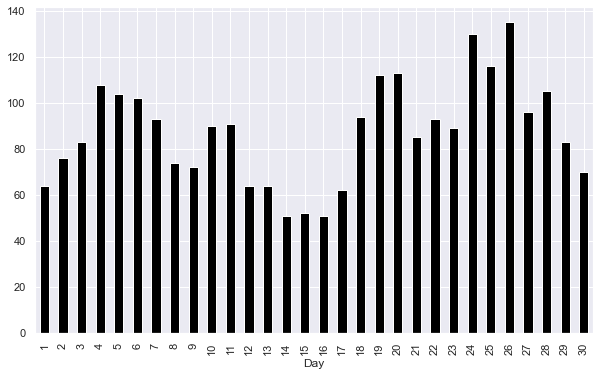

In [429]:
# I didn't find any insights
plt.figure(figsize=(10,6))
april2017 = final_data[(final_data['Year_Month']=='201704')] # Good Friday	Fri, Apr 14, 2017
april2017.groupby('Day')['order_id'].count().plot(kind='bar',color='black')

<AxesSubplot:xlabel='Day'>

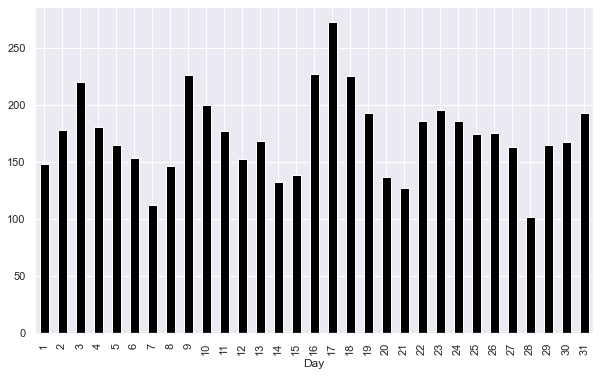

In [430]:
# I didnt't get any insights from the 17-10-2017
plt.figure(figsize=(10,6))
october2018 = final_data[(final_data['Year_Month']=='201710')] # teacher's day --> october 15
october2018.groupby('Day')['order_id'].count().plot(kind='bar',color='black')

<AxesSubplot:xlabel='Day'>

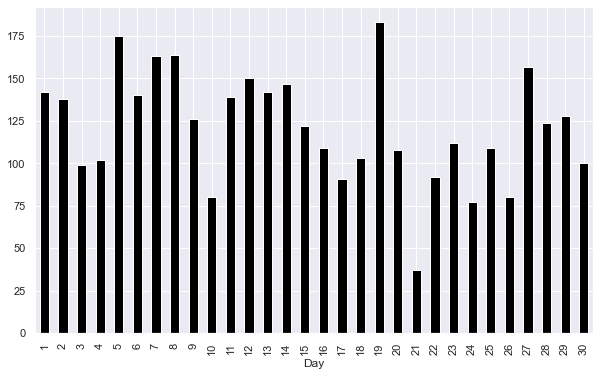

In [431]:
# I looked for Brazilian's valentine day,but didn'find any insight in 2017
plt.figure(figsize=(10,6))
june2017 = final_data[(final_data['Year_Month']=='201706')] #
june2017.groupby('Day')['order_id'].count().plot(kind='bar',color='black')

In [433]:
february = final_data[final_data['Year_Month']=='201702']
february.groupby('product_category')['price'].sum().sort_values(ascending=False)

product_category
health_beauty                              25292.72
furniture_decor                            20942.41
bed_bath_table                             17415.09
sports_leisure                             16465.90
cool_stuff                                 12839.57
auto                                       12339.58
garden_tools                               11871.51
housewares                                 11713.14
computers_accessories                      11289.09
watches_gifts                              11078.39
office_furniture                           11075.94
toys                                        9458.43
perfumery                                   8889.98
small_appliances                            7251.58
telephony                                   6815.33
consoles_games                              4294.77
pet_shop                                    3738.87
computers                                   3549.00
furniture_living_room                       347

In [434]:
february.groupby('product_category')['order_id'].count().sort_values(ascending=False)

product_category
furniture_decor                            271
bed_bath_table                             171
health_beauty                              170
sports_leisure                             160
telephony                                  109
computers_accessories                       99
auto                                        85
cool_stuff                                  73
garden_tools                                71
housewares                                  71
toys                                        67
office_furniture                            63
perfumery                                   53
pet_shop                                    41
fashion_bags_accessories                    38
watches_gifts                               35
baby                                        31
luggage_accessories                         28
small_appliances                            28
fixed_telephony                             23
furniture_living_room                      

In [435]:
garden_tool =final_data[((final_data['product_category']=='garden_tools')|(final_data['product_category']=='costruction_tools_garden')) & (final_data['purchased_Year']==2017)]
garden_tool.groupby('SeasonName')['order_id'].count().sort_values(ascending=False)

SeasonName
Spring    1126
Winter     567
Summer     463
Autumn     451
Name: order_id, dtype: int64

Text(0.5, 1.0, 'Garden Tools Sales by Season')

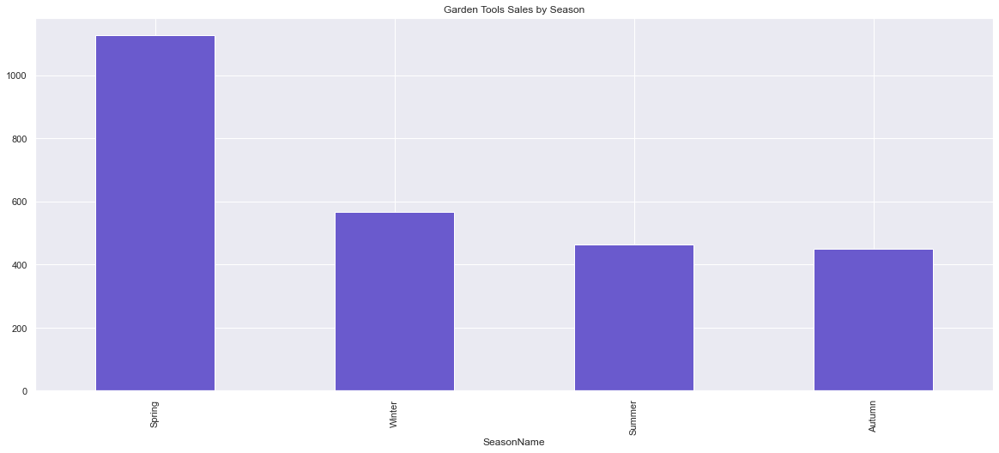

In [436]:
garden_tool.groupby('SeasonName')['order_id'].count().sort_values(ascending=False).plot(kind='bar', color='slateblue')
plt.title('Garden Tools Sales by Season')

In [437]:
health_beauty =final_data[(final_data['product_category']=='health_beauty') & (final_data['purchased_Year']==2017)]
health_beauty.groupby('SeasonName')['order_id'].count().sort_values(ascending=False)

SeasonName
Spring    1361
Winter     952
Summer     728
Autumn     691
Name: order_id, dtype: int64

In [438]:
sports_leisure =final_data[(final_data['product_category']=='sports_leisure') & (final_data['purchased_Year']==2017)]
sports_leisure.groupby('SeasonName')['order_id'].count().sort_values(ascending=False)

SeasonName
Spring    1565
Winter    1123
Summer     748
Autumn     726
Name: order_id, dtype: int64

In [439]:
toys =final_data[(final_data['product_category']=='toys') & (final_data['purchased_Year']==2017)]
toys.groupby('SeasonName')['order_id'].count().sort_values(ascending=False)

SeasonName
Spring    1110
Winter     556
Summer     546
Autumn     418
Name: order_id, dtype: int64

In [440]:
watches_gifts =final_data[(final_data['product_category']=='watches_gifts') & (final_data['purchased_Year']==2017)]
watches_gifts.groupby('SeasonName')['order_id'].count().sort_values(ascending=False)

SeasonName
Spring    1059
Winter     510
Summer     405
Autumn     319
Name: order_id, dtype: int64

Text(0.5, 1.0, ' Watch Sales by Season')

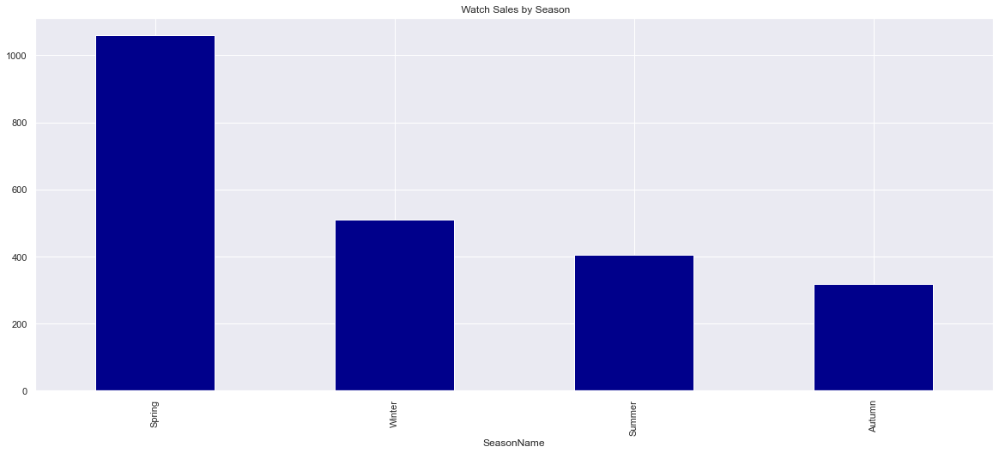

In [441]:
watches_gifts.groupby('SeasonName')['order_id'].count().sort_values(ascending=False).plot(kind='bar', color='darkblue')
plt.title(' Watch Sales by Season')

In [442]:
perfumery =final_data[(final_data['product_category']=='perfumery') & (final_data['purchased_Year']==2017)]
perfumery.groupby('SeasonName')['order_id'].count().sort_values(ascending=False)

SeasonName
Spring    708
Winter    426
Autumn    359
Summer    328
Name: order_id, dtype: int64

Text(0.5, 1.0, 'Perfume sales by season')

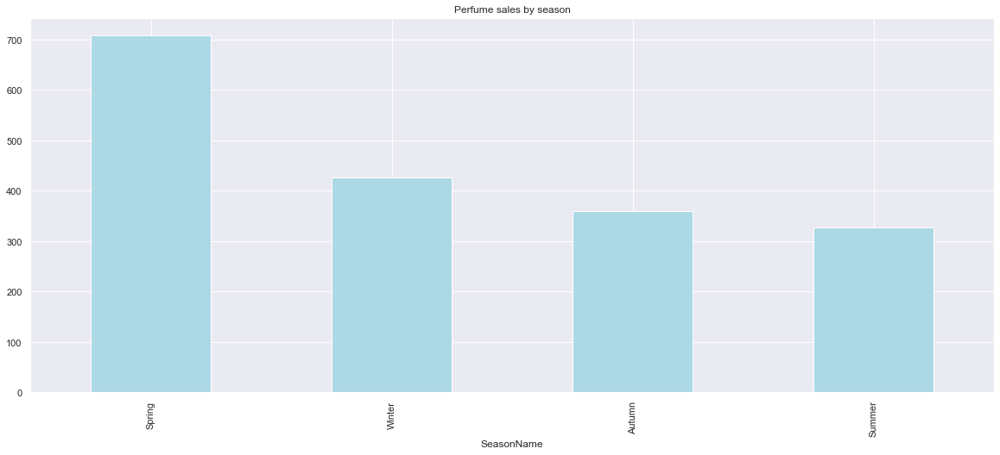

In [443]:
perfumery.groupby('SeasonName')['order_id'].count().sort_values(ascending=False).plot(kind='bar',color='lightblue')
plt.title('Perfume sales by season')

In [444]:
day_periods = final_data.groupby('day_periods').size().reset_index().sort_values(by=0,ascending=False)
day_periods["day_periods"] = day_periods["day_periods"].str.capitalize()
day_periods

,day_periods,0
0,Afternoon,29233
2,Evening,27962
5,Night,25340
4,Morning,23366
3,Late night,4951
1,Early morning,2358


In [445]:

Pivot= pd.pivot_table(final_data[final_data['purchased_Year']==2017], values='order_id', index=['product_category'],
                    columns=['SeasonName'], aggfunc='count', fill_value=0)
Pivot

SeasonName,Autumn,Spring,Summer,Winter
product_category,,,,
agro_industry_and_commerce,6,28,23,6
air_conditioning,40,39,18,31
art,13,8,4,13
arts_and_craftmanship,1,0,0,1
audio,43,80,25,25
auto,292,531,383,387
baby,204,517,213,342
bed_bath_table,1029,2177,794,1611
books_general_interest,56,64,52,60


In [446]:
garden_tools =final_data[((final_data['product_category']=='garden_tools')| (final_data['product_category']=='costruction_tools_garden')) & (final_data['purchased_Year']==2018)]
garden_tools.groupby('purchased_Month')['order_id'].count().sort_values(ascending=False)

purchased_Month
February     328
May          314
April        311
March        282
January      266
July         210
June         201
August       169
               0
September      0
October        0
November       0
December       0
Name: order_id, dtype: int64

In [447]:
garden_tools =final_data[((final_data['product_category']=='garden_tools')| (final_data['product_category']=='costruction_tools_garden')) & (final_data['purchased_Year']==2017)]
garden_tools.groupby('purchased_Month')['order_id'].count().sort_values(ascending=False)

purchased_Month
November     588
December     332
October      303
August       256
September    235
July         189
March        179
May          153
June         122
April        119
February      73
January       58
               0
Name: order_id, dtype: int64

## <span style='color:gray '> Categories and Their Average Delivery Time </span> 

In [448]:
(final_data['shipping_limit_date']- final_data['order_purchase_timestamp']).describe()

count                       113210
mean     6 days 14:34:40.087951594
std      5 days 11:05:24.862901740
min                2 days 00:06:06
25%                5 days 00:09:51
50%         6 days 00:17:00.500000
75%                7 days 03:54:33
max             1052 days 00:06:32
dtype: object

In [449]:
bed_bath_table = final_data[final_data["product_category"]=='bed_bath_table']
(bed_bath_table['order_estimated_delivery_date'] - bed_bath_table['order_delivered_customer_date']).describe()

count                         11685
mean     11 days 01:20:26.368078733
std       9 days 22:34:18.584190219
min             -127 days +07:18:04
25%                 6 days 08:37:28
50%                11 days 10:38:34
75%                16 days 00:47:58
max                64 days 04:22:11
dtype: object

In [450]:
health_beauty = final_data[final_data["product_category"]=='health_beauty']
(health_beauty['order_estimated_delivery_date'] - health_beauty['order_delivered_customer_date']).describe()

count                          9747
mean     11 days 07:31:47.154611675
std      10 days 01:12:26.385133478
min             -135 days +09:01:50
25%                 6 days 07:22:39
50%                12 days 01:31:34
75%         16 days 09:26:42.500000
max                57 days 19:58:22
dtype: object

In [451]:
sports_leisure = final_data[final_data["product_category"]=='sports_leisure']
(sports_leisure['order_estimated_delivery_date'] - sports_leisure['order_delivered_customer_date']).describe()

count                          8735
mean     11 days 09:00:24.809044075
std       9 days 15:02:31.744665432
min             -133 days +05:35:14
25%                 7 days 00:03:40
50%                12 days 02:45:03
75%                16 days 06:56:48
max                66 days 05:03:21
dtype: object

In [452]:
furniture_decor = final_data[final_data["product_category"]=='furniture_decor']
(furniture_decor['order_estimated_delivery_date'] - furniture_decor['order_delivered_customer_date']).describe()

count                          8558
mean     11 days 19:38:19.894484692
std      11 days 11:52:53.160084561
min             -168 days +06:59:53
25%                 6 days 17:34:01
50%                11 days 23:31:59
75%                16 days 08:15:44
max               146 days 00:23:13
dtype: object

In [453]:
computers_accessories = final_data[final_data["product_category"]=='computers_accessories']
(computers_accessories['order_estimated_delivery_date'] - computers_accessories['order_delivered_customer_date']).describe()

count                          7926
mean     11 days 19:34:42.877744133
std       9 days 23:31:07.128623290
min             -156 days +13:03:15
25%                 7 days 00:32:23
50%                12 days 07:51:42
75%         17 days 07:24:43.750000
max                51 days 09:24:00
dtype: object

In [454]:
housewares = data[data["product_category"]=='housewares']
(housewares['order_estimated_delivery_date'] - housewares['order_delivered_customer_date']).describe()

count                          7154
mean     11 days 15:33:52.449398937
std      10 days 08:02:04.511312789
min             -162 days +05:23:31
25%          7 days 02:07:23.500000
50%                12 days 03:22:32
75%         16 days 10:04:53.750000
max               123 days 10:24:06
dtype: object

In [455]:
#data.groupby(['product_category','payment_sequential'])['product_category'].count()

## <font color='gray'> Libraries Like Sweetviz, pandas profiling </font> 

In [37]:
pip install sweetviz 

Note: you may need to restart the kernel to use updated packages.


In [457]:
import sweetviz as sv
analyze_report = sv.analyze(final_data)
analyze_report.show_html('analyze.html', open_browser=False) 

                                             |                                             | [  0%]   00:00 ->…

Report analyze.html was generated.



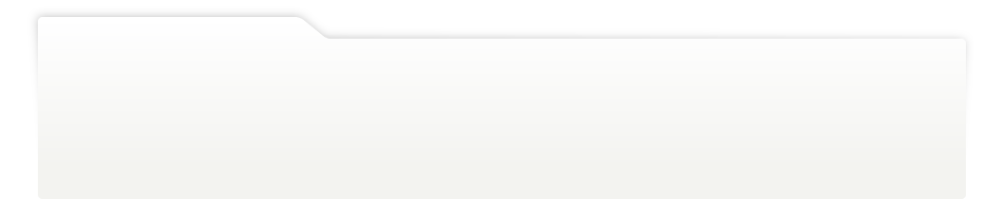
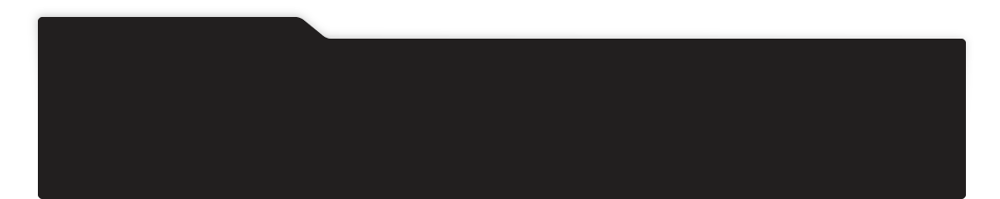
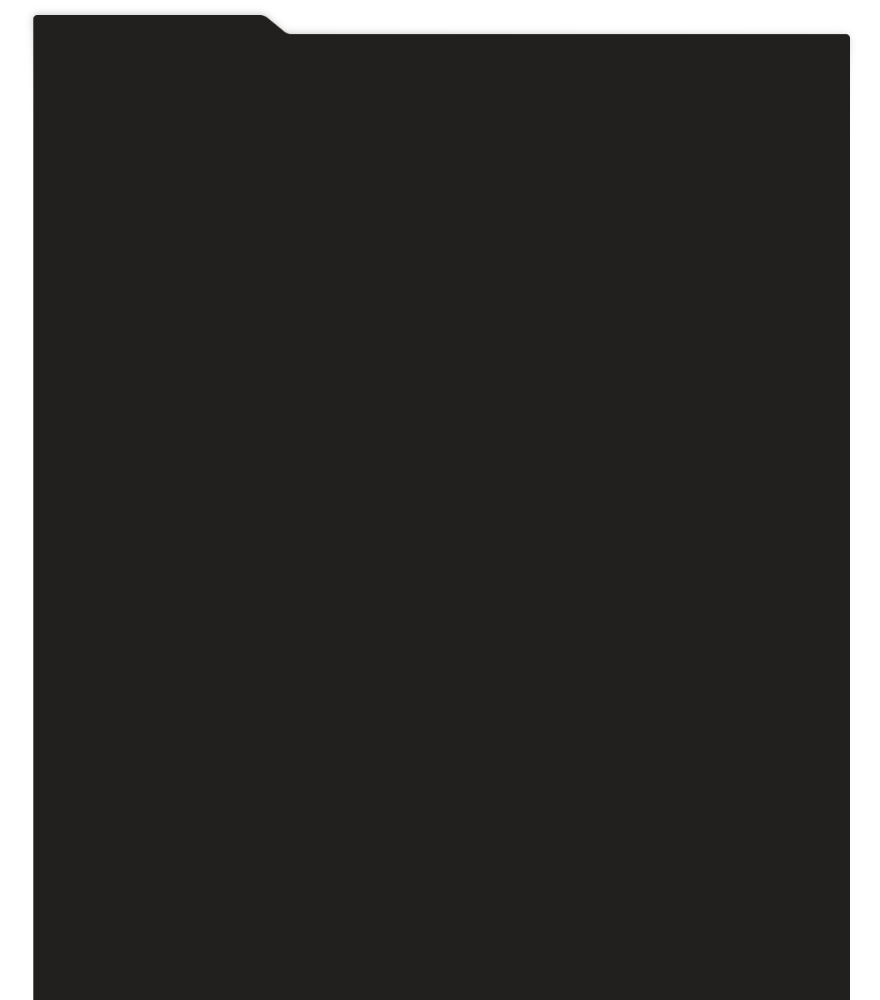
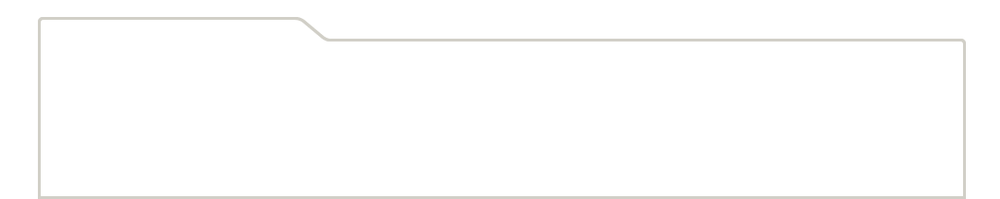
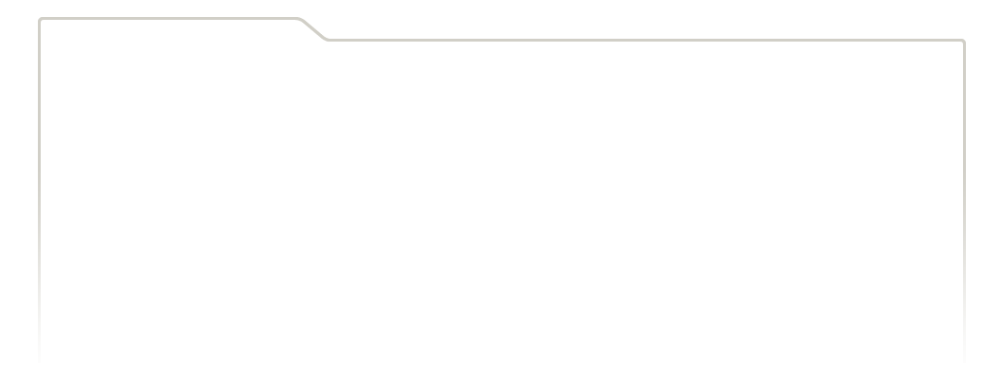
...
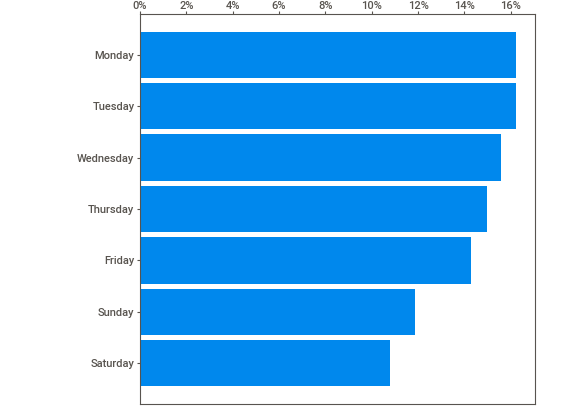
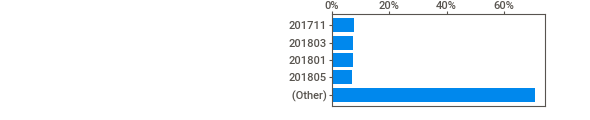
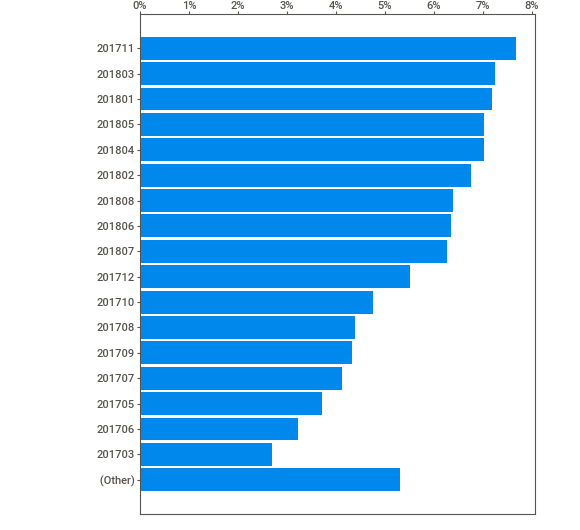
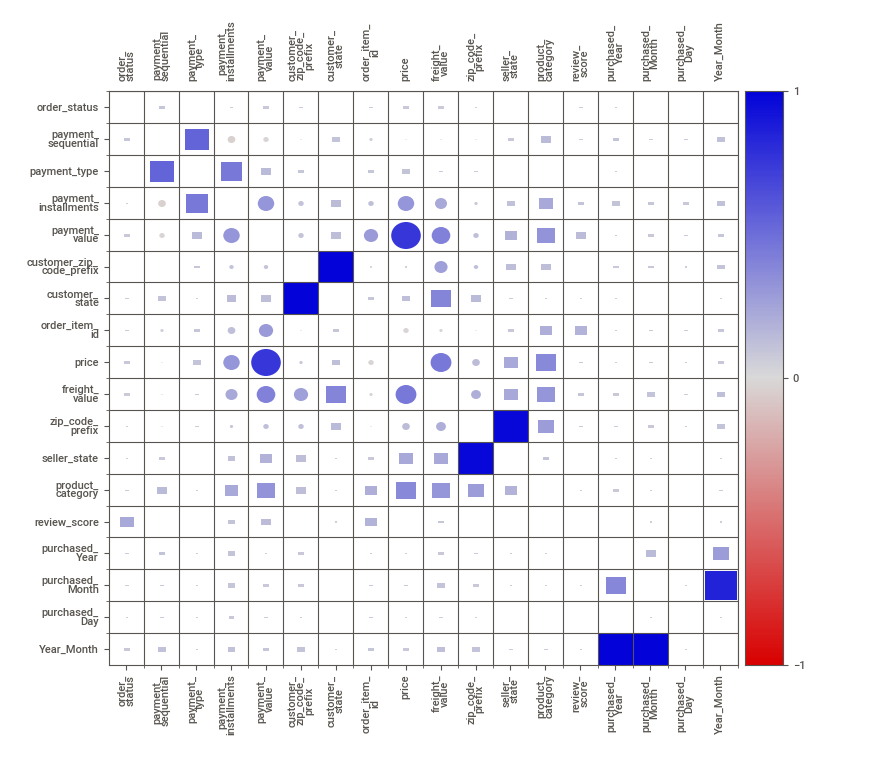
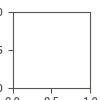

In [49]:
import  IPython
IPython.display.HTML('analyze.html')

In [50]:
from autoviz.AutoViz_Class import AutoViz_Class 

AV = AutoViz_Class() # object cretaed

In [204]:
pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip 

  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
Note: you may need to restart the kernel to use updated packages.


In [205]:
pip install pandas-profiling[notebook,html]

Note: you may need to restart the kernel to use updated packages.


In [458]:
import pandas_profiling as pp
from pandas_profiling import ProfileReport

In [50]:
pp.ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## <span style='color:gray '>Some Visualizations </span> 

In [160]:

sellers_x_date['Year_Month'] = sellers_x_date['order_purchase_timestamp'].dt.strftime('%Y%m')
#clients_x_date['Year_Month'].sort_values() # values from september 2016 to september 2018

In [459]:
final_data['customer_unique_id'].describe()

count                               113210
unique                               91481
top       9a736b248f67d166d2fbb006bcb877c3
freq                                    75
Name: customer_unique_id, dtype: object

In [460]:
final_data[final_data['purchased_Year']==2017]['customer_unique_id'].describe()

count                                51201
unique                               41109
top       9a736b248f67d166d2fbb006bcb877c3
freq                                    75
Name: customer_unique_id, dtype: object

In [461]:
final_data[final_data['purchased_Year']==2018]['customer_unique_id'].describe()

count                                61680
unique                               50738
top       5419a7c9b86a43d8140e2939cd2c2f7e
freq                                    24
Name: customer_unique_id, dtype: object

## <font color='gray'> Visualizations </font> 

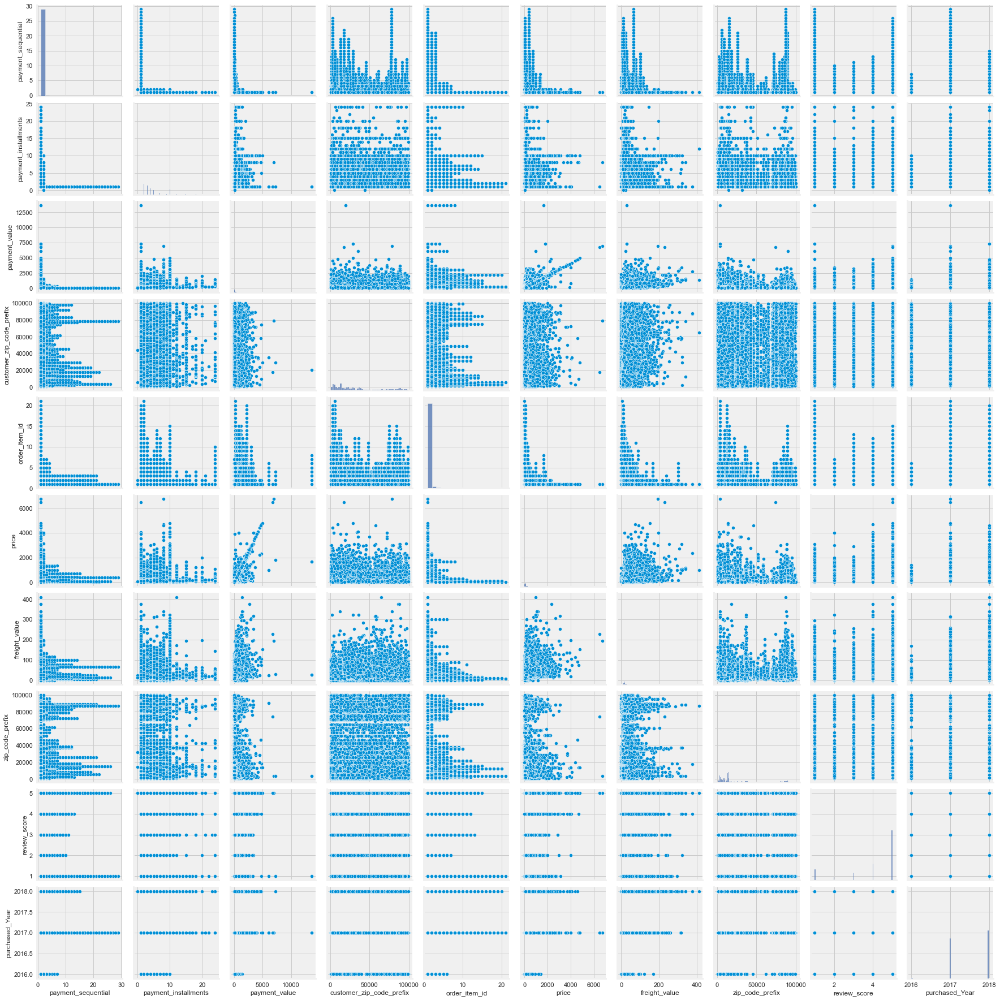

In [57]:
sns.pairplot(data)

In [462]:
# Correlations 
corr = final_data.corr()
corr

,payment_sequential,payment_installments,payment_value,customer_zip_code_prefix,order_item_id,price,freight_value,zip_code_prefix,review_score,purchased_Year,Day,Season,purchased_Hour
payment_sequential,1.000000,-0.087989,-0.065723,-0.029430,-0.000318,-0.000093,0.007141,0.004509,0.005469,-0.044716,-0.016130,0.008275,0.010401
payment_installments,-0.087989,1.000000,0.274610,0.057358,0.075172,0.279847,0.186209,0.039060,-0.043310,-0.051064,0.003837,0.033911,0.013498
payment_value,-0.065723,0.274610,1.000000,0.051288,0.257580,0.738738,0.372802,0.071037,-0.081260,0.006835,-0.001459,0.017161,-0.003901
customer_zip_code_prefix,-0.029430,0.057358,0.051288,1.000000,-0.003703,0.041976,0.225656,0.074880,-0.026982,-0.033927,-0.008852,0.002030,0.014730
order_item_id,-0.000318,0.075172,0.257580,-0.003703,1.000000,-0.061130,-0.030095,-0.018329,-0.136075,0.005413,0.016279,0.005710,-0.011592
price,-0.000093,0.279847,0.738738,0.041976,-0.061130,1.000000,0.412721,0.089175,0.003286,-0.000490,-0.010816,0.006697,0.007892
freight_value,0.007141,0.186209,0.372802,0.225656,-0.030095,0.412721,1.000000,0.150841,-0.033662,0.036479,-0.016400,0.027189,0.006060
zip_code_prefix,0.004509,0.039060,0.071037,0.074880,-0.018329,0.089175,0.150841,1.000000,0.026787,-0.011021,-0.001599,-0.009817,-0.005508
review_score,0.005469,-0.043310,-0.081260,-0.026982,-0.136075,0.003286,-0.033662,0.026787,1.000000,-0.015944,0.000238,0.040760,0.011218
purchased_Year,-0.044716,-0.051064,0.006835,-0.033927,0.005413,-0.000490,0.036479,-0.011021,-0.015944,1.000000,-0.044751,-0.366022,-0.008048


<AxesSubplot:>

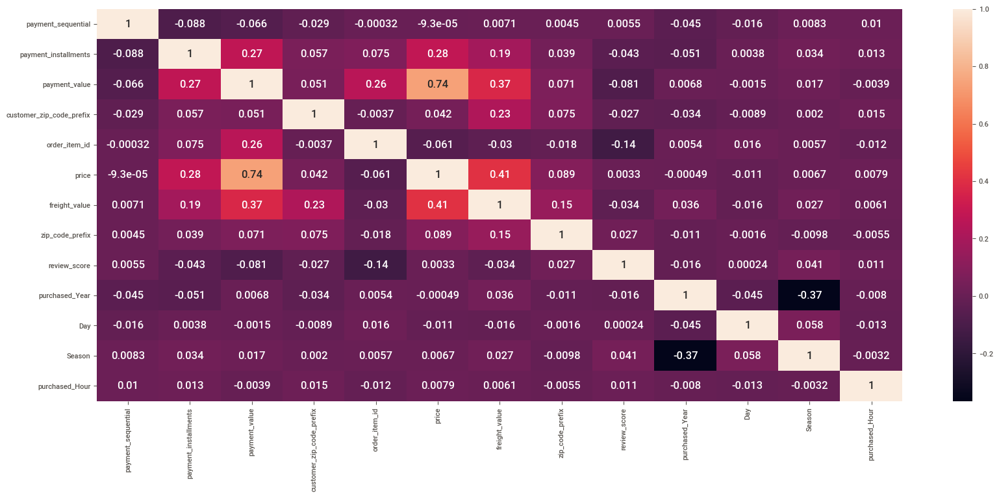

In [479]:
# here it is seen that payment value and prices are correlated, I used price values in my visualizations
# I dropped the payment value
sns.heatmap(corr, annot=True)

In [398]:
#Category Performance

In [463]:
customer_state = final_data.groupby(['customer_state'])['price','order_id','customer_unique_id']\
.agg({'price':'sum','order_id':'nunique','customer_unique_id':'nunique'}).reset_index()

category = final_data.groupby(['product_category'])['price','order_id','customer_unique_id']\
.agg({'price':'sum','order_id':'nunique','customer_unique_id':'nunique'}).reset_index()

yearmonth = final_data.groupby(['Year_Month'])['price','order_id','customer_unique_id']\
.agg({'price':'sum','order_id':'nunique','customer_unique_id':'nunique'}).reset_index()
seller_state = final_data.groupby(['seller_state'])['price','order_id','customer_unique_id']\
.agg({'price':'sum','order_id':'nunique','customer_unique_id':'nunique'}).reset_index()

In [464]:
customer_state.head()

,customer_state,price,order_id,customer_unique_id
0,AC,16940.56,78,74
1,AL,79833.46,390,380
2,AM,22052.47,143,139
3,AP,13508.91,66,65
4,BA,511455.97,3188,3094


In [465]:
seller_state.head()

,seller_state,price,order_id,customer_unique_id
0,AM,1177.00,3,3
1,BA,311595.64,548,540
2,CE,19898.56,87,84
3,DF,101971.21,798,791
4,ES,46754.86,300,299


In [466]:
yearmonth

,Year_Month,price,order_id,customer_unique_id
0,201610,41043.73,260,257
1,201612,10.90,1,1
2,201701,118525.81,731,700
3,201702,236110.95,1593,1573
4,201703,370039.64,2478,2443
5,201704,349595.61,2228,2200
6,201705,516270.99,3438,3375
7,201706,437773.82,3060,3001
8,201707,510081.68,3795,3727
9,201708,572738.71,4102,4028


In [467]:
category.head()

,product_category,price,order_id,customer_unique_id
0,agro_industry_and_commerce,81877.58,177,176
1,air_conditioning,53566.08,242,240
2,art,24011.73,193,193
3,arts_and_craftmanship,1814.01,23,21
4,audio,52102.68,345,344


In [468]:
category['contribution'] = category['price']/category['price'].sum()
# above I created category data, in the data price column is available
# if I divide price column to total price, we will see for price contribution for each product category
category.head()

,product_category,price,order_id,customer_unique_id,contribution
0,agro_industry_and_commerce,81877.58,177,176,0.006034
1,air_conditioning,53566.08,242,240,0.003947
2,art,24011.73,193,193,0.001769
3,arts_and_craftmanship,1814.01,23,21,0.000134
4,audio,52102.68,345,344,0.003840


In [469]:
category['category'] = category.apply(lambda x: x['product_category'] if x['contribution']>=0.0350 else 'Many_kinds_of_category',axis=1)

category_contribution = category.groupby('category')['price','order_id','customer_unique_id'].sum().reset_index()

In [470]:
category_contribution

,category,price,order_id,customer_unique_id
0,Many_kinds_of_category,4510536.59,31511,31155
1,auto,594994.54,3792,3752
2,bed_bath_table,1082024.32,9177,8918
3,computers_accessories,922593.78,6499,6376
4,cool_stuff,628528.54,3531,3515
5,furniture_decor,746811.14,6260,6133
6,garden_tools,490451.78,3428,3400
7,health_beauty,1266992.59,8600,8453
8,housewares,646232.97,5709,5648
9,sports_leisure,989781.66,7486,7299


Text(0.5, 1.0, 'Customer count for each category')

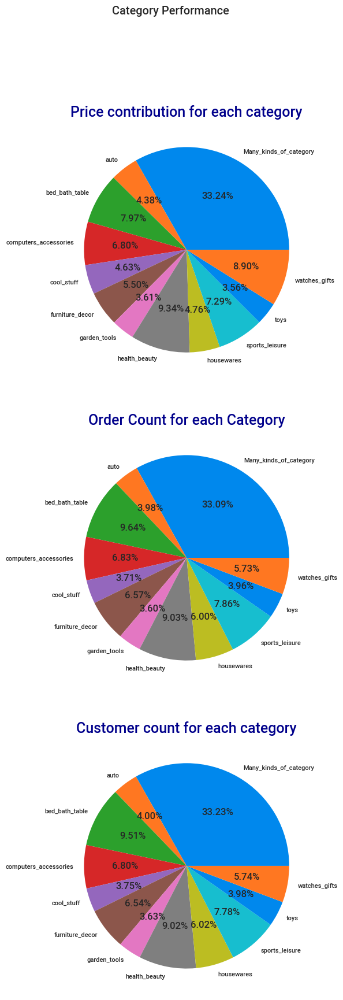

In [471]:
sns.set_style()
fig, (ax1,ax2,ax3) = plt.subplots(3,figsize=(20,20))
fig.suptitle('Category Performance ')
x = category_contribution['category']
ax1.pie(category_contribution['price'],labels=x,autopct='%1.2f%%')
ax1.set_title('Price contribution for each category', size=18, color='darkblue')
ax2.pie(category_contribution['order_id'],labels=x,autopct='%1.2f%%')
ax2.set_title('Order Count for each Category', size=18, color='darkblue')
ax3.pie(category_contribution['customer_unique_id'],labels=x,autopct='%1.2f%%')
ax3.set_title('Customer count for each category', size=18, color='darkblue')


In [394]:
product = final_data.groupby('product_category')['price'].sum().sort_values(ascending=False)[:10]
product

product_category
health_beauty            1266992.59
watches_gifts            1207633.40
bed_bath_table           1082024.32
sports_leisure            989781.66
computers_accessories     922593.78
furniture_decor           746811.14
housewares                646232.97
cool_stuff                628528.54
auto                      594994.54
garden_tools              490451.78
Name: price, dtype: float64

<Figure size 2500x1000 with 0 Axes>

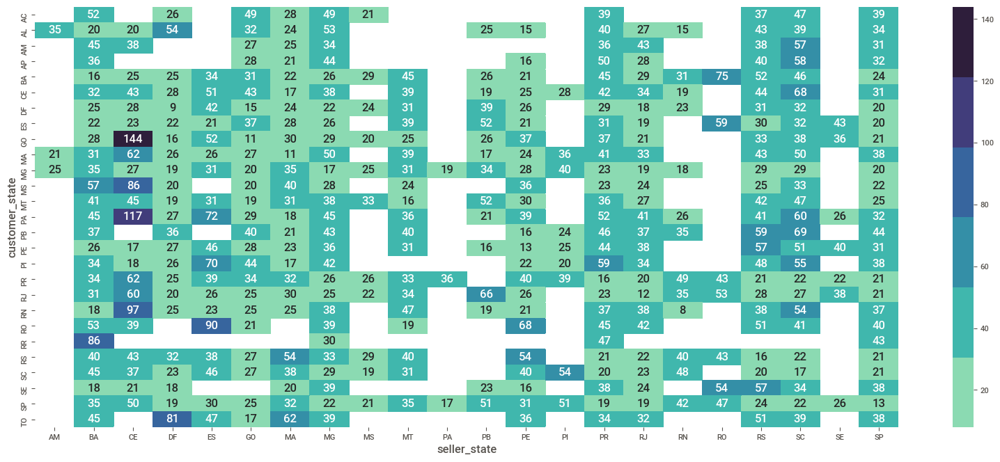

<Figure size 2500x1000 with 0 Axes>

In [493]:
palette = sns.color_palette("mako_r", 6)
seller_freight=pd.crosstab(index=final_data['customer_state'], columns=final_data['seller_state'], values=final_data['freight_value'],  aggfunc=np.mean).round(0)
sns.heatmap(seller_freight, cmap=palette, annot=True, fmt='g');
plt.figure(figsize=(25,10))

In [472]:
final_data.drop(['payment_value'], axis = 1, inplace = True)

In [495]:
#sns.catplot(x="day_periods", y="price",
 #                data=final_data)               

In [496]:
#telephony = final_data[final_data['product_category']=='telephony']
#sns.relplot(
#    data=telephony, x="price", y="freight_value",
#    col="purchased_Month", hue='purchased_Day',
#    kind="scatter"
#)

In [497]:
#sns.relplot(
#    data=telephony, x="price", y="freight_value",
#    col="product_category", hue='purchased_Year',
#    kind="scatter"
#)

In [498]:
#sns.relplot(
#    data=final_data, x="price", y="freight_value",
#    col="product_category", hue='purchased_Year',
#    kind="scatter"
#)

##### <font color='gray'> REFERENCES </font> 
* https://www.kaggle.com/olistbr/brazilian-ecommerce
* https://www.kaggle.com/luisenrique18/olist-ecommerce-2017-2018-eda - I used two graphs from here

# <font color='gray'> Thank you </font> 
### <font color='gray'> Gözde Gözütok </font> 